<a href="https://colab.research.google.com/github/sailorcosmos101/3D-PINN-for-GW/blob/main/3DPINNforGW_case1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import sys
import numpy as np
import jax
import jax.numpy as jnp
from jax import random, jit, grad, vmap, jacfwd, jacrev
import optax
import matplotlib.pyplot as plt
from IPython.display import display, clear_output
from matplotlib import cm
import matplotlib as mpl
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error
from mpl_toolkits.mplot3d import Axes3D
import pickle

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
# Define the 3D domain
xmin, xmax = 0.0, 22900  # X-boundary
ymin, ymax = 0.0, 22900  # Y-boundary
zmin, zmax = -137.16, 60.96  # Z-boundary

In [23]:
N_b = 2000  # Increase number of boundary points per boundary condition points
N_r = 50000  # Increase number of collocation points within the domain

# Define the boundary conditons
h_const = 0 # Constant head boundary condition
f_no = 0 # No-flow boundary condition
W_re = 7.9*10**-5 # Recharge rate (m/d)

In [5]:
# Define hydraulic conductivity function
def hydraulic_conductivity(x, y, z):
    """
    Define piecewise hydraulic conductivity K.
    """
    K_x =  jnp.ones_like(x) * 15
    K_y =  jnp.ones_like(y) * 15
    K_z =  jnp.ones_like(z) * 1.5
    return K_x, K_y, K_z

In [6]:
def drain_elev(x, e_max = 100, L=12192, x_shift = 2286):
    return (e_max / L) * (x - x_shift)

In [7]:
def drain_discharge(h_pred, x_drain, C_d = 0.09):
    d_x = drain_elev(x_drain)
    return jnp.where(h_pred < d_x, 0.0, -C_d * (h_pred - d_x))

In [24]:
def generate_BCs_and_colloc(N_b, N_r, xmin, xmax, ymin, ymax, zmin, zmax):
    bk1, bk2, bk3, bk4, bk5, bk6, r1k, r2k, r3k = jax.random.split(jax.random.PRNGKey(0), 9)

    # 1 --- Constant Head Boundary 생성 ---
    y_linspace_const = jnp.linspace(ymin, ymax, int(jnp.sqrt(N_b)))
    z_linspace_const = jnp.linspace(-91.44, zmax, int(jnp.sqrt(N_b)))  # (-91.44, 60.96)
    Y_mesh_const, Z_mesh_const = jnp.meshgrid(y_linspace_const, z_linspace_const)
    y_const = Y_mesh_const.ravel().reshape(-1, 1)
    z_const = Z_mesh_const.ravel().reshape(-1, 1)
    x_const = jnp.full_like(y_const, xmin)  # x = 0
    bc_const = jnp.ones_like(y_const) * h_const
    BC_const = jnp.concatenate([x_const, y_const, z_const, bc_const], axis=1)

    # 2 --- Recharge Boundary 생성 ---
    x_linspace_re = jnp.linspace(xmin, xmax, int(jnp.sqrt(N_b)))
    y_linspace_re = jnp.linspace(ymin, ymax, int(jnp.sqrt(N_b)))
    X_mesh_re, Y_mesh_re = jnp.meshgrid(x_linspace_re, y_linspace_re)
    x_re = X_mesh_re.ravel().reshape(-1, 1)
    y_re = Y_mesh_re.ravel().reshape(-1, 1)
    z_re = jnp.full_like(x_re, zmax)  # z = 60.96
    bc_re = jnp.ones_like(x_re) * W_re
    BC_re = jnp.concatenate([x_re, y_re, z_re, bc_re], axis=1)

    # 3 --- Drainage Boundary (y=11430, z=60.96) 생성 ---
    x_linspace_dr = jnp.linspace(2286, 14478, int(jnp.sqrt(N_b)))
    y_linspace_dr = jnp.array([11430.0])  # 고정된 y
    X_mesh_dr, _ = jnp.meshgrid(x_linspace_dr, y_linspace_dr)
    x_dr = X_mesh_dr.ravel().reshape(-1, 1)
    y_dr = jnp.full_like(x_dr, 11430.0)
    z_dr = jnp.full_like(x_dr, zmax)  # z = 60.96
    q_dr = jnp.zeros_like(x_dr) # Drainage는 bc 값을 h(x,y,z) 기반으로 계산해야 하므로, 초기 bc는 일단 dummy 값으로
    BC_dr = jnp.concatenate([x_dr, y_dr, z_dr, q_dr], axis=1)

    # 4 --- No-flow Boundary at x=xmin, z <= -91.44 ---
    y_linspace_nf_xmin = jnp.linspace(ymin, ymax, int(jnp.sqrt(N_b)))
    z_linspace_nf_xmin = jnp.linspace(-137.16, -91.44, int(jnp.sqrt(N_b)))  # 하부 구간 (-137.16 ~ -91.44)
    Y_mesh_nf_xmin, Z_mesh_nf_xmin = jnp.meshgrid(y_linspace_nf_xmin, z_linspace_nf_xmin)
    y_nf_xmin = Y_mesh_nf_xmin.ravel().reshape(-1, 1)
    z_nf_xmin = Z_mesh_nf_xmin.ravel().reshape(-1, 1)
    x_nf_xmin = jnp.full_like(y_nf_xmin, xmin)  # x=0 (xmin)
    bc_nf_xmin = jnp.ones_like(y_nf_xmin) * f_no  # dh/dx = 0
    BC_nf_xmin = jnp.concatenate([x_nf_xmin, y_nf_xmin, z_nf_xmin, bc_nf_xmin], axis=1)

    # 5 --- No-flow Boundary (x=xmax) 생성 ---
    y_linspace_nf_xmax = jnp.linspace(ymin, ymax, int(jnp.sqrt(N_b)))
    z_linspace_nf_xmax = jnp.linspace(zmin, zmax, int(jnp.sqrt(N_b)))
    Y_mesh_nf_xmax, Z_mesh_nf_xmax = jnp.meshgrid(y_linspace_nf_xmax, z_linspace_nf_xmax)
    y_nf_xmax = Y_mesh_nf_xmax.ravel().reshape(-1, 1)
    z_nf_xmax = Z_mesh_nf_xmax.ravel().reshape(-1, 1)
    x_nf_xmax = jnp.full_like(y_nf_xmax, xmax)  # x = xmax
    bc_nf_xmax = jnp.ones_like(y_nf_xmax) * f_no  # dh/dx = 0
    BC_nf_xmax = jnp.concatenate([x_nf_xmax, y_nf_xmax, z_nf_xmax, bc_nf_xmax], axis=1)

    # 6 --- No-flow Boundary (y=ymin) 생성 ---
    x_linspace_nf_ymin = jnp.linspace(xmin, xmax, int(jnp.sqrt(N_b)))
    z_linspace_nf_ymin = jnp.linspace(zmin, zmax, int(jnp.sqrt(N_b)))
    X_mesh_nf_ymin, Z_mesh_nf_ymin = jnp.meshgrid(x_linspace_nf_ymin, z_linspace_nf_ymin)
    x_nf_ymin = X_mesh_nf_ymin.ravel().reshape(-1, 1)
    z_nf_ymin = Z_mesh_nf_ymin.ravel().reshape(-1, 1)
    y_nf_ymin = jnp.full_like(x_nf_ymin, ymin)  # y = ymin
    bc_nf_ymin = jnp.ones_like(x_nf_ymin) * f_no  # dh/dy = 0
    BC_nf_ymin = jnp.concatenate([x_nf_ymin, y_nf_ymin, z_nf_ymin, bc_nf_ymin], axis=1)

    # 7 --- No-flow Boundary (y=ymax) 생성 ---
    x_linspace_nf_ymax = jnp.linspace(xmin, xmax, int(jnp.sqrt(N_b)))
    z_linspace_nf_ymax = jnp.linspace(zmin, zmax, int(jnp.sqrt(N_b)))
    X_mesh_nf_ymax, Z_mesh_nf_ymax = jnp.meshgrid(x_linspace_nf_ymax, z_linspace_nf_ymax)
    x_nf_ymax = X_mesh_nf_ymax.ravel().reshape(-1, 1)
    z_nf_ymax = Z_mesh_nf_ymax.ravel().reshape(-1, 1)
    y_nf_ymax = jnp.full_like(x_nf_ymax, ymax)  # y = ymax
    bc_nf_ymax = jnp.ones_like(x_nf_ymax) * f_no  # dh/dy = 0
    BC_nf_ymax = jnp.concatenate([x_nf_ymax, y_nf_ymax, z_nf_ymax, bc_nf_ymax], axis=1)

    # 8 --- No-flow Boundary (z=zmin) 생성 ---
    x_linspace_nf_zmin = jnp.linspace(xmin, xmax, int(jnp.sqrt(N_b)))
    y_linspace_nf_zmin = jnp.linspace(ymin, ymax, int(jnp.sqrt(N_b)))
    X_mesh_nf_zmin, Y_mesh_nf_zmin = jnp.meshgrid(x_linspace_nf_zmin, y_linspace_nf_zmin)
    x_nf_zmin = X_mesh_nf_zmin.ravel().reshape(-1, 1)
    y_nf_zmin = Y_mesh_nf_zmin.ravel().reshape(-1, 1)
    z_nf_zmin = jnp.full_like(x_nf_zmin, zmin)  # z = zmin
    bc_nf_zmin = jnp.ones_like(x_nf_zmin) * f_no  # dh/dz = 0
    BC_nf_zmin = jnp.concatenate([x_nf_zmin, y_nf_zmin, z_nf_zmin, bc_nf_zmin], axis=1)

    # Collocation points 생성
    rkey1, rkey2, rkey3 = jax.random.split(jax.random.PRNGKey(42), 3)
    x_c = jax.random.uniform(rkey1, minval=xmin, maxval=xmax, shape=(N_r, 1))
    y_c = jax.random.uniform(rkey2, minval=ymin, maxval=ymax, shape=(N_r, 1))
    z_c = jax.random.uniform(rkey3, minval=zmin, maxval=zmax, shape=(N_r, 1))
    colloc = jnp.concatenate([x_c, y_c, z_c], axis=1)

    # BC 묶기
    conds = [
    BC_const,    # 0: Constant Head Boundary
    BC_re,       # 1: Recharge
    BC_dr,       # 2: Drain
    BC_nf_xmin,  # 3: No-flow at x=xmin
    BC_nf_xmax,  # 4: No-flow at x=xmax
    BC_nf_ymin,  # 5: No-flow at y=ymin
    BC_nf_ymax,  # 6: No-flow at y=ymax
    BC_nf_zmin   # 7: No-flow at z=zmin
    ]

    return (
    x_const, y_const, z_const, bc_const, BC_const,
    x_re, y_re, z_re,bc_re, BC_re,
    x_dr, y_dr, z_dr, q_dr, BC_dr,
    x_nf_xmin, y_nf_xmin, z_nf_xmin, bc_nf_xmin, BC_nf_xmin,
    x_nf_xmax, y_nf_xmax, z_nf_xmax, bc_nf_xmax, BC_nf_xmax,
    x_nf_ymin, y_nf_ymin, z_nf_ymin, bc_nf_ymin, BC_nf_ymin,
    x_nf_ymax, y_nf_ymax, z_nf_ymax, bc_nf_ymax, BC_nf_ymax,
    x_nf_zmin, y_nf_zmin, z_nf_zmin, bc_nf_zmin, BC_nf_zmin,
    x_c, y_c, z_c, colloc, conds
)

(x_const, y_const, z_const, bc_const, BC_const,
    x_re, y_re, z_re,bc_re, BC_re,
    x_dr, y_dr, z_dr, q_dr, BC_dr,
    x_nf_xmin, y_nf_xmin, z_nf_xmin, bc_nf_xmin, BC_nf_xmin,
    x_nf_xmax, y_nf_xmax, z_nf_xmax, bc_nf_xmax, BC_nf_xmax,
    x_nf_ymin, y_nf_ymin, z_nf_ymin, bc_nf_ymin, BC_nf_ymin,
    x_nf_ymax, y_nf_ymax, z_nf_ymax, bc_nf_ymax, BC_nf_ymax,
    x_nf_zmin, y_nf_zmin, z_nf_zmin, bc_nf_zmin, BC_nf_zmin,
    x_c, y_c, z_c, colloc, conds) = generate_BCs_and_colloc(N_b, N_r, xmin, xmax, ymin, ymax, zmin, zmax)
print(f"z_c min: {z_c.min()}, z_c max: {z_c.max()}")

z_c min: -137.15570068359375, z_c max: 60.9566650390625


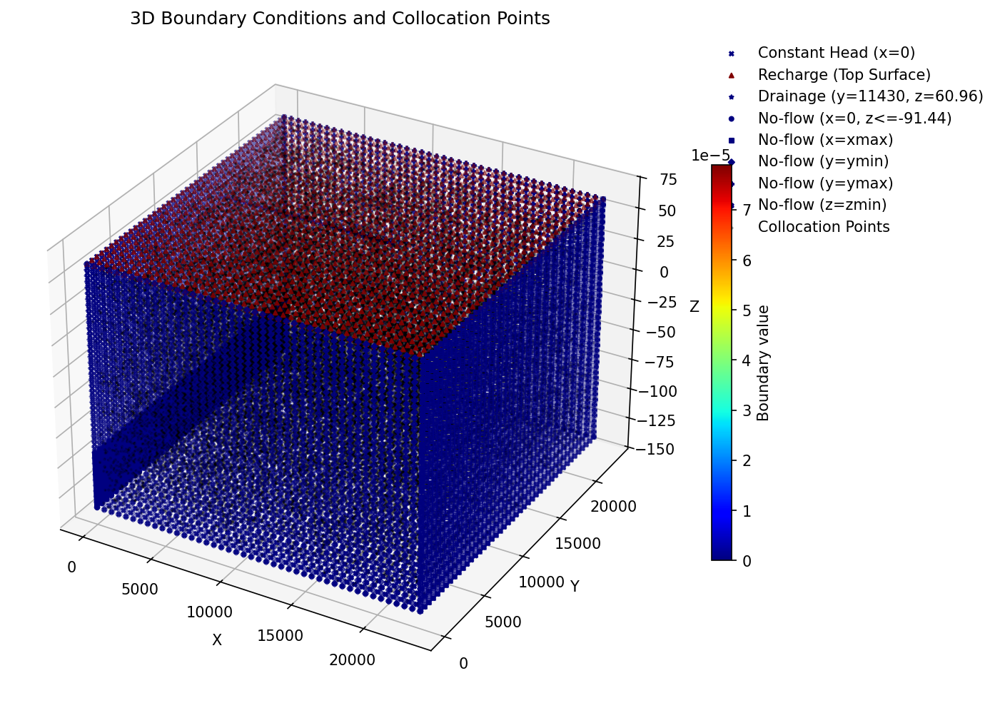

<Figure size 640x480 with 0 Axes>

In [25]:
from mpl_toolkits.mplot3d import Axes3D  # 꼭 포함시켜야 함

def plot_3D_boundary_conditions(
    x_const, y_const, z_const, bc_const,
    x_re, y_re, z_re, bc_re,
    x_dr, y_dr, z_dr, q_dr,
    x_nf_xmin, y_nf_xmin, z_nf_xmin, bc_nf_xmin,
    x_nf_x, y_nf_x, z_nf_x, bc_nf_x,
    x_nf_ymin, y_nf_ymin, z_nf_ymin, bc_nf_ymin,
    x_nf_ymax, y_nf_ymax, z_nf_ymax, bc_nf_ymax,
    x_nf_zmin, y_nf_zmin, z_nf_zmin, bc_nf_zmin,
    x_c, y_c, z_c
):
    fig = plt.figure(figsize=(10, 8), dpi=150)
    ax = fig.add_subplot(111, projection='3d')

    # 모든 bc 값을 모아서 color range 설정
    all_bc_values = jnp.concatenate([
        bc_const, bc_re, q_dr,
        bc_nf_xmin, bc_nf_x, bc_nf_ymin, bc_nf_ymax, bc_nf_zmin
    ])
    vmin, vmax = all_bc_values.min(), all_bc_values.max()

    # Scatter plot settings
    s = 8  # Point size
    alpha = 0.8  # Transparency

    # Plot each boundary condition separately
    scatter1 = ax.scatter(x_const, y_const, z_const, c=bc_const, marker='x', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='Constant Head (x=0)')

    ax.scatter(x_re, y_re, z_re, c=bc_re, marker='^', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='Recharge (Top Surface)')

    ax.scatter(x_dr, y_dr, z_dr, c=q_dr, marker='*', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='Drainage (y=11430, z=60.96)')

    ax.scatter(x_nf_xmin, y_nf_xmin, z_nf_xmin, c=bc_nf_xmin, marker='o', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='No-flow (x=0, z<=-91.44)')

    ax.scatter(x_nf_x, y_nf_x, z_nf_x, c=bc_nf_x, marker='s', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='No-flow (x=xmax)')
    ax.scatter(x_nf_ymin, y_nf_ymin, z_nf_ymin, c=bc_nf_ymin, marker='D', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='No-flow (y=ymin)')
    ax.scatter(x_nf_ymax, y_nf_ymax, z_nf_ymax, c=bc_nf_ymax, marker='P', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='No-flow (y=ymax)')
    ax.scatter(x_nf_zmin, y_nf_zmin, z_nf_zmin, c=bc_nf_zmin, marker='X', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='No-flow (z=zmin)')

    # Plot collocation points (small black dots)

    ax.scatter(x_c, y_c, z_c, c='k', marker='.', alpha=0.3, s=5, label='Collocation Points')

    # Labels and title
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_title('3D Boundary Conditions and Collocation Points')

    # Colorbar
    cbar = fig.colorbar(scatter1, ax=ax, shrink=0.6, aspect=20)
    cbar.set_label('Boundary value')

    # Legend
    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1), frameon=False)

    plt.show()  # 플롯을 화면에 표시
    plt.tight_layout()  # 레이아웃을 자동으로 조정

plot_3D_boundary_conditions(
    x_const, y_const, z_const, bc_const,
    x_re, y_re, z_re, bc_re,
    x_dr, y_dr, z_dr,  q_dr,
    x_nf_xmin, y_nf_xmin, z_nf_xmin, bc_nf_xmin,
    x_nf_xmax, y_nf_xmax, z_nf_xmax, bc_nf_xmax,
    x_nf_ymin, y_nf_ymin, z_nf_ymin, bc_nf_ymin,
    x_nf_ymax, y_nf_ymax, z_nf_ymax, bc_nf_ymax,
    x_nf_zmin, y_nf_zmin, z_nf_zmin, bc_nf_zmin,
    x_c, y_c, z_c
)


In [26]:
def pde_residual_3d_darcy(xyz, h):
    """
    Compute the PDE residual for 3D Darcy's groundwater flow in heterogeneous media.
    """
    xyz = xyz.reshape(-1, 3)
    x, y, z = xyz[:, 0:1], xyz[:, 1:2], xyz[:, 2:3]

    K_x, K_y, K_z = hydraulic_conductivity(x, y, z)

    # Compute gradients (First-order derivatives) of the neural network output (h)
    h_grad = vmap(jacfwd(h))(xyz)

    h_x, h_y, h_z = h_grad[:, 0], h_grad[:, 1], h_grad[:, 2]

    # Compute second derivatives
    def h_x_fn(xyz_):
        return jacfwd(h)(xyz_)[0]

    def h_y_fn(xyz_):
        return jacfwd(h)(xyz_)[1]

    def h_z_fn(xyz_):
        return jacfwd(h)(xyz_)[2]

    h_xx = vmap(jacfwd(h_x_fn))(xyz)
    h_yy = vmap(jacfwd(h_y_fn))(xyz)
    h_zz = vmap(jacfwd(h_z_fn))(xyz)

    # Divergence of flux (∇·q)
    div_q = -(K_x * h_xx[:, 0] + K_y * h_yy[:, 1] + K_z * h_zz[:, 2])

    pde_res = div_q.reshape(-1, 1)
    return pde_res

In [11]:
# Generate 3D grid for visualization
nx, ny, nz = 20, 20, 20
x = np.linspace(xmin, xmax, nx)
y = np.linspace(ymin, ymax, ny)
z = np.linspace(zmin, zmax, nz)
X, Y, Z = np.meshgrid(x, y, z, indexing='ij')
xyz_points = np.vstack([X.ravel(), Y.ravel(), Z.ravel()]).T  # Shape (nx*ny*nz, 3)

In [12]:
# Define the Neural Network Architecture
def neural_net(params, xyz):
    """
    Forward pass through the neural network.
    """
    for w, b in params:
        h_nn = jnp.dot(xyz, w) + b
        xyz = jnp.tanh(h_nn)  # Activation function
    return h_nn.reshape(-1, 1)

In [27]:
def init_mlp(layers, key):
    """
    Initialize the neural network using Xavier initialization.

    Args:
        layers: List defining the number of nodes in each layer (e.g., [1, 50, 50, 1]).
        key: Random key for initialization.

    Returns:
        params: Initialized weights and biases for the network.
    """
    params = []
    for i in range(len(layers) - 1):
        key, subkey = random.split(key)
        bound = jnp.sqrt(6. / (layers[i] + layers[i+1]))
        weights = random.uniform(subkey, (layers[i], layers[i+1]), minval=-bound, maxval=bound)
        biases = jnp.zeros(layers[i+1])
        params.append((weights, biases))
    return params

In [28]:
def loss_func(params, colloc, conds, colloc_h_init):
    """
    Computes the total loss for the 3D Darcy PINN model with Face-specific boundary conditions.
    """
    def h(xyz):
        return neural_net(params, xyz)

    # 단일 포인트 input을 위한 h_single 함수 정의
    def h_single(xyz_single):
        xyz_single = xyz_single.reshape(1, -1)  # (1,3)
        return neural_net(params, xyz_single)[0, 0]

    # 1. PDE Residual Loss (colloc points에서)
    pde_res = pde_residual_3d_darcy(colloc, h_single).reshape(-1, 1)
    pde_loss = jnp.mean(jnp.nan_to_num((pde_res) ** 2, nan=1e6, posinf=1e6, neginf=1e6))

    # 2. Dirichlet BC Loss (BC_const = conds[0])
    dbc_loss = 0
    for cond in [conds[0]]:  # Constant head
        x_b, y_b, z_b, h_b = cond[:, [0]], cond[:, [1]], cond[:, [2]], cond[:, [3]]
        bc_xyz = jnp.hstack([x_b, y_b, z_b])
        dbc_loss += jnp.mean((h(bc_xyz) - h_b) ** 2)

    # 3. Recharge BC Loss (BC_re = conds[1])
    print("conds[1][:, :3] shape:", conds[1][:, :3].shape)
    print("conds[1][:, 3:] shape:", conds[1][:, 3:].shape)
    pde_re_res = pde_recharge_3d_darcy(conds[1][:, :3], params)
    print("pde_re_res shape:", pde_re_res.shape)
    re_loss = jnp.mean((pde_re_res + conds[1][:, 3:]) ** 2)
    # 4. Neumann BC Losses

    # 방향별 미분 함수 (vmap 적용된 버전)
    dh_dx = lambda xyz: vmap(lambda x: jacfwd(h_single)(x)[0])(xyz)
    dh_dy = lambda xyz: vmap(lambda x: jacfwd(h_single)(x)[1])(xyz)
    dh_dz = lambda xyz: vmap(lambda x: jacfwd(h_single)(x)[2])(xyz)

    # 4-1. Drainage BC (BC_dr = conds[2])
    bc_xyz = conds[2][:, :3]
    x_drain = bc_xyz[:, 0:1]
    h_pred = h(bc_xyz)

    # Darcy 유량 예측
    h_grad_z = dh_dz(bc_xyz)
    K_x, K_y, K_z = hydraulic_conductivity(bc_xyz[:, 0:1], bc_xyz[:, 1:2], bc_xyz[:, 2:3])
    q_predicted = -K_z * h_grad_z

    # 기대 Drain 유량
    q_dr_expected = drain_discharge(h_pred, x_drain)
    drain_loss = jnp.mean((q_predicted - q_dr_expected) ** 2)

    # 4-2. No-flow BCs
    nf_x_loss = 0.0
    for cond in [conds[3], conds[4]]:  # x=xmin, x=xmax
        bc_xyz, bc_grad = cond[:, :3], cond[:, [3]]
        nf_x_loss += jnp.mean((dh_dx(bc_xyz) - bc_grad) ** 2)

    nf_y_loss = 0.0
    for cond in [conds[5], conds[6]]:  # y=ymin, y=ymax
        bc_xyz, bc_grad = cond[:, :3], cond[:, [3]]
        nf_y_loss += jnp.mean((dh_dy(bc_xyz) - bc_grad) ** 2)

    nf_z_loss = 0.0
    cond = conds[7]  # z=zmin
    bc_xyz, bc_grad = cond[:, :3], cond[:, [3]]
    nf_z_loss += jnp.mean((dh_dz(bc_xyz) - bc_grad) ** 2)

    # 5. (Optional) Soft constraint (지금은 주석처리)

    # Total Loss
    total_loss = pde_loss + dbc_loss + re_loss + drain_loss + nf_x_loss + nf_y_loss + nf_z_loss

    return jnp.sum(total_loss)


In [29]:
def pde_recharge_3d_darcy(xyz, params):
    def h_single(xyz_single):
        return neural_net(params, xyz_single.reshape(1, -1))[0, 0]

    xyz = xyz.reshape(-1, 3)

    K_x, K_y, K_z = hydraulic_conductivity(xyz[:, 0:1], xyz[:, 1:2], xyz[:, 2:3])

    h_grad_fn = lambda xyz_: jacfwd(h_single)(xyz_)  # Single input
    h_grad = vmap(h_grad_fn)(xyz)                    # Vmap over all xyz points

    h_z = h_grad[:, 2]  # z 방향 미분만
    qz = -K_z.flatten() * h_z

    return qz.reshape(-1, 1)

In [30]:
colloc_h_init = jnp.zeros((colloc.shape[0],1))
print(colloc_h_init)

[[0.]
 [0.]
 [0.]
 ...
 [0.]
 [0.]
 [0.]]


conds[1][:, :3] shape: (1936, 3)
conds[1][:, 3:] shape: (1936, 1)
pde_re_res shape: (1936, 1)
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 0: Loss = 1.5321e-01
Epoch 0: Loss = 1.5321e-01


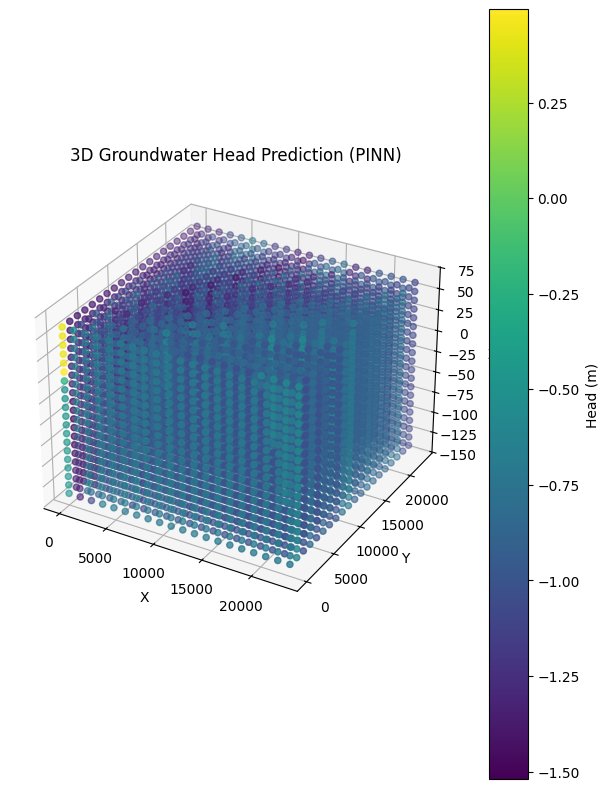

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 10: Loss = 2.7404e-01
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 20: Loss = 2.6621e-03
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 30: Loss = 1.3520e-02
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 40: Loss = 1.0240e-02
Epoch 50: Loss = 9.9918e-04
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 60: Loss = 4.5791e-04
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 70: Loss = 4.6928e-04
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 80: Loss = 3.4175e-05
Epoch 90: Loss = 9.0522e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_100.pkl
Epoch 100: Loss = 2.8191e-05
Epoch 100: Loss = 2.8191e-05


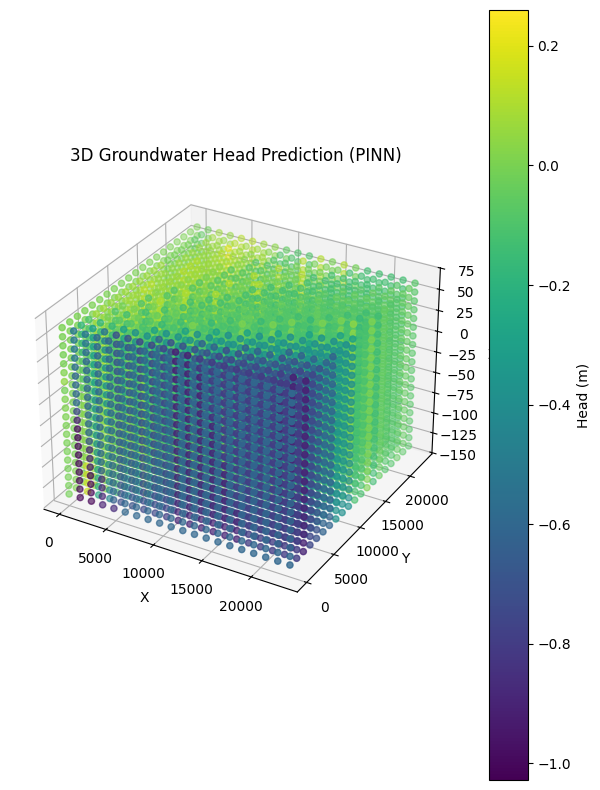

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 110: Loss = 3.1301e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 120: Loss = 3.0651e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 130: Loss = 2.0840e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 140: Loss = 2.1489e-05
Epoch 150: Loss = 2.3913e-05
Epoch 160: Loss = 2.8381e-05
Epoch 170: Loss = 2.2054e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 180: Loss = 1.8922e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive

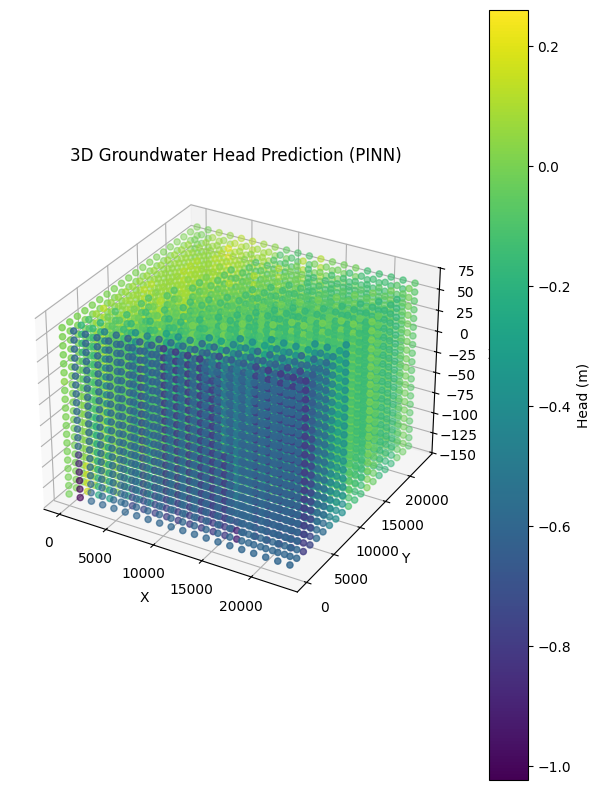

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 210: Loss = 1.6599e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 220: Loss = 1.5414e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 230: Loss = 1.4646e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 240: Loss = 1.4743e-05
Epoch 250: Loss = 1.5365e-05
Epoch 260: Loss = 1.6190e-05
Epoch 270: Loss = 1.4521e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 280: Loss = 1.5626e-05
Epoch 290: Loss = 1.5378e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_300.pkl
Epoch 300: Loss = 1.4746e-05
Epoch 300: Loss = 1.4746e-05


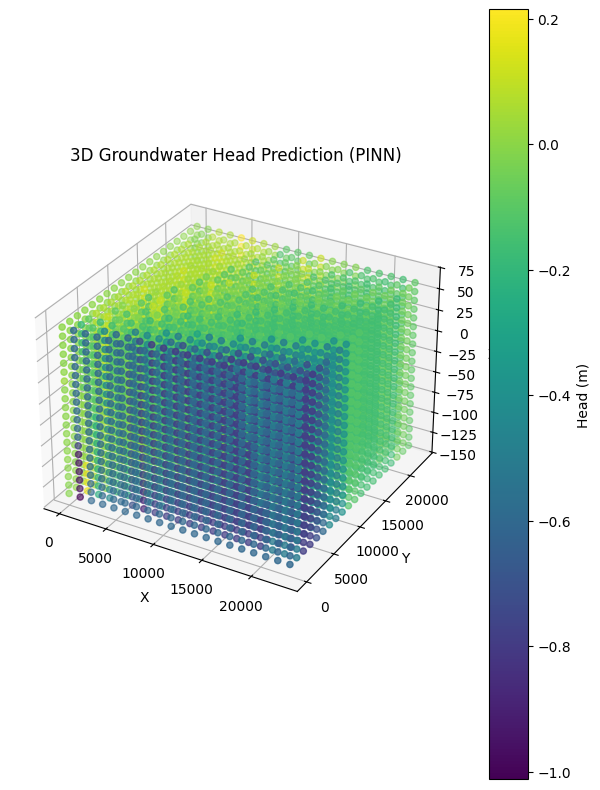

Epoch 310: Loss = 1.5150e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 320: Loss = 1.4188e-05
Epoch 330: Loss = 1.5368e-05
Epoch 340: Loss = 1.4425e-05
Epoch 350: Loss = 1.6422e-05
Epoch 360: Loss = 1.4570e-05
Epoch 370: Loss = 1.4530e-05
Epoch 380: Loss = 1.4896e-05
Epoch 390: Loss = 1.4669e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_400.pkl
Epoch 400: Loss = 1.5550e-05
Epoch 400: Loss = 1.5550e-05


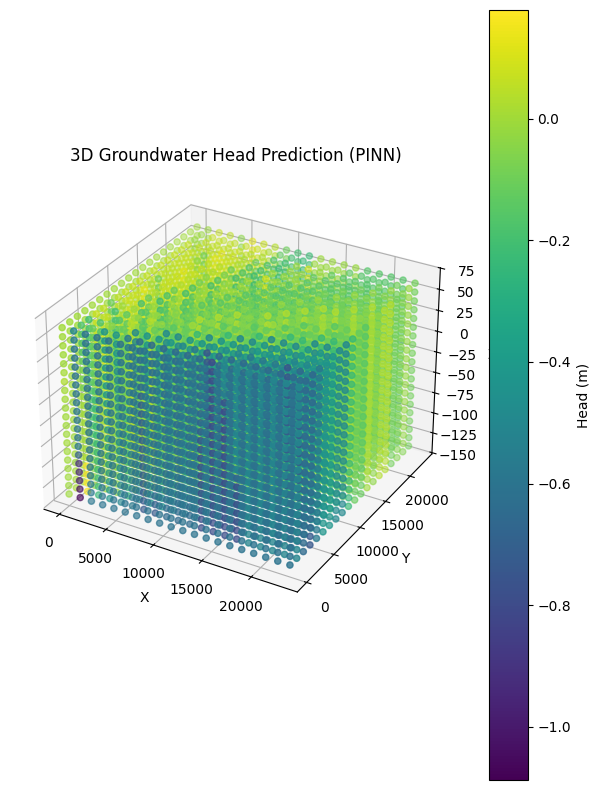

Epoch 410: Loss = 1.7836e-05
Epoch 420: Loss = 1.6004e-05
Epoch 430: Loss = 1.7396e-05
Epoch 440: Loss = 1.5487e-05
Epoch 450: Loss = 1.4757e-05
Epoch 460: Loss = 1.4521e-05
Epoch 470: Loss = 1.4943e-05
Epoch 480: Loss = 1.5849e-05
Epoch 490: Loss = 1.6129e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_500.pkl
Epoch 500: Loss = 1.4247e-05
Epoch 500: Loss = 1.4247e-05


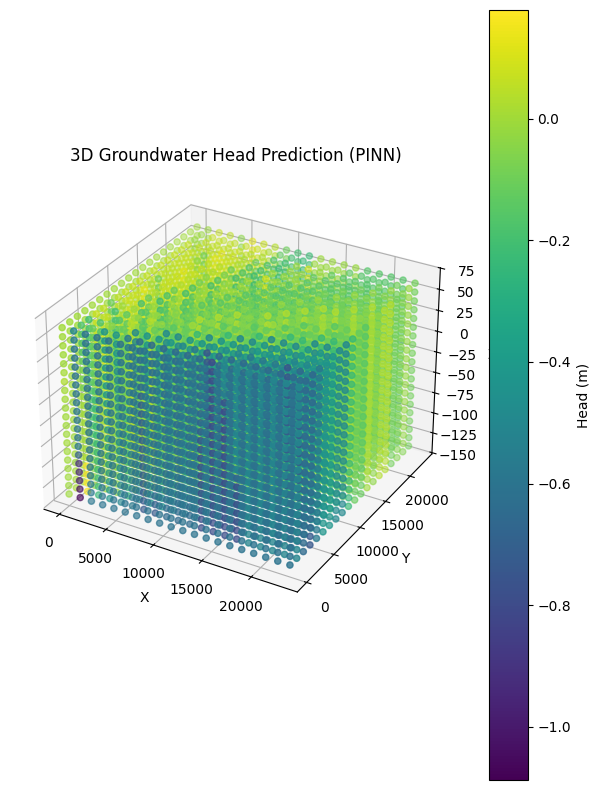

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 510: Loss = 1.4011e-05
Epoch 520: Loss = 1.3929e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 530: Loss = 1.2115e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 540: Loss = 1.4051e-05
Epoch 550: Loss = 1.3208e-05
Epoch 560: Loss = 1.3812e-05
Epoch 570: Loss = 1.5051e-05
Epoch 580: Loss = 1.5281e-05
Epoch 590: Loss = 1.4781e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_600.pkl
Epoch 600: Loss = 1.4460e-05
Epoch 600: Loss = 1.4460e-05


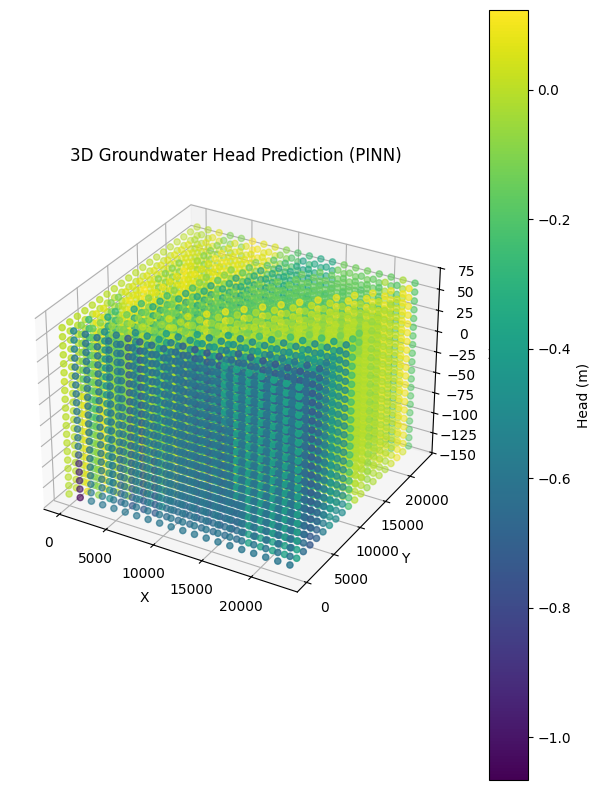

Epoch 610: Loss = 1.4041e-05
Epoch 620: Loss = 1.2891e-05
Epoch 630: Loss = 1.3523e-05
Epoch 640: Loss = 1.3742e-05
Epoch 650: Loss = 1.4010e-05
Epoch 660: Loss = 1.4362e-05
Epoch 670: Loss = 1.4116e-05
Epoch 680: Loss = 1.4338e-05
Epoch 690: Loss = 1.2498e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_700.pkl
Epoch 700: Loss = 1.3002e-05
Epoch 700: Loss = 1.3002e-05


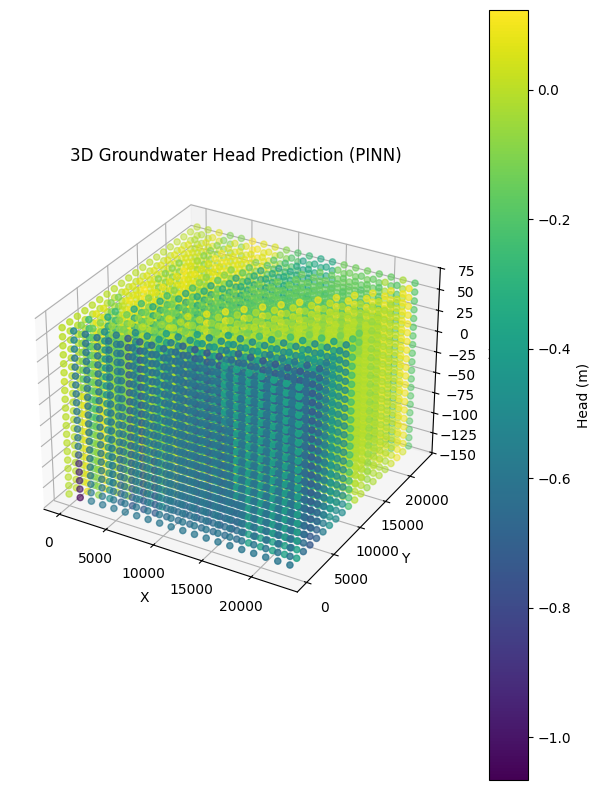

Epoch 710: Loss = 1.2337e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 720: Loss = 1.3130e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 730: Loss = 1.1028e-05
Epoch 740: Loss = 1.1648e-05
Epoch 750: Loss = 1.3670e-05
Epoch 760: Loss = 1.2464e-05
Epoch 770: Loss = 1.2098e-05
Epoch 780: Loss = 1.4016e-05
Epoch 790: Loss = 1.2467e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_800.pkl
Epoch 800: Loss = 1.2372e-05
Epoch 800: Loss = 1.2372e-05


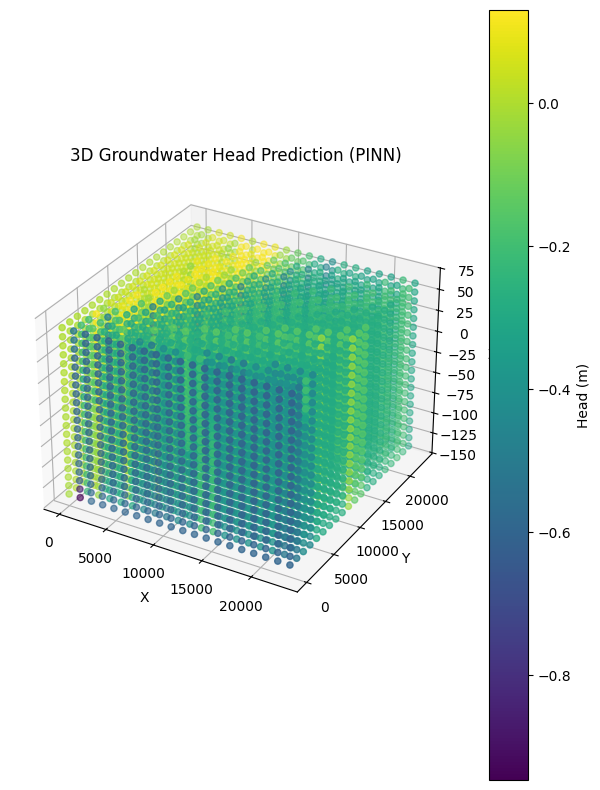

Epoch 810: Loss = 1.1414e-05
Epoch 820: Loss = 1.1690e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 830: Loss = 1.1741e-05
Epoch 840: Loss = 1.2376e-05
Epoch 850: Loss = 1.0721e-05
Epoch 860: Loss = 1.2851e-05
Epoch 870: Loss = 1.1347e-05
Epoch 880: Loss = 1.1314e-05
Epoch 890: Loss = 1.0766e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_900.pkl
Epoch 900: Loss = 1.0689e-05
Epoch 900: Loss = 1.0689e-05


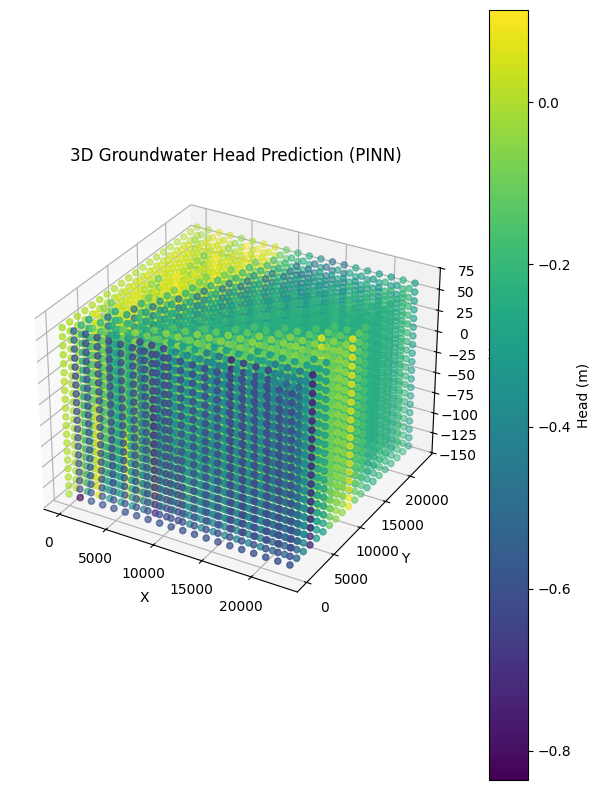

Epoch 910: Loss = 1.2518e-05
Epoch 920: Loss = 1.1189e-05
Epoch 930: Loss = 1.1734e-05
Epoch 940: Loss = 1.1055e-05
Epoch 950: Loss = 1.1833e-05
Epoch 960: Loss = 1.1037e-05
Epoch 970: Loss = 1.0963e-05
Epoch 980: Loss = 1.1921e-05
Epoch 990: Loss = 1.1318e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_1000.pkl
Epoch 1000: Loss = 1.0682e-05
Epoch 1000: Loss = 1.0682e-05


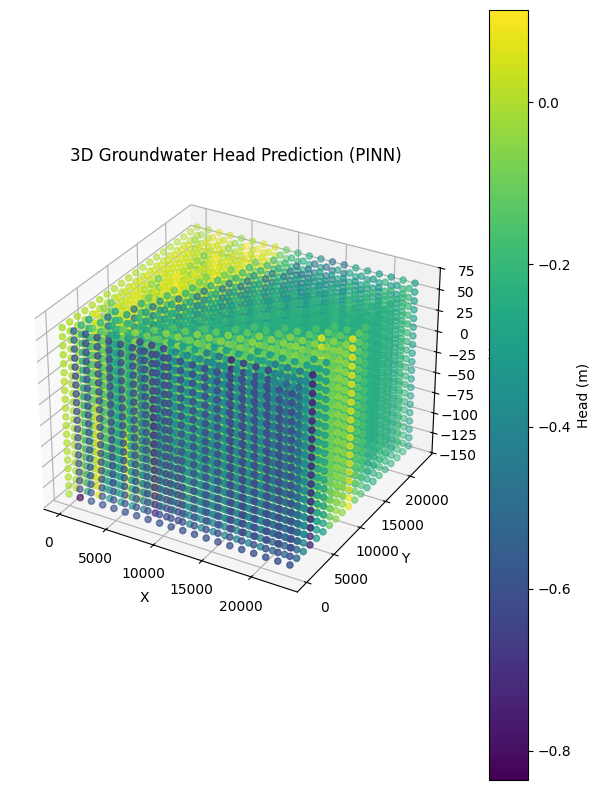

Epoch 1010: Loss = 1.1568e-05
Epoch 1020: Loss = 1.0911e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1030: Loss = 1.0778e-05
Epoch 1040: Loss = 1.1399e-05
Epoch 1050: Loss = 1.0991e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1060: Loss = 1.0724e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1070: Loss = 9.5602e-06
Epoch 1080: Loss = 9.4123e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1090: Loss = 1.0647e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_1100.pkl
Epoch 1100: Loss = 1.0518e-05
Epoch 1100: Loss = 1.0518e-05


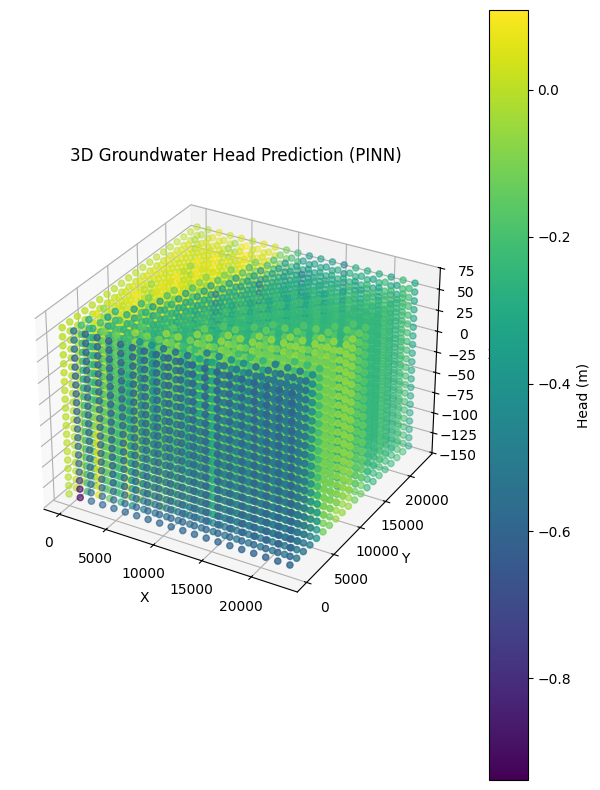

Epoch 1110: Loss = 1.0761e-05
Epoch 1120: Loss = 1.1886e-05
Epoch 1130: Loss = 1.0260e-05
Epoch 1140: Loss = 1.0228e-05
Epoch 1150: Loss = 1.1622e-05
Epoch 1160: Loss = 1.0614e-05
Epoch 1170: Loss = 1.0239e-05
Epoch 1180: Loss = 1.0516e-05
Epoch 1190: Loss = 1.1298e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_1200.pkl
Epoch 1200: Loss = 1.0462e-05
Epoch 1200: Loss = 1.0462e-05


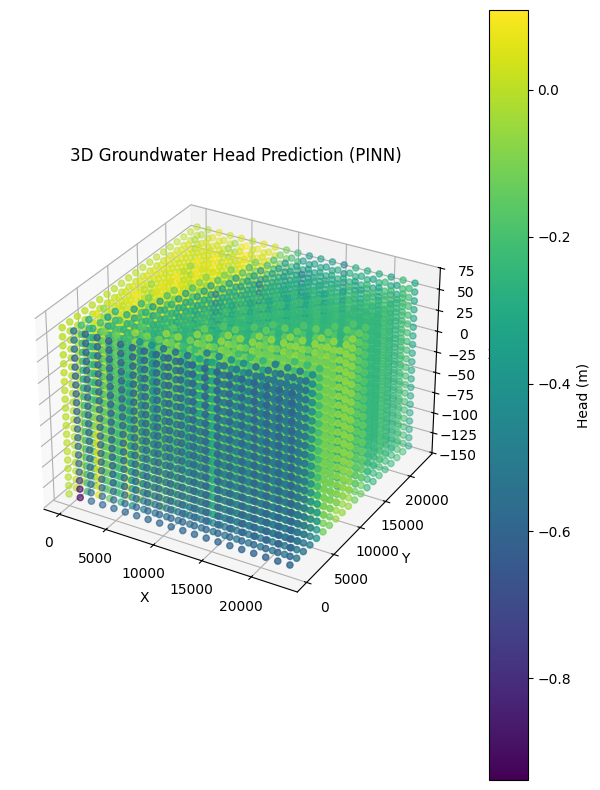

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1210: Loss = 9.3240e-06
Epoch 1220: Loss = 1.0459e-05
Epoch 1230: Loss = 9.6713e-06
Epoch 1240: Loss = 1.0627e-05
Epoch 1250: Loss = 9.5907e-06
Epoch 1260: Loss = 1.0829e-05
Epoch 1270: Loss = 1.2241e-05
Epoch 1280: Loss = 1.0649e-05
Epoch 1290: Loss = 1.0356e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_1300.pkl
Epoch 1300: Loss = 9.0164e-06
Epoch 1300: Loss = 9.0164e-06


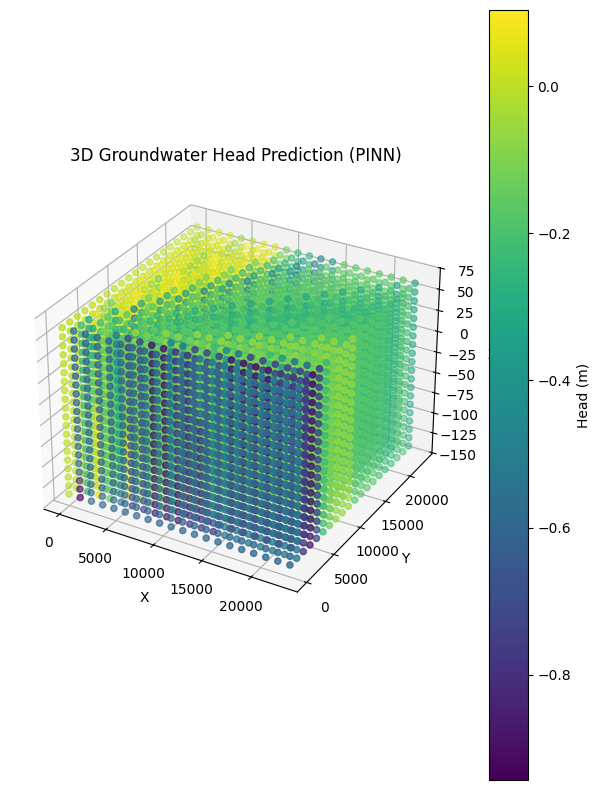

Epoch 1310: Loss = 1.0404e-05
Epoch 1320: Loss = 1.0225e-05
Epoch 1330: Loss = 1.0512e-05
Epoch 1340: Loss = 1.0360e-05
Epoch 1350: Loss = 9.0896e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1360: Loss = 1.0422e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1370: Loss = 1.0024e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1380: Loss = 1.0032e-05
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1390: Loss = 9.5725e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_1400.pkl
Epoch 1400: Loss = 8.0030e-06
Epoch 1400: Loss = 8.0030e-06


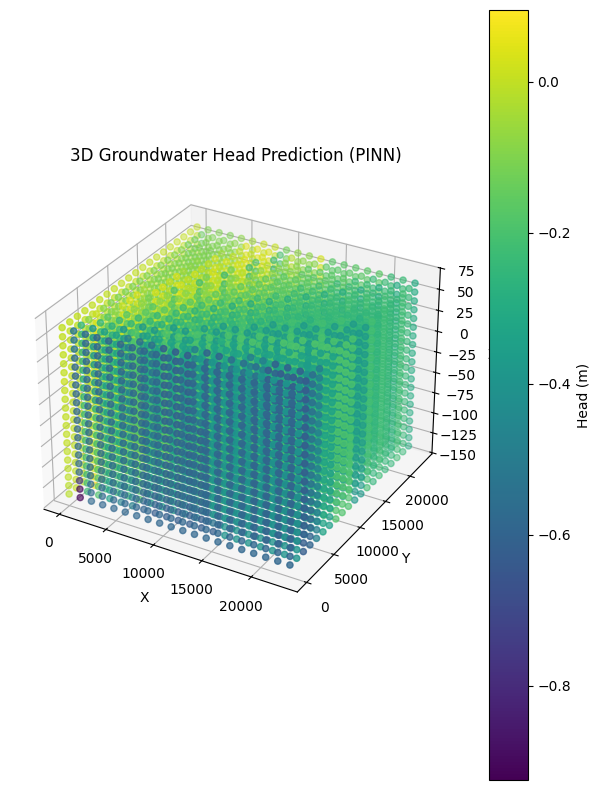

Epoch 1410: Loss = 9.8260e-06
Epoch 1420: Loss = 9.7515e-06
Epoch 1430: Loss = 8.8571e-06
Epoch 1440: Loss = 8.1935e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1450: Loss = 9.0279e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1460: Loss = 7.8648e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1470: Loss = 7.2848e-06
Epoch 1480: Loss = 8.3020e-06
Epoch 1490: Loss = 7.3734e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_1500.pkl
Epoch 1500: Loss = 8.0332e-06
Epoch 1500: Loss = 8.0332e-06


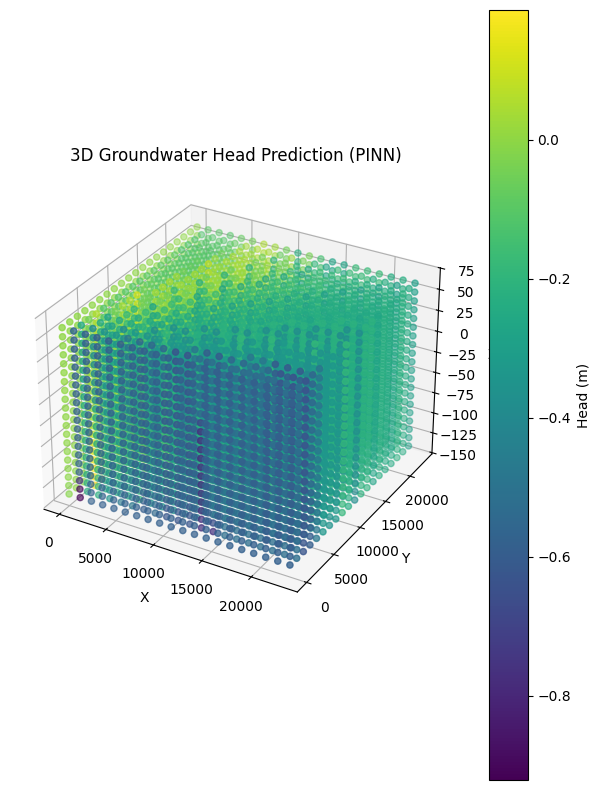

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1510: Loss = 7.1595e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1520: Loss = 7.8813e-06
Epoch 1530: Loss = 6.8033e-06
Epoch 1540: Loss = 7.7277e-06
Epoch 1550: Loss = 8.3318e-06
Epoch 1560: Loss = 7.9049e-06
Epoch 1570: Loss = 8.0362e-06
Epoch 1580: Loss = 7.3977e-06
Epoch 1590: Loss = 7.7798e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_1600.pkl
Epoch 1600: Loss = 7.4063e-06
Epoch 1600: Loss = 7.4063e-06


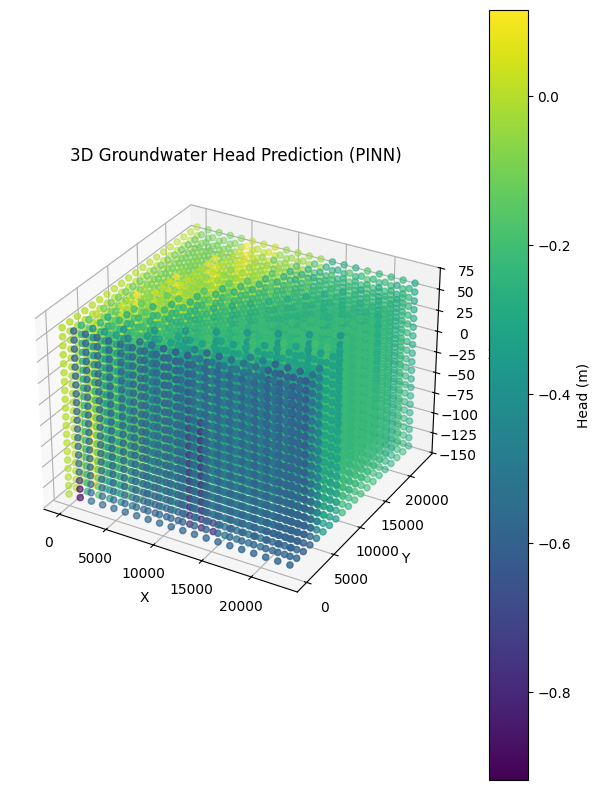

Epoch 1610: Loss = 7.5826e-06
Epoch 1620: Loss = 7.7345e-06
Epoch 1630: Loss = 7.5949e-06
Epoch 1640: Loss = 7.6021e-06
Epoch 1650: Loss = 7.2015e-06
Epoch 1660: Loss = 7.6472e-06
Epoch 1670: Loss = 7.4713e-06
Epoch 1680: Loss = 6.8759e-06
Epoch 1690: Loss = 7.2076e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_1700.pkl
Epoch 1700: Loss = 7.5987e-06
Epoch 1700: Loss = 7.5987e-06


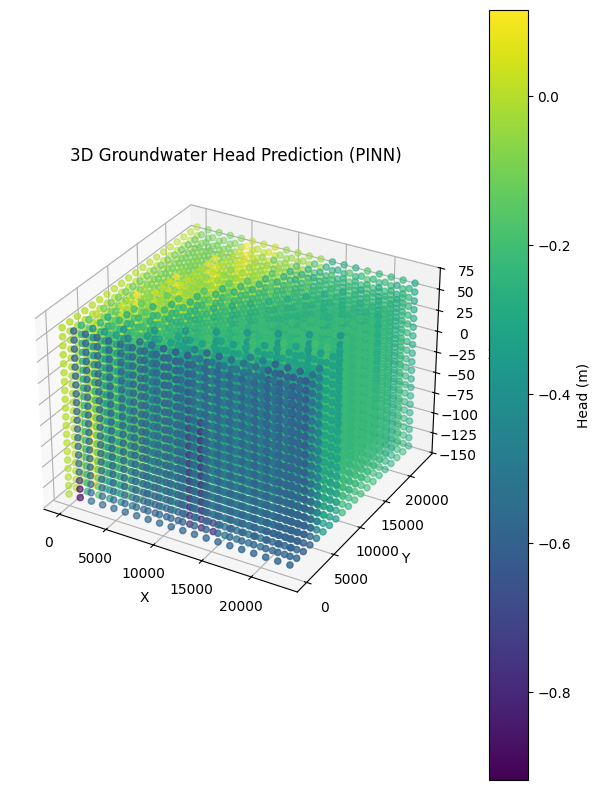

Epoch 1710: Loss = 7.7965e-06
Epoch 1720: Loss = 7.4310e-06
Epoch 1730: Loss = 7.7970e-06
Epoch 1740: Loss = 7.3187e-06
Epoch 1750: Loss = 7.8369e-06
Epoch 1760: Loss = 7.9839e-06
Epoch 1770: Loss = 7.1393e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1780: Loss = 6.8415e-06
Epoch 1790: Loss = 6.6840e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_1800.pkl
Epoch 1800: Loss = 7.3139e-06
Epoch 1800: Loss = 7.3139e-06


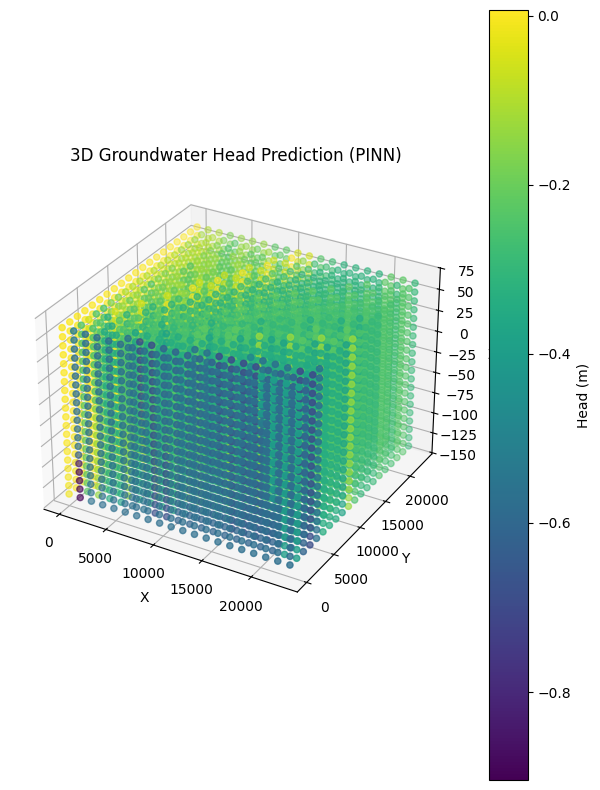

Epoch 1810: Loss = 7.0305e-06
Epoch 1820: Loss = 7.6007e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1830: Loss = 6.4880e-06
Epoch 1840: Loss = 6.1998e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1850: Loss = 7.7295e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1860: Loss = 6.6688e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1870: Loss = 6.3594e-06
Epoch 1880: Loss = 6.0805e-06
Epoch 1890: Loss = 5.9073e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_1900.pkl
Epoch 1900: Loss = 6.0263e-06
Epoch 1900: Loss = 6.0263e-06


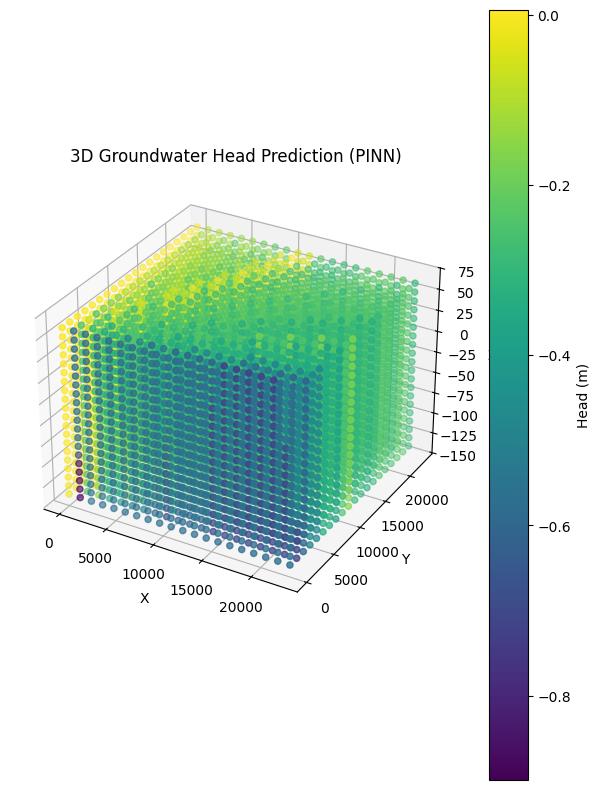

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1910: Loss = 6.4001e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1920: Loss = 5.5335e-06
Epoch 1930: Loss = 5.9799e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1940: Loss = 5.9042e-06
Epoch 1950: Loss = 6.2222e-06
Epoch 1960: Loss = 5.4388e-06
Epoch 1970: Loss = 5.7559e-06
Epoch 1980: Loss = 6.4970e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 1990: Loss = 5.8762e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_2000.pkl
Epoch 2000: Loss = 5.8880e-06
Epoch 2000: Loss = 5.8880e-06


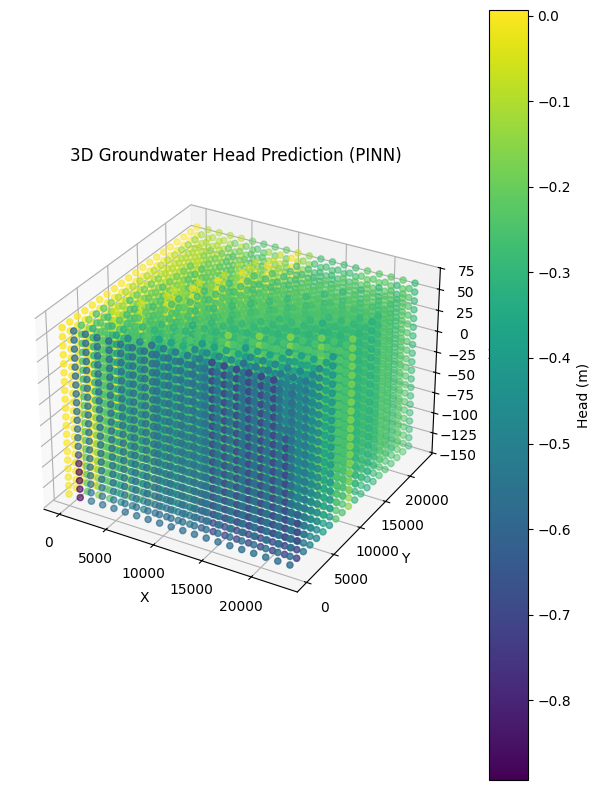

Epoch 2010: Loss = 5.8279e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2020: Loss = 5.1885e-06
Epoch 2030: Loss = 5.7531e-06
Epoch 2040: Loss = 5.9840e-06
Epoch 2050: Loss = 6.2901e-06
Epoch 2060: Loss = 5.9033e-06
Epoch 2070: Loss = 6.0766e-06
Epoch 2080: Loss = 6.1511e-06
Epoch 2090: Loss = 6.5207e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_2100.pkl
Epoch 2100: Loss = 6.5878e-06
Epoch 2100: Loss = 6.5878e-06


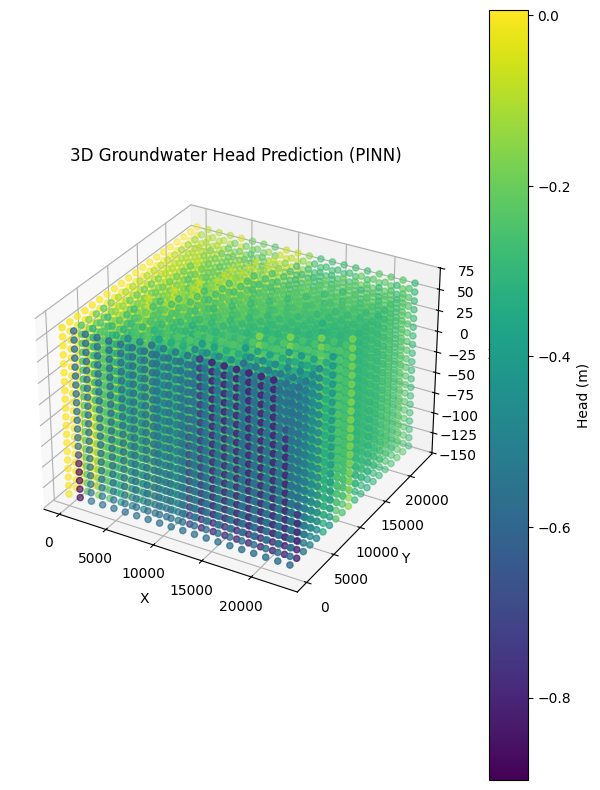

Epoch 2110: Loss = 5.4608e-06
Epoch 2120: Loss = 5.9289e-06
Epoch 2130: Loss = 5.6517e-06
Epoch 2140: Loss = 5.6850e-06
Epoch 2150: Loss = 6.0310e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2160: Loss = 5.3146e-06
Epoch 2170: Loss = 5.3816e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2180: Loss = 5.7626e-06
Epoch 2190: Loss = 5.2034e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_2200.pkl
Epoch 2200: Loss = 5.3706e-06
Epoch 2200: Loss = 5.3706e-06


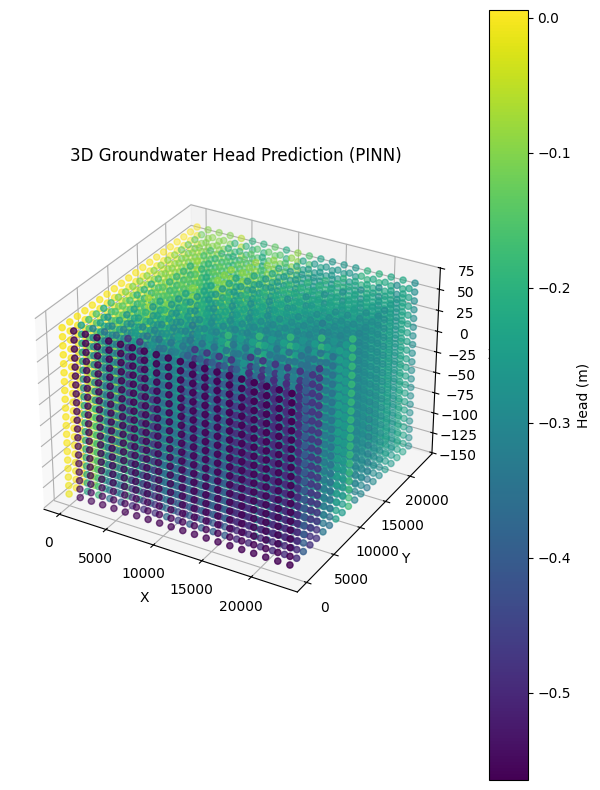

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2210: Loss = 5.7739e-06
Epoch 2220: Loss = 5.0351e-06
Epoch 2230: Loss = 5.2817e-06
Epoch 2240: Loss = 5.7499e-06
Epoch 2250: Loss = 5.3044e-06
Epoch 2260: Loss = 4.9652e-06
Epoch 2270: Loss = 5.6121e-06
Epoch 2280: Loss = 5.1405e-06
Epoch 2290: Loss = 5.1571e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_2300.pkl
Epoch 2300: Loss = 5.7184e-06
Epoch 2300: Loss = 5.7184e-06


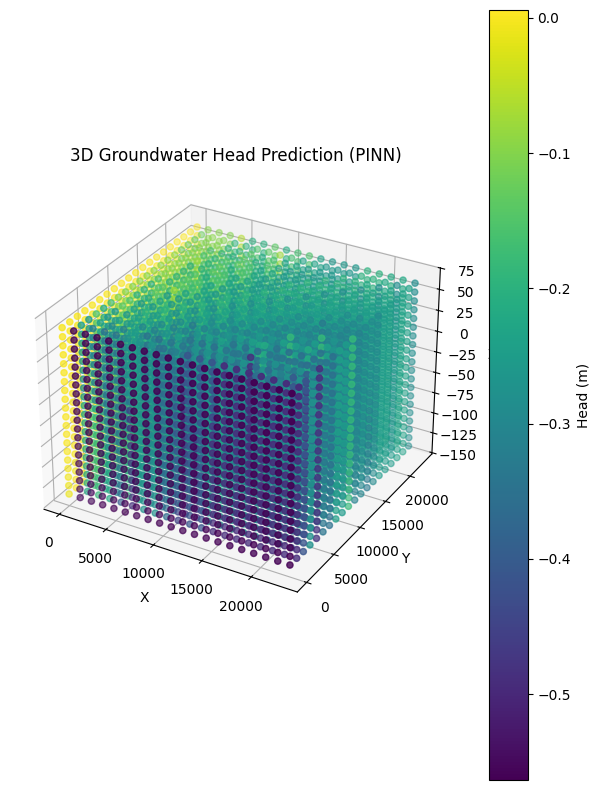

Epoch 2310: Loss = 5.8499e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2320: Loss = 4.6406e-06
Epoch 2330: Loss = 5.4017e-06
Epoch 2340: Loss = 5.1555e-06
Epoch 2350: Loss = 5.4441e-06
Epoch 2360: Loss = 5.6989e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2370: Loss = 5.4791e-06
Epoch 2380: Loss = 5.8576e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2390: Loss = 5.1425e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_2400.pkl
Epoch 2400: Loss = 4.5714e-06
Epoch 2400: Loss = 4.5714e-06


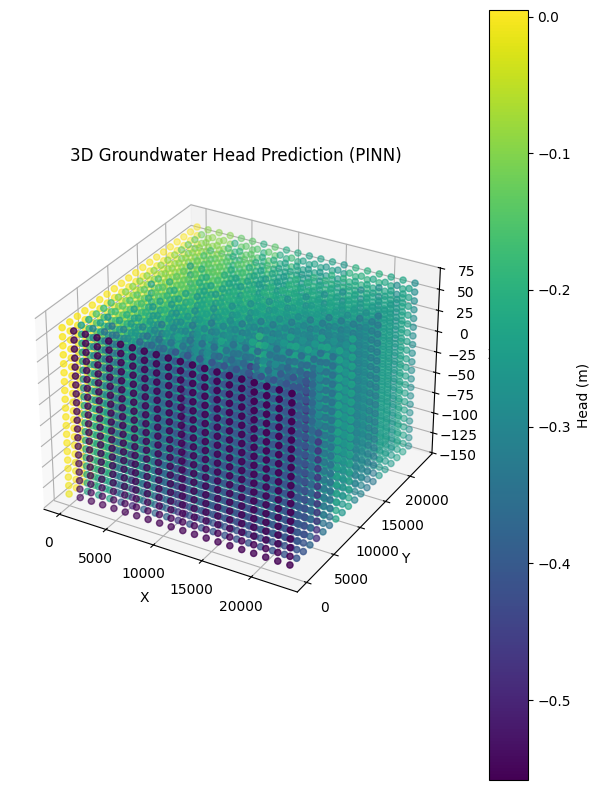

Epoch 2410: Loss = 5.6368e-06
Epoch 2420: Loss = 5.3452e-06
Epoch 2430: Loss = 5.4414e-06
Epoch 2440: Loss = 4.4405e-06
Epoch 2450: Loss = 5.2997e-06
Epoch 2460: Loss = 4.8646e-06
Epoch 2470: Loss = 4.5922e-06
Epoch 2480: Loss = 4.6633e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2490: Loss = 3.9427e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_2500.pkl
Epoch 2500: Loss = 4.1092e-06
Epoch 2500: Loss = 4.1092e-06


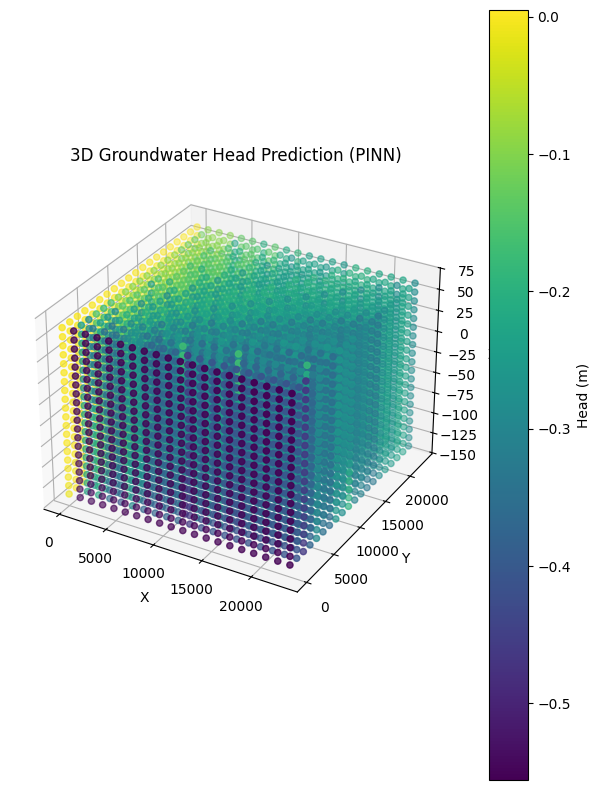

Epoch 2510: Loss = 3.9681e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2520: Loss = 3.8153e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2530: Loss = 3.8069e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2540: Loss = 4.1428e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2550: Loss = 4.0716e-06
Epoch 2560: Loss = 3.7737e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2570: Loss = 3.5238e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2580: Loss = 3.5495e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2590: Loss = 3.6566e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_2600.pkl
Epoch 2600: Loss = 3.8600e-06
Epoch 2600: Loss = 3.8600e-06


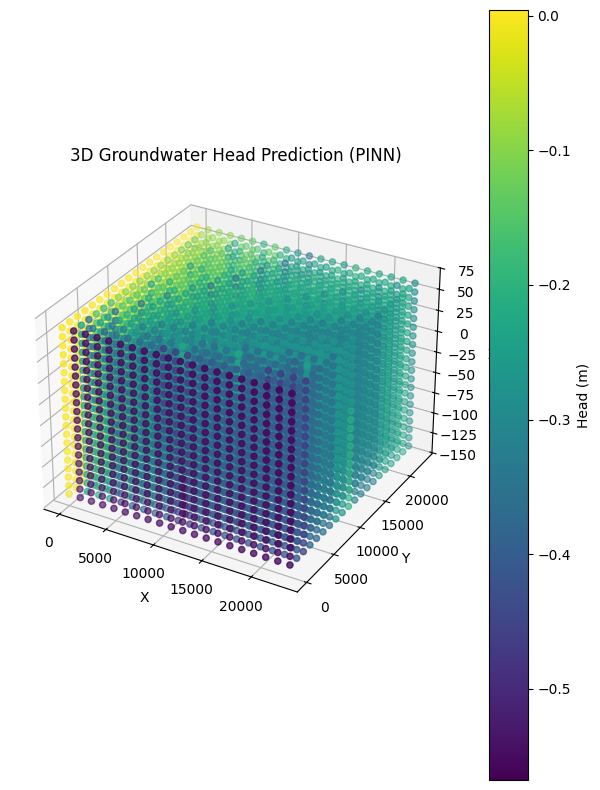

Epoch 2610: Loss = 3.5894e-06
Epoch 2620: Loss = 3.8029e-06
Epoch 2630: Loss = 4.2568e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2640: Loss = 3.2902e-06
Epoch 2650: Loss = 3.4819e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2660: Loss = 3.5083e-06
Epoch 2670: Loss = 3.5620e-06
Epoch 2680: Loss = 3.6298e-06
Epoch 2690: Loss = 3.5644e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_2700.pkl
Epoch 2700: Loss = 3.4651e-06
Epoch 2700: Loss = 3.4651e-06


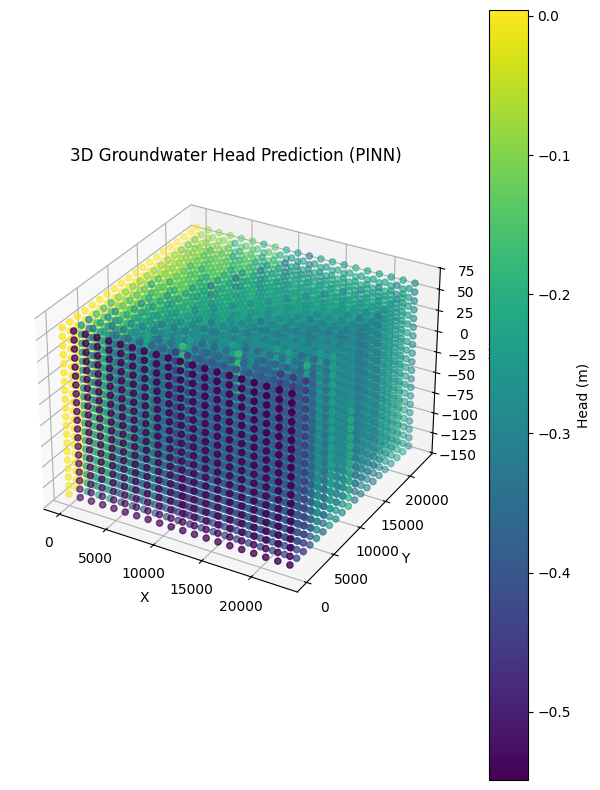

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2710: Loss = 3.3413e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2720: Loss = 2.9286e-06
Epoch 2730: Loss = 3.3388e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2740: Loss = 3.0292e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2750: Loss = 3.2317e-06
Epoch 2760: Loss = 3.2805e-06
Epoch 2770: Loss = 3.0564e-06
Epoch 2780: Loss = 2.9958e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2790: Loss = 2.9365e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_2800.pkl
Epoch 2800: Loss = 2.9898e-06
Epoch 2800: Loss = 2.9898e-06


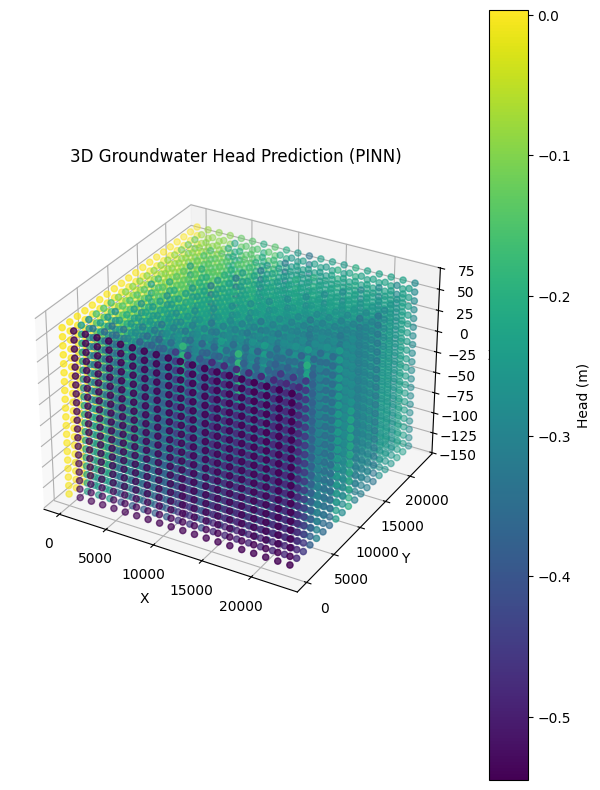

Epoch 2810: Loss = 2.7746e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2820: Loss = 2.8563e-06
Epoch 2830: Loss = 2.9559e-06
Epoch 2840: Loss = 2.8206e-06
Epoch 2850: Loss = 2.9243e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2860: Loss = 2.6315e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2870: Loss = 2.6561e-06
Epoch 2880: Loss = 2.8461e-06
Epoch 2890: Loss = 2.7302e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_2900.pkl
Epoch 2900: Loss = 2.6948e-06
Epoch 2900: Loss = 2.6948e-06


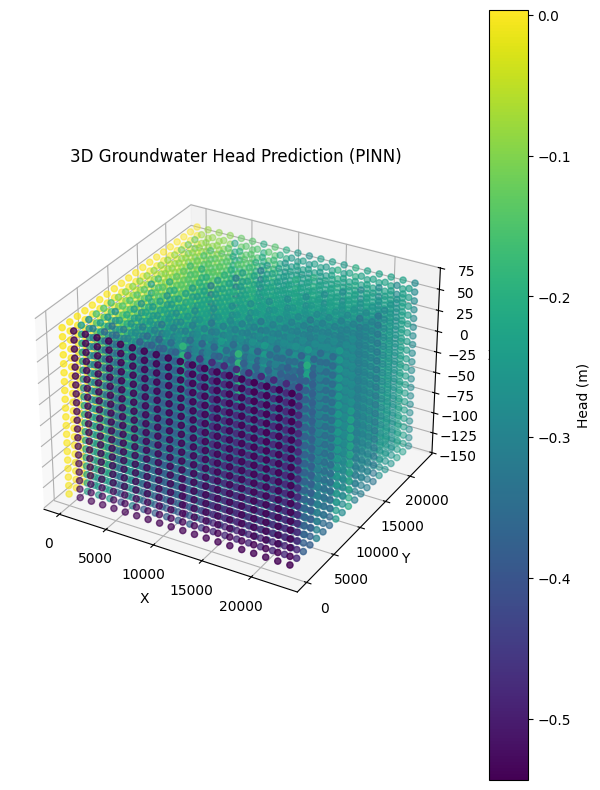

Epoch 2910: Loss = 2.7928e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2920: Loss = 2.6018e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2930: Loss = 2.7875e-06
Epoch 2940: Loss = 2.5552e-06
Epoch 2950: Loss = 2.6448e-06
Epoch 2960: Loss = 2.5430e-06
Epoch 2970: Loss = 2.7850e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2980: Loss = 2.5883e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 2990: Loss = 2.6409e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_3000.pkl
Epoch 3000: Loss = 2.4471e-06
Epoch 3000: Loss = 2.4471e-06


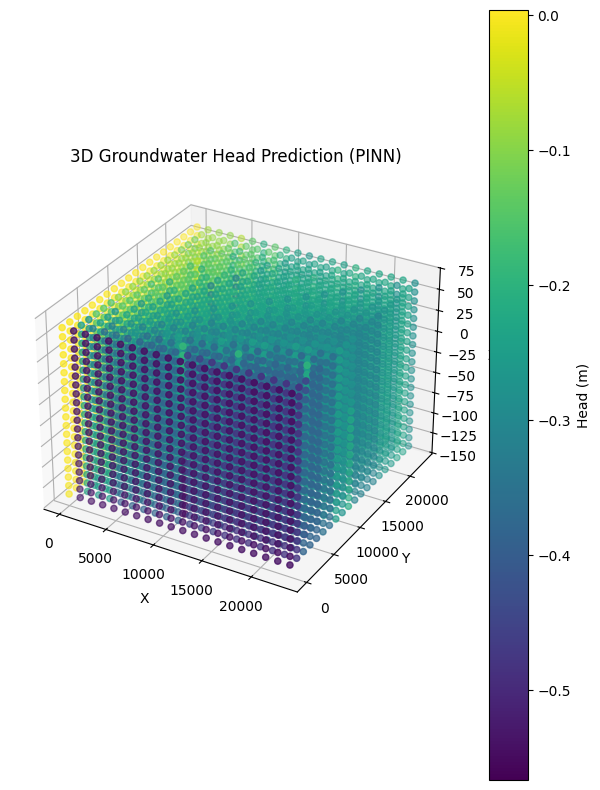

Epoch 3010: Loss = 2.5043e-06
Epoch 3020: Loss = 2.4619e-06
Epoch 3030: Loss = 2.5469e-06
Epoch 3040: Loss = 2.6222e-06
Epoch 3050: Loss = 2.5116e-06
Epoch 3060: Loss = 2.5265e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3070: Loss = 2.3514e-06
Epoch 3080: Loss = 2.3919e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3090: Loss = 2.5058e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_3100.pkl
Epoch 3100: Loss = 2.3604e-06
Epoch 3100: Loss = 2.3604e-06


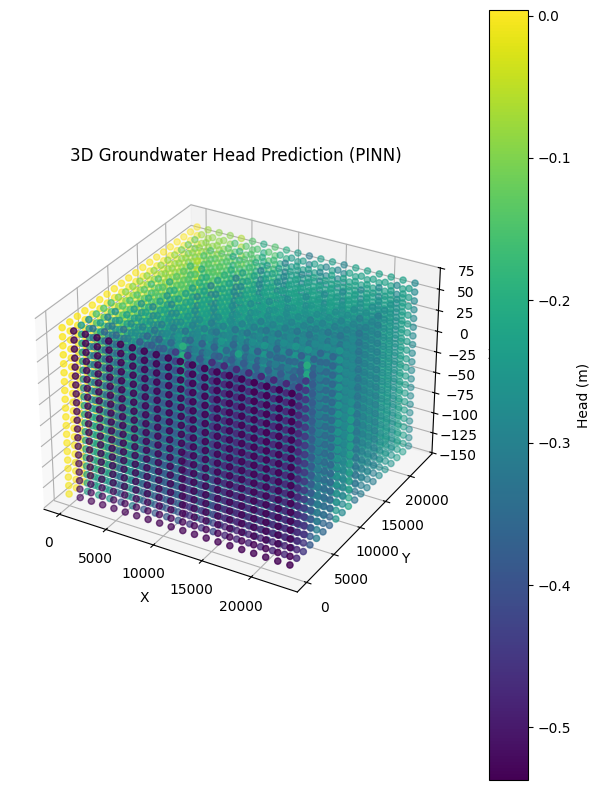

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3110: Loss = 2.4515e-06
Epoch 3120: Loss = 2.3756e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3130: Loss = 2.4777e-06
Epoch 3140: Loss = 2.4844e-06
Epoch 3150: Loss = 2.6511e-06
Epoch 3160: Loss = 2.3687e-06
Epoch 3170: Loss = 2.4518e-06
Epoch 3180: Loss = 2.5307e-06
Epoch 3190: Loss = 2.4429e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_3200.pkl
Epoch 3200: Loss = 2.4456e-06
Epoch 3200: Loss = 2.4456e-06


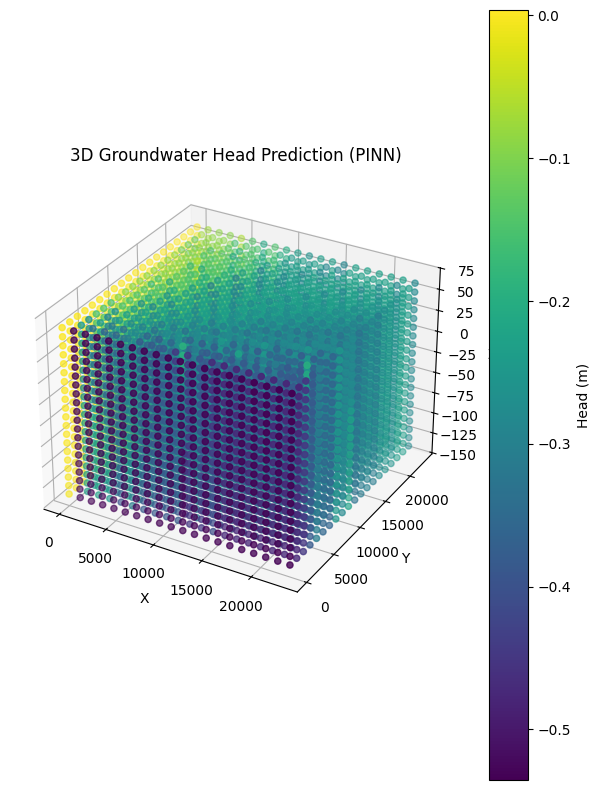

Epoch 3210: Loss = 2.5415e-06
Epoch 3220: Loss = 2.3089e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3230: Loss = 2.2966e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3240: Loss = 2.4219e-06
Epoch 3250: Loss = 2.2968e-06
Epoch 3260: Loss = 2.3665e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3270: Loss = 2.2343e-06
Epoch 3280: Loss = 2.3376e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3290: Loss = 2.2448e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_3300.pkl
Epoch 3300: Loss = 2.2160e-06
Epoch 3300: Loss = 2.2160e-06


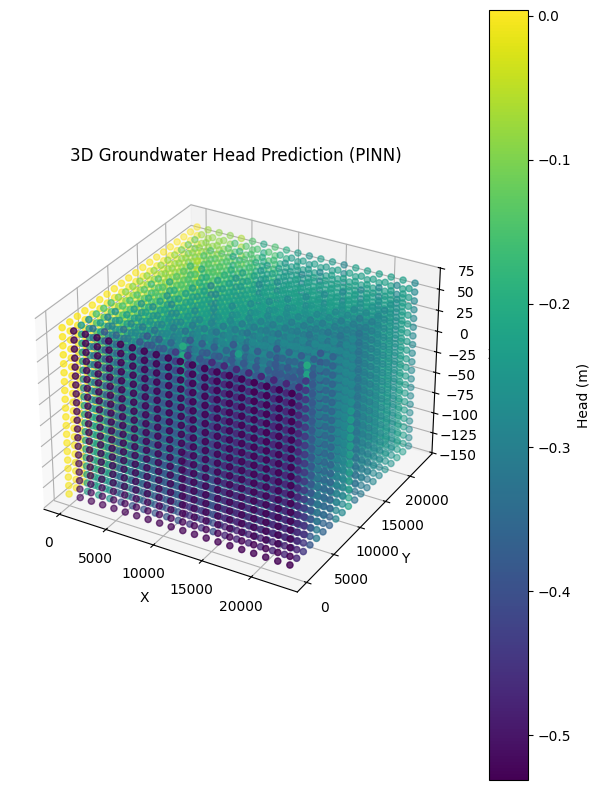

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3310: Loss = 2.1232e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3320: Loss = 2.0773e-06
Epoch 3330: Loss = 2.0496e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3340: Loss = 2.0178e-06
Epoch 3350: Loss = 1.9737e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3360: Loss = 1.9912e-06
Epoch 3370: Loss = 1.9811e-06
Epoch 3380: Loss = 1.9458e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3390: Loss = 1.9076e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_3400.pkl
Epoch 3400: Loss = 1.9250e-06
Epoch 3400: Loss

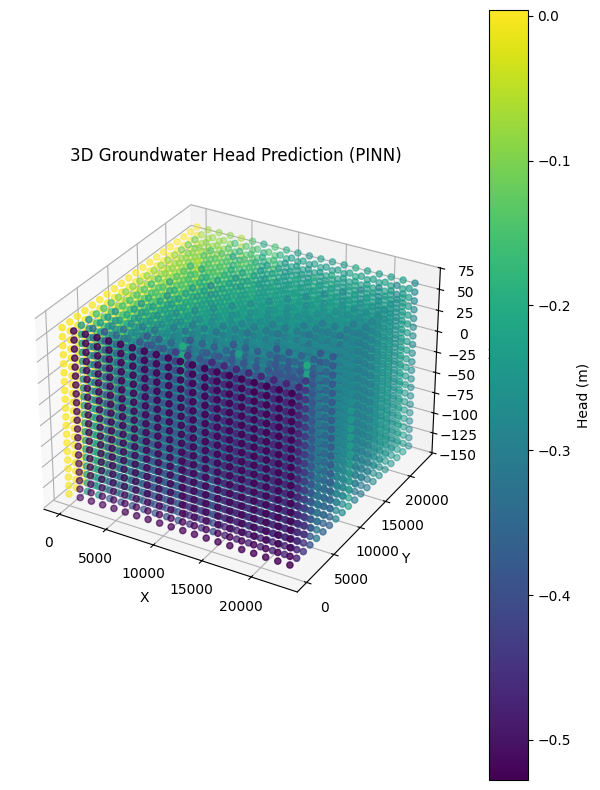

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3410: Loss = 1.8553e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3420: Loss = 1.9289e-06
Epoch 3430: Loss = 1.8714e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3440: Loss = 1.9109e-06
Epoch 3450: Loss = 1.8977e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3460: Loss = 1.7717e-06
Epoch 3470: Loss = 1.9373e-06
Epoch 3480: Loss = 1.9045e-06
Epoch 3490: Loss = 1.8811e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_3500.pkl
Epoch 3500: Loss = 1.8779e-06
Epoch 3500: Loss = 1.8779e-06


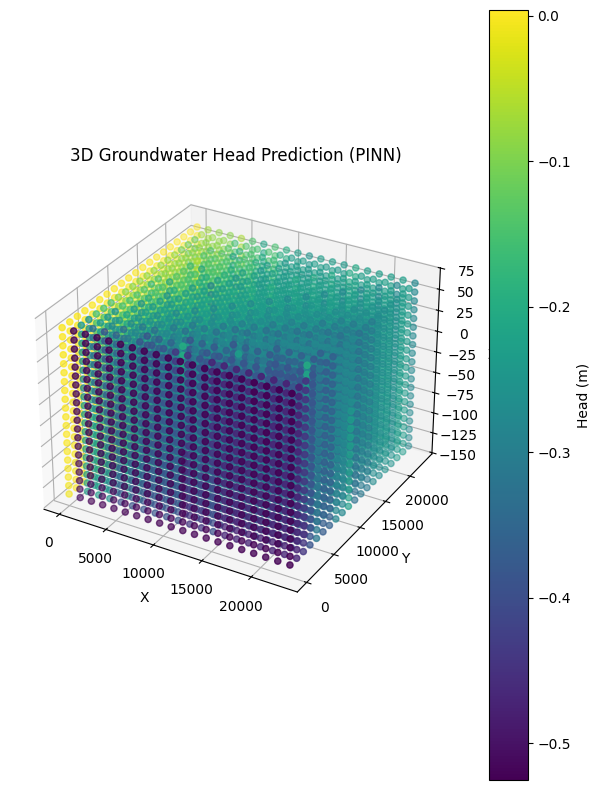

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3510: Loss = 1.7922e-06
Epoch 3520: Loss = 1.8023e-06
Epoch 3530: Loss = 1.7600e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3540: Loss = 1.7364e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3550: Loss = 1.6890e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3560: Loss = 1.6855e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3570: Loss = 1.6589e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3580: Loss = 1.6557e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3590: Loss = 1.6697e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_3600.pkl
Epoch 3600: Loss = 1.6650e-06
Epoch 3600: Loss

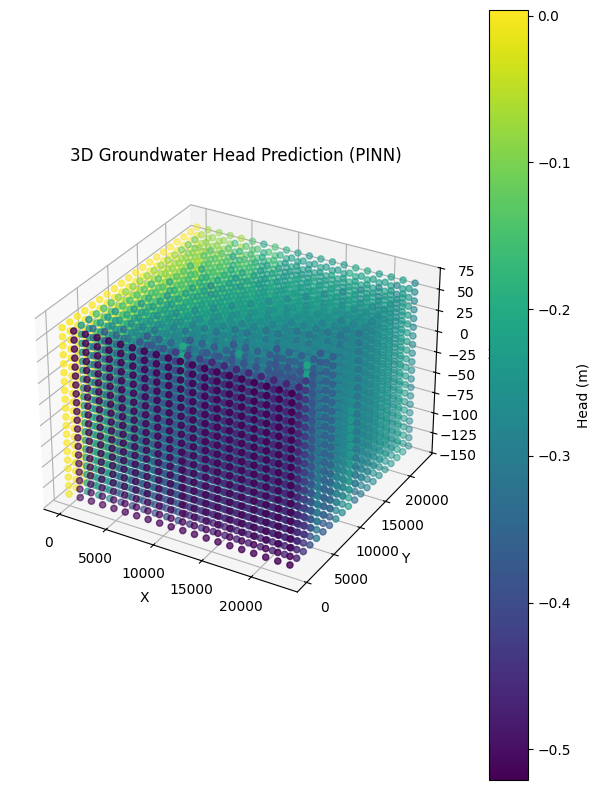

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3610: Loss = 1.6377e-06
Epoch 3620: Loss = 1.6964e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3630: Loss = 1.6695e-06
Epoch 3640: Loss = 1.6740e-06
Epoch 3650: Loss = 1.6501e-06
Epoch 3660: Loss = 1.8336e-06
Epoch 3670: Loss = 1.6600e-06
Epoch 3680: Loss = 1.6755e-06
Epoch 3690: Loss = 1.7803e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_3700.pkl
Epoch 3700: Loss = 1.6369e-06
Epoch 3700: Loss = 1.6369e-06


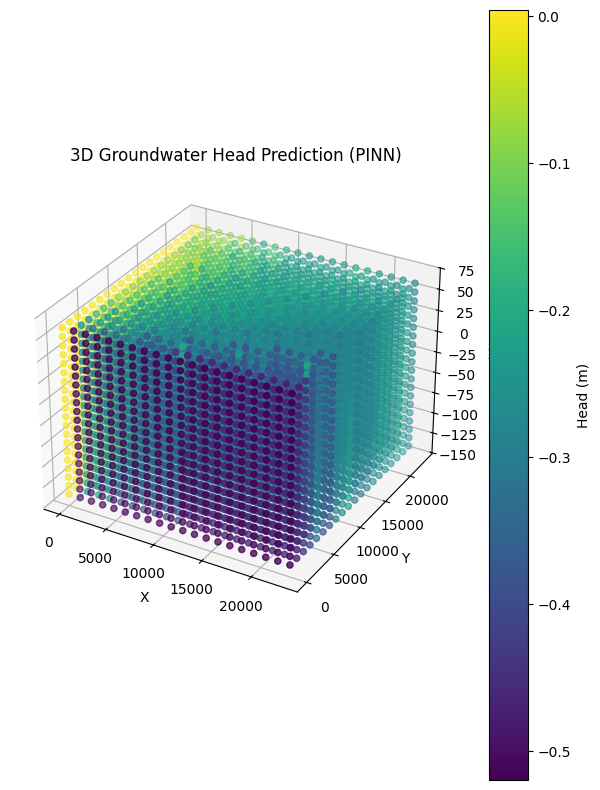

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3710: Loss = 1.6011e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3720: Loss = 1.6131e-06
Epoch 3730: Loss = 1.5784e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3740: Loss = 1.5800e-06
Epoch 3750: Loss = 1.6539e-06
Epoch 3760: Loss = 1.7885e-06
Epoch 3770: Loss = 1.8009e-06
Epoch 3780: Loss = 1.7305e-06
Epoch 3790: Loss = 1.7717e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_3800.pkl
Epoch 3800: Loss = 1.6173e-06
Epoch 3800: Loss = 1.6173e-06


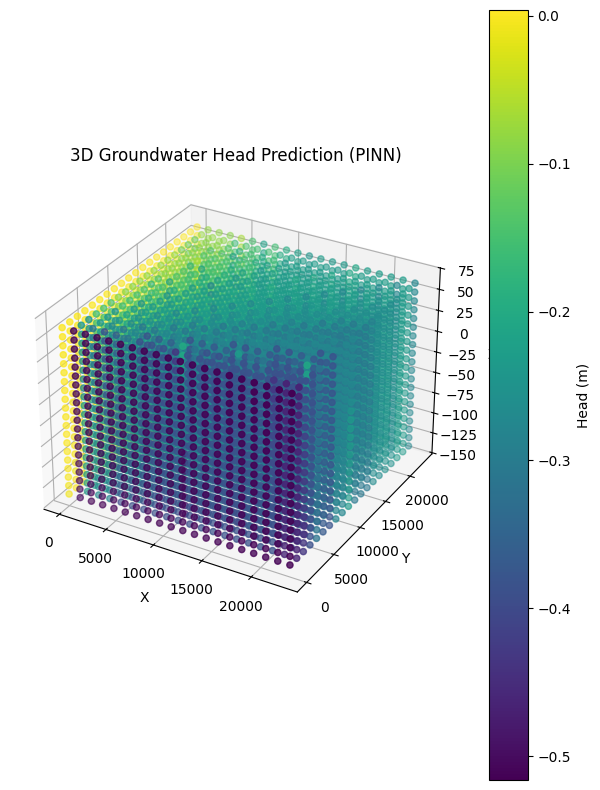

Epoch 3810: Loss = 1.5604e-06
Epoch 3820: Loss = 1.5478e-06
Epoch 3830: Loss = 1.5615e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3840: Loss = 1.5428e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3850: Loss = 1.5316e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3860: Loss = 1.5014e-06
Epoch 3870: Loss = 1.4780e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3880: Loss = 1.4673e-06
Epoch 3890: Loss = 1.5063e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_3900.pkl
Epoch 3900: Loss = 1.3998e-06
Epoch 3900: Loss = 1.3998e-06


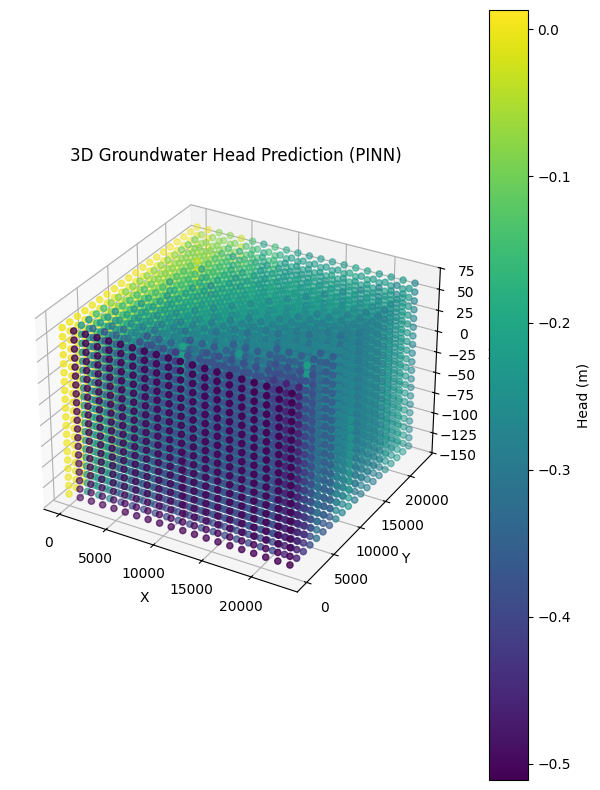

Epoch 3910: Loss = 1.4267e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3920: Loss = 1.4135e-06
Epoch 3930: Loss = 1.4290e-06
Epoch 3940: Loss = 1.5709e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 3950: Loss = 1.4844e-06
Epoch 3960: Loss = 1.4996e-06
Epoch 3970: Loss = 1.4590e-06
Epoch 3980: Loss = 1.6561e-06
Epoch 3990: Loss = 1.9692e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_4000.pkl
Epoch 4000: Loss = 1.6603e-06
Epoch 4000: Loss = 1.6603e-06


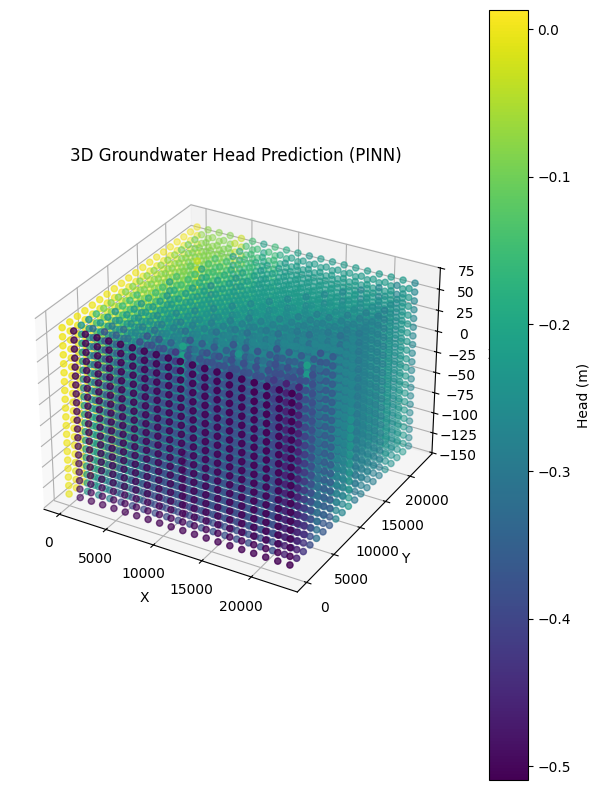

Epoch 4010: Loss = 1.5217e-06
Epoch 4020: Loss = 1.4770e-06
Epoch 4030: Loss = 1.4746e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4040: Loss = 1.3243e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4050: Loss = 1.3025e-06
Epoch 4060: Loss = 1.3706e-06
Epoch 4070: Loss = 1.3165e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4080: Loss = 1.2618e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4090: Loss = 1.2221e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_4100.pkl
Epoch 4100: Loss = 1.2257e-06
Epoch 4100: Loss

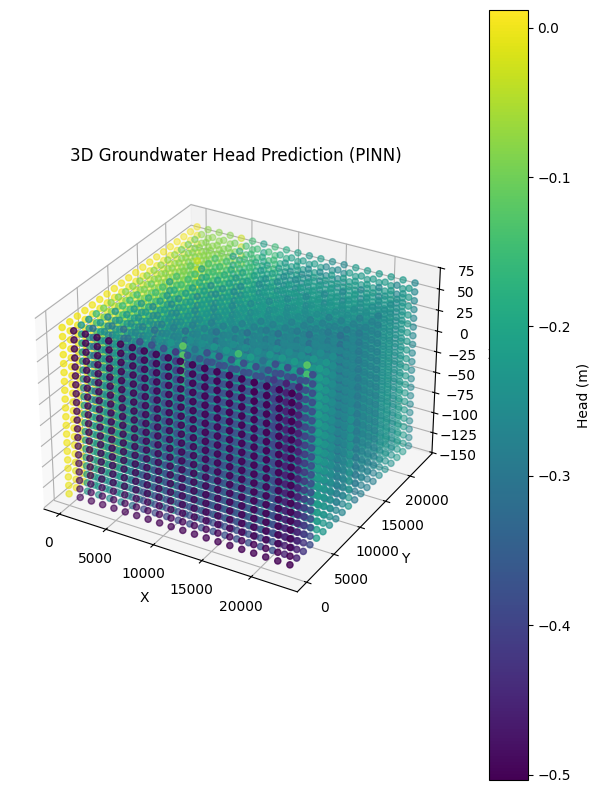

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4110: Loss = 1.2004e-06
Epoch 4120: Loss = 1.1921e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4130: Loss = 1.2515e-06
Epoch 4140: Loss = 1.2813e-06
Epoch 4150: Loss = 1.2507e-06
Epoch 4160: Loss = 1.2090e-06
Epoch 4170: Loss = 1.2462e-06
Epoch 4180: Loss = 1.2614e-06
Epoch 4190: Loss = 1.2043e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_4200.pkl
Epoch 4200: Loss = 1.2142e-06
Epoch 4200: Loss = 1.2142e-06


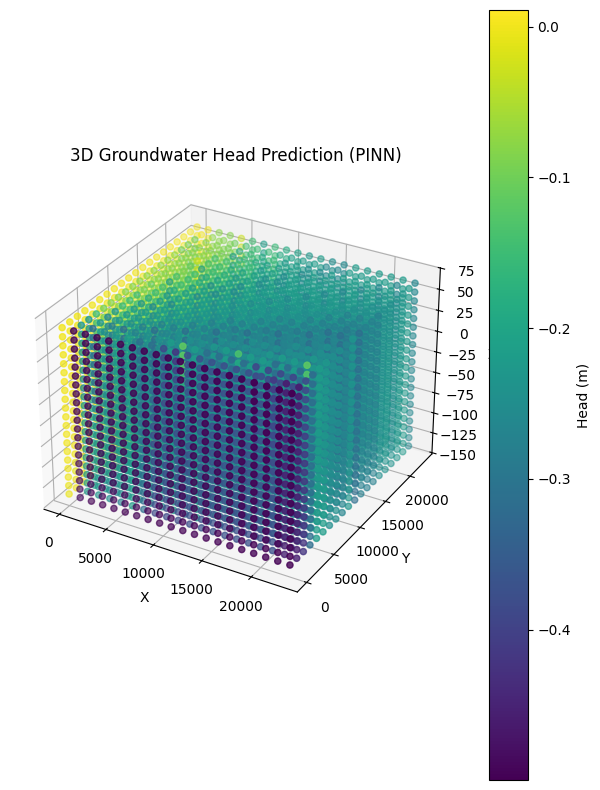

Epoch 4210: Loss = 1.3419e-06
Epoch 4220: Loss = 1.2251e-06
Epoch 4230: Loss = 1.4100e-06
Epoch 4240: Loss = 1.3000e-06
Epoch 4250: Loss = 1.3150e-06
Epoch 4260: Loss = 1.1736e-06
Epoch 4270: Loss = 1.1913e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4280: Loss = 1.1629e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4290: Loss = 1.2072e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_4300.pkl
Epoch 4300: Loss = 1.1868e-06
Epoch 4300: Loss = 1.1868e-06


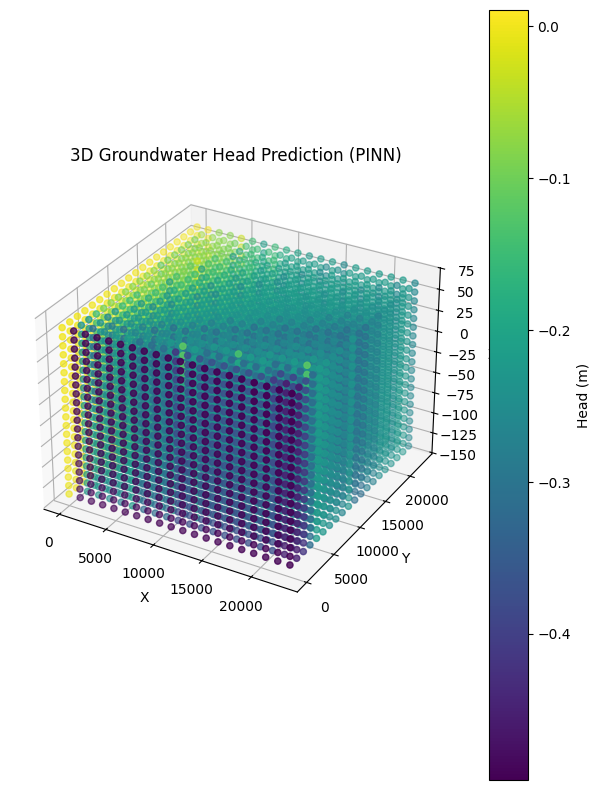

Epoch 4310: Loss = 1.1886e-06
Epoch 4320: Loss = 1.2309e-06
Epoch 4330: Loss = 1.1844e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4340: Loss = 1.1627e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4350: Loss = 1.0701e-06
Epoch 4360: Loss = 1.1272e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4370: Loss = 1.1338e-06
Epoch 4380: Loss = 1.8927e-06
Epoch 4390: Loss = 3.4322e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_4400.pkl
Epoch 4400: Loss = 8.8001e-04
Epoch 4400: Loss = 8.8001e-04


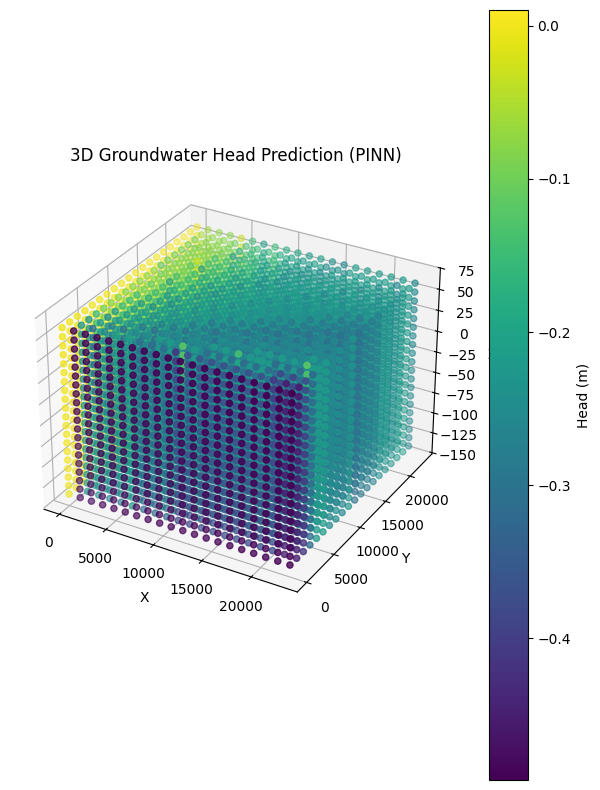

Epoch 4410: Loss = 2.0964e-04
Epoch 4420: Loss = 6.2856e-05
Epoch 4430: Loss = 7.7789e-06
Epoch 4440: Loss = 1.1817e-06
Epoch 4450: Loss = 1.5644e-06
Epoch 4460: Loss = 1.8303e-06
Epoch 4470: Loss = 1.5509e-06
Epoch 4480: Loss = 1.1863e-06
Epoch 4490: Loss = 1.0811e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_4500.pkl
Epoch 4500: Loss = 1.0865e-06
Epoch 4500: Loss = 1.0865e-06


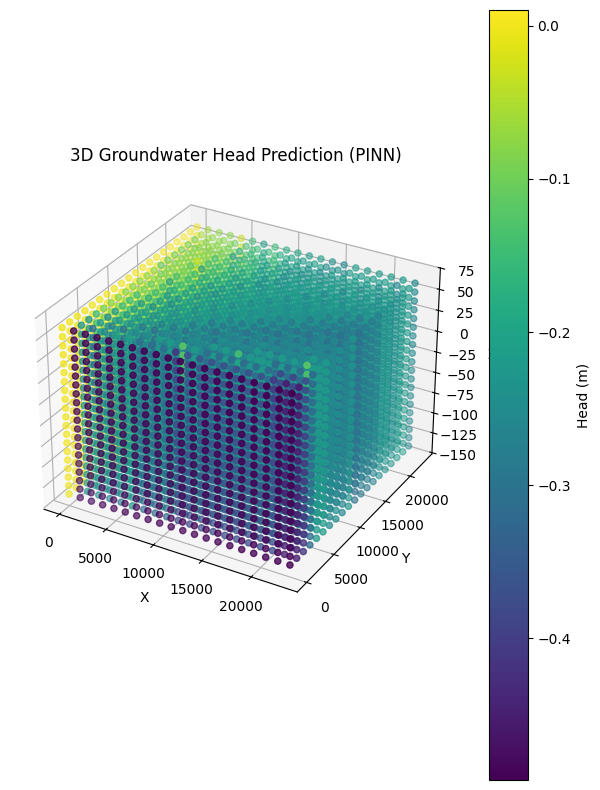

Epoch 4510: Loss = 1.0721e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4520: Loss = 1.0867e-06
Epoch 4530: Loss = 1.0637e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4540: Loss = 1.0857e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4550: Loss = 1.0822e-06
Epoch 4560: Loss = 1.0590e-06
Epoch 4570: Loss = 1.0447e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4580: Loss = 1.0565e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4590: Loss = 1.0639e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_4600.pkl
Epoch 4600: Loss = 1.0279e-06
Epoch 4600: Loss = 1.0279e-06


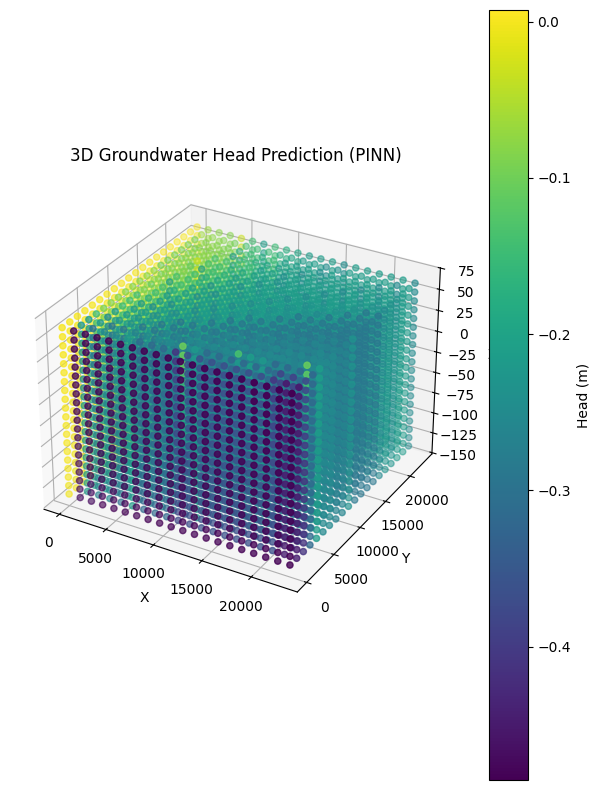

Epoch 4610: Loss = 1.0217e-06
Epoch 4620: Loss = 1.0677e-06
Epoch 4630: Loss = 1.0419e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4640: Loss = 1.0327e-06
Epoch 4650: Loss = 1.0823e-06
Epoch 4660: Loss = 1.0585e-06
Epoch 4670: Loss = 1.0223e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4680: Loss = 1.0455e-06
Epoch 4690: Loss = 1.0682e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_4700.pkl
Epoch 4700: Loss = 1.0275e-06
Epoch 4700: Loss = 1.0275e-06


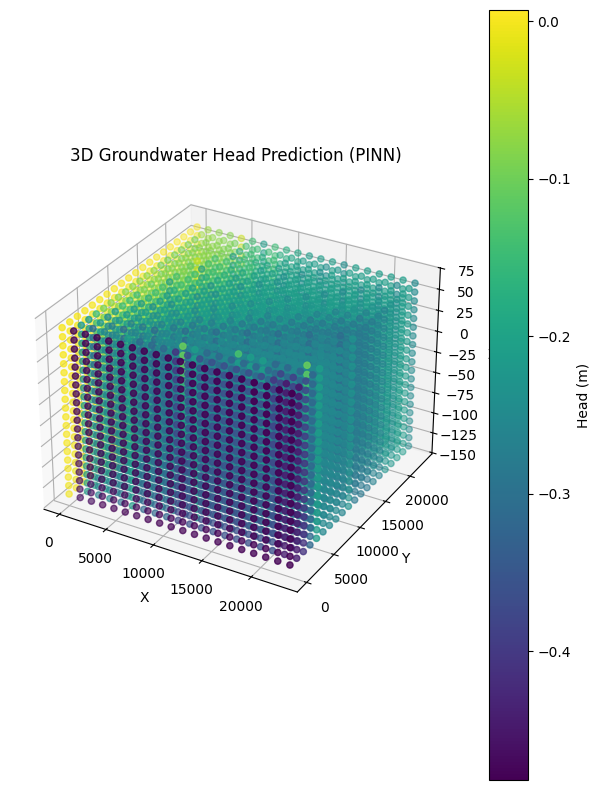

Epoch 4710: Loss = 1.0103e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4720: Loss = 9.4023e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4730: Loss = 9.3837e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4740: Loss = 9.5905e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4750: Loss = 9.1945e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4760: Loss = 9.0564e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /cont

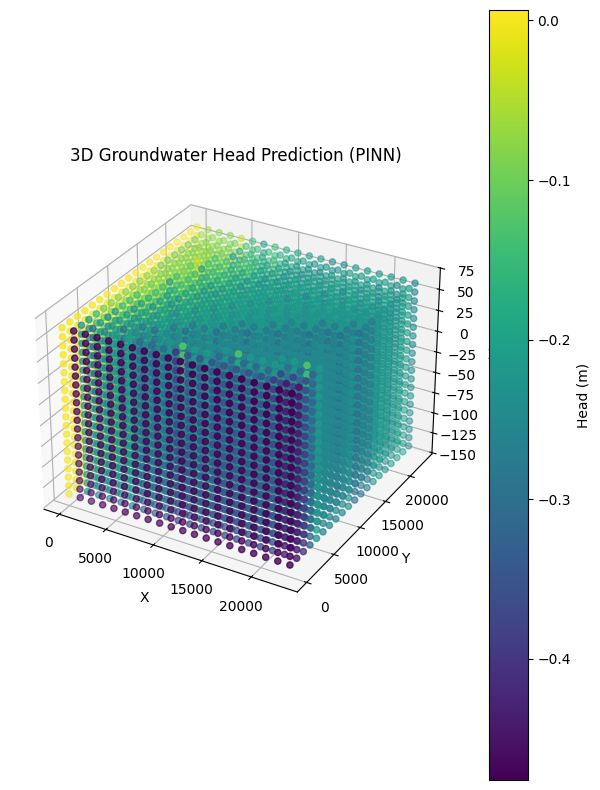

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4810: Loss = 8.6919e-07
Epoch 4820: Loss = 8.7185e-07
Epoch 4830: Loss = 1.0142e-06
Epoch 4840: Loss = 3.0132e-06
Epoch 4850: Loss = 6.7099e-05
Epoch 4860: Loss = 5.2727e-04
Epoch 4870: Loss = 4.9148e-05
Epoch 4880: Loss = 3.4239e-05
Epoch 4890: Loss = 1.3590e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_4900.pkl
Epoch 4900: Loss = 5.9269e-06
Epoch 4900: Loss = 5.9269e-06


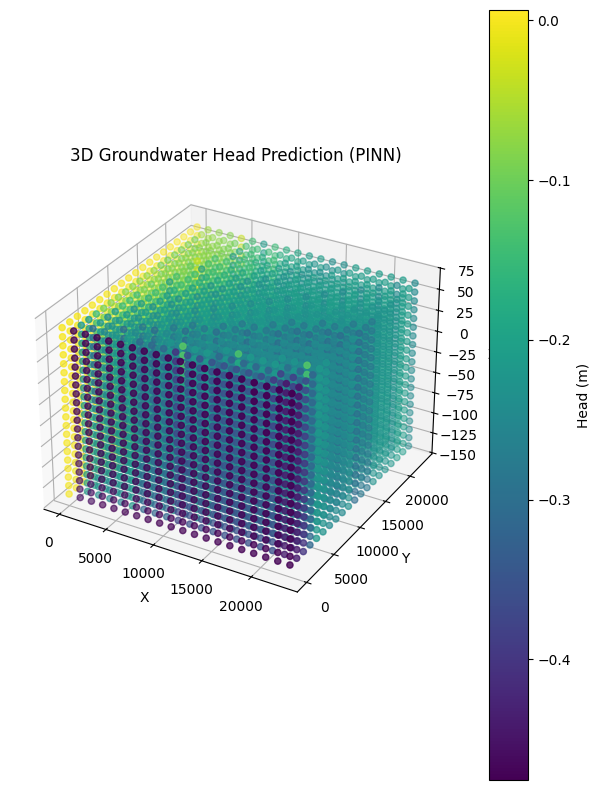

Epoch 4910: Loss = 1.5685e-06
Epoch 4920: Loss = 1.1285e-06
Epoch 4930: Loss = 1.1120e-06
Epoch 4940: Loss = 8.9168e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4950: Loss = 9.2803e-07
Epoch 4960: Loss = 9.0483e-07
Epoch 4970: Loss = 9.3047e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4980: Loss = 8.3575e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 4990: Loss = 8.5540e-07
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_5000.pkl
Epoch 5000: Loss = 9.5326e-07
Epoch 5000: Loss = 9.5326e-07


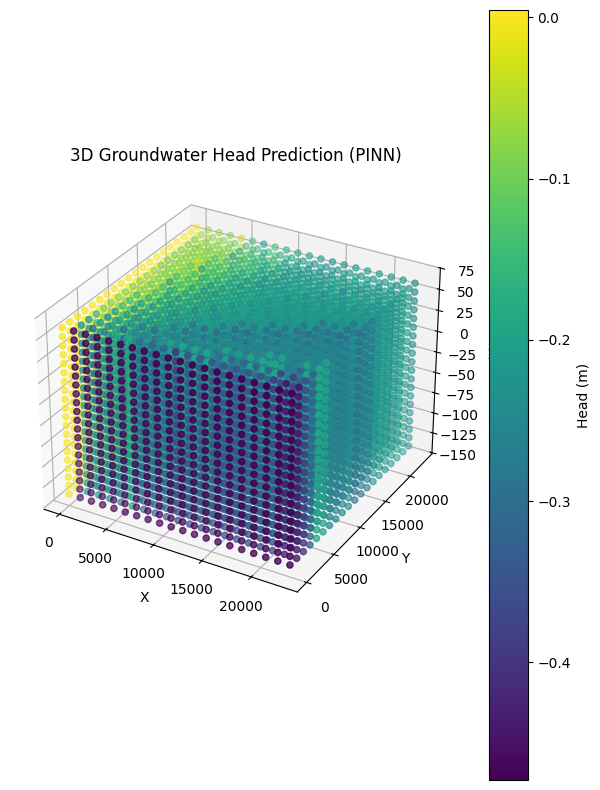

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5010: Loss = 8.3547e-07
Epoch 5020: Loss = 8.6326e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5030: Loss = 8.3263e-07
Epoch 5040: Loss = 8.3597e-07
Epoch 5050: Loss = 8.2249e-07
Epoch 5060: Loss = 8.2472e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5070: Loss = 7.8892e-07
Epoch 5080: Loss = 7.9095e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5090: Loss = 7.7696e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_

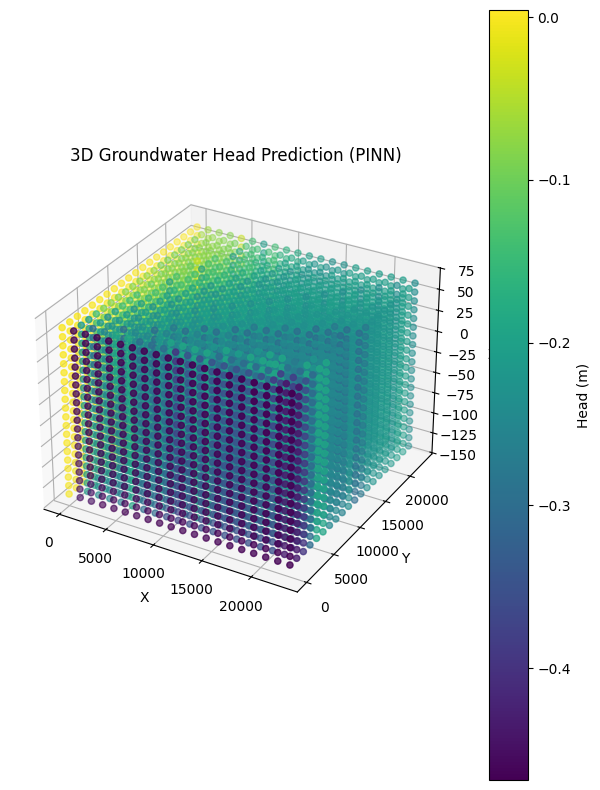

Epoch 5110: Loss = 7.8161e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5120: Loss = 7.8523e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5130: Loss = 7.7282e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5140: Loss = 7.5777e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5150: Loss = 7.4817e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5160: Loss = 7.3986e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /cont

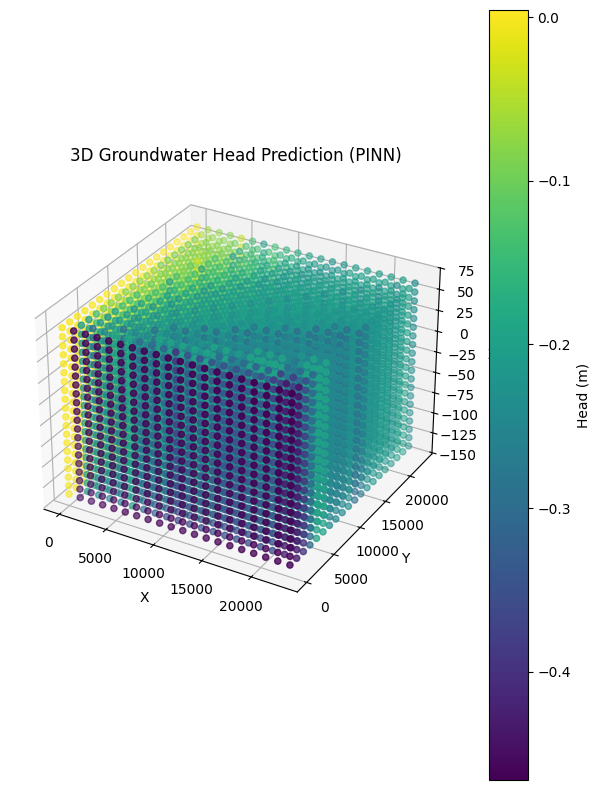

Epoch 5210: Loss = 7.3291e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5220: Loss = 7.1536e-07
Epoch 5230: Loss = 7.1392e-07
Epoch 5240: Loss = 7.1910e-07
Epoch 5250: Loss = 9.4107e-07
Epoch 5260: Loss = 4.6917e-06
Epoch 5270: Loss = 8.3599e-05
Epoch 5280: Loss = 2.1408e-04
Epoch 5290: Loss = 3.1244e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_5300.pkl
Epoch 5300: Loss = 2.5169e-06
Epoch 5300: Loss = 2.5169e-06


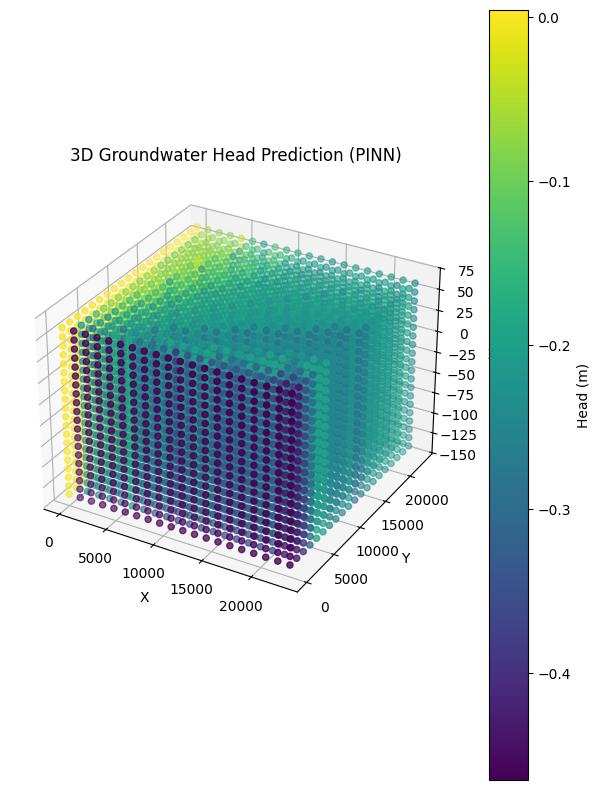

Epoch 5310: Loss = 8.6814e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5320: Loss = 1.4805e-06
Epoch 5330: Loss = 9.7710e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5340: Loss = 1.0425e-06
Epoch 5350: Loss = 7.6191e-07
Epoch 5360: Loss = 7.0747e-07
Epoch 5370: Loss = 7.3431e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5380: Loss = 6.9147e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5390: Loss = 6.5878e-07
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_5400.pkl
Epoch 5400: Loss = 6.5193e-07
Epoch 5400: Loss = 6.5193e-07


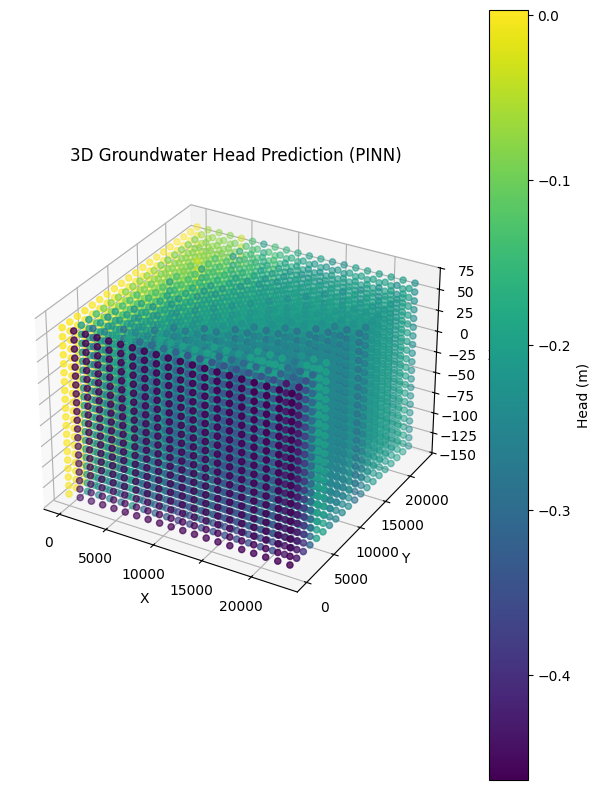

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5410: Loss = 6.5616e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5420: Loss = 6.4187e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5430: Loss = 6.3326e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params

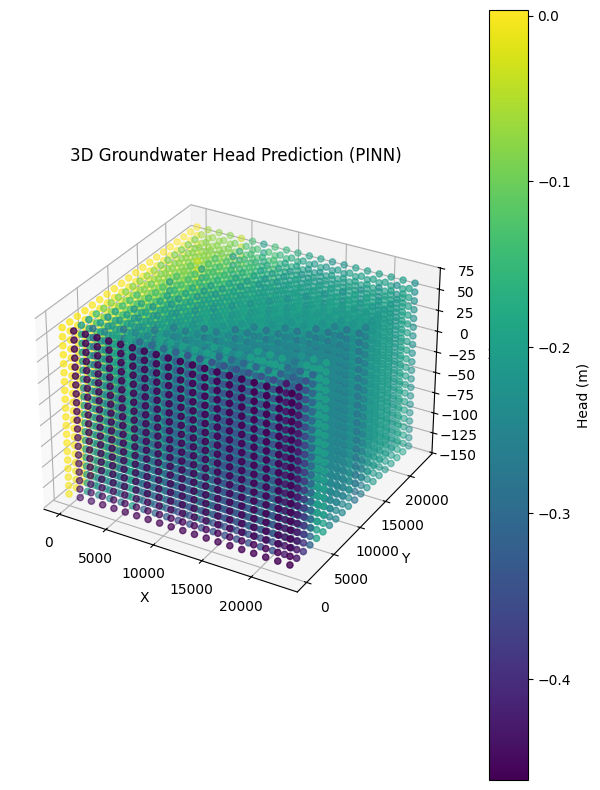

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5510: Loss = 6.0383e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5520: Loss = 6.0113e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5530: Loss = 6.0007e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params

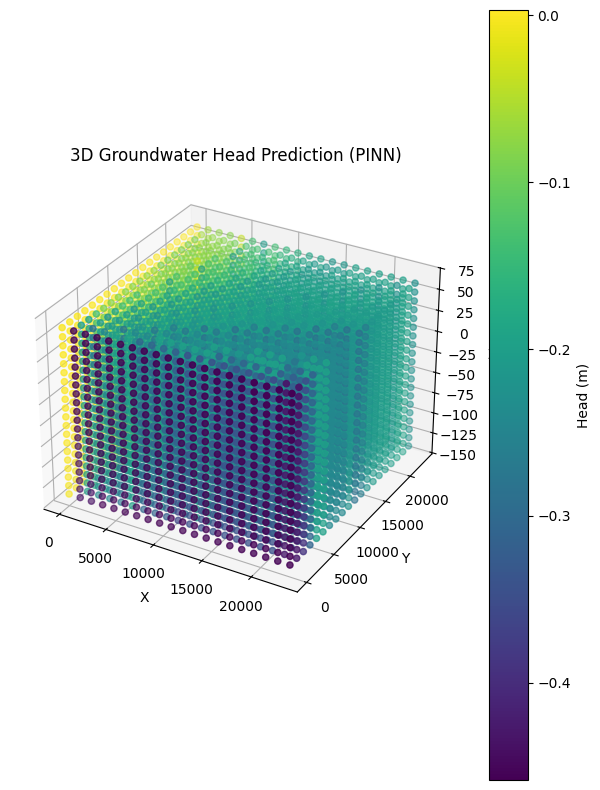

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5610: Loss = 5.8374e-07
Epoch 5620: Loss = 5.8956e-07
Epoch 5630: Loss = 6.6649e-07
Epoch 5640: Loss = 2.2039e-06
Epoch 5650: Loss = 3.8584e-05
Epoch 5660: Loss = 2.8691e-04
Epoch 5670: Loss = 7.6622e-05
Epoch 5680: Loss = 5.2922e-06
Epoch 5690: Loss = 4.2511e-06
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_5700.pkl
Epoch 5700: Loss = 3.2808e-06
Epoch 5700: Loss = 3.2808e-06


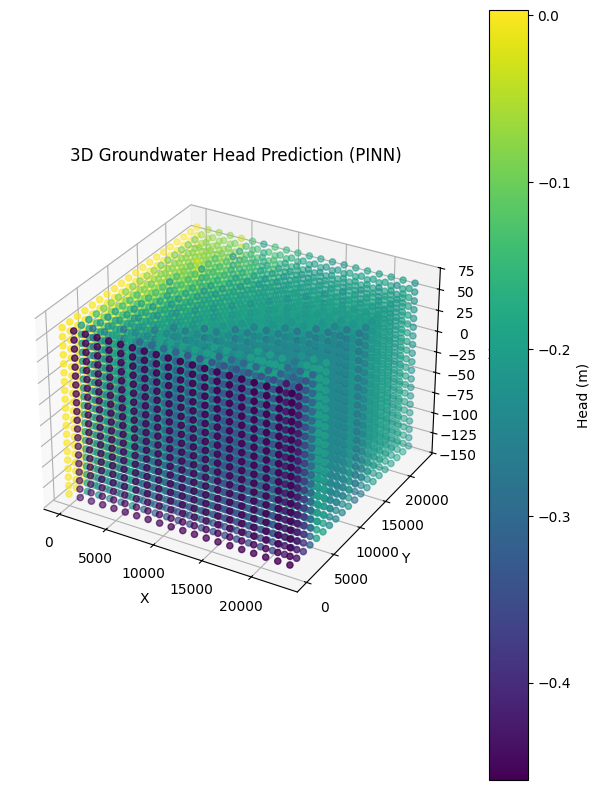

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5710: Loss = 5.7145e-07
Epoch 5720: Loss = 8.4285e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5730: Loss = 6.5966e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5740: Loss = 5.5451e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5750: Loss = 5.6006e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5760: Loss = 5.5534e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5770: Loss = 5.4795e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.p

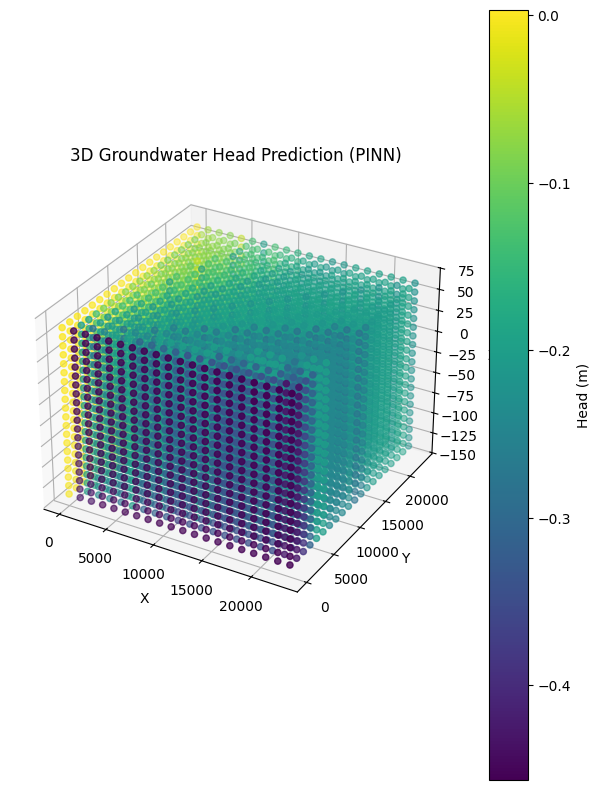

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5810: Loss = 5.3784e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

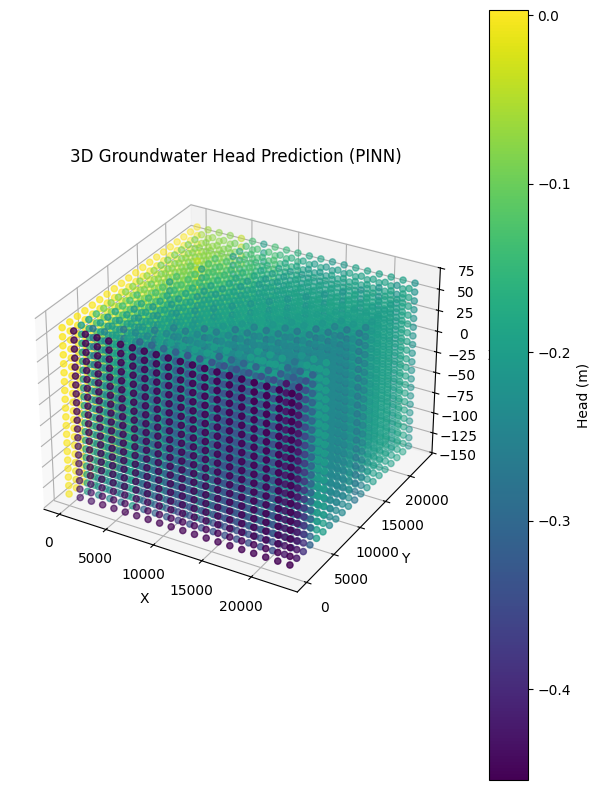

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 5910: Loss = 5.1570e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

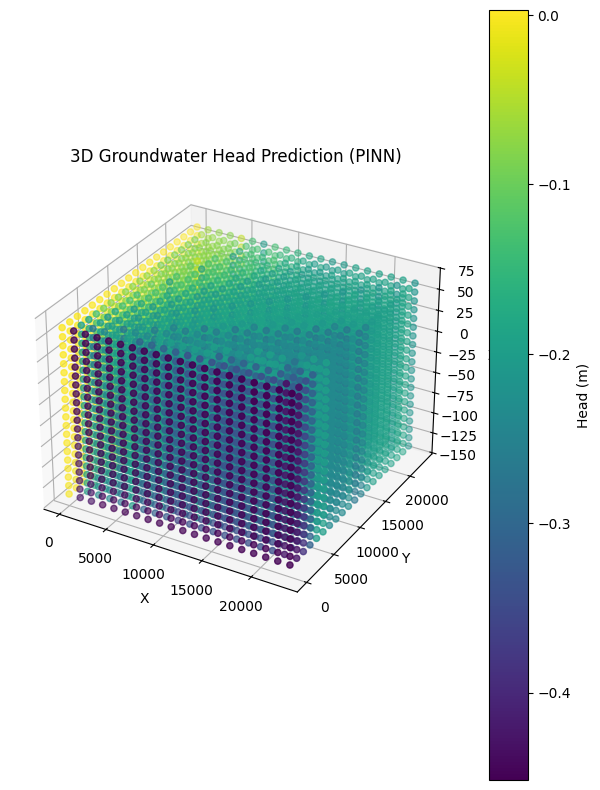

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6010: Loss = 4.9491e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

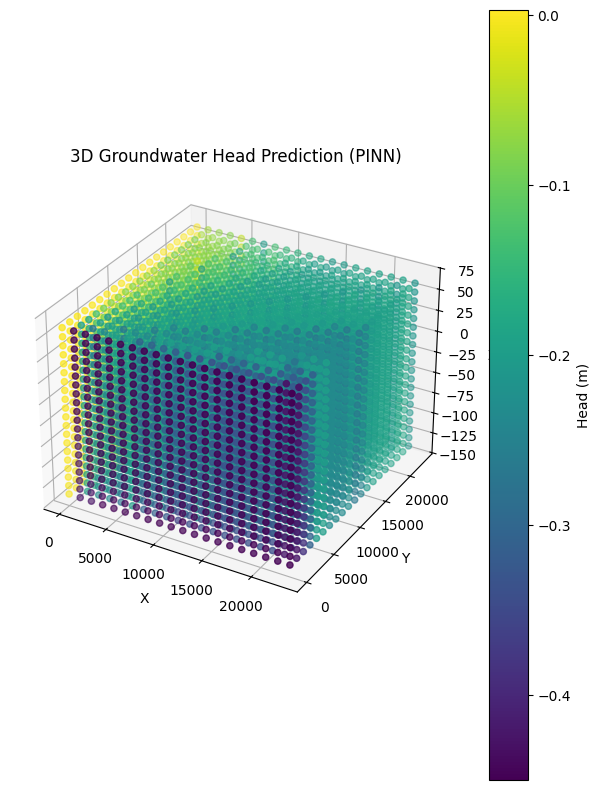

Epoch 6110: Loss = 8.0643e-06
Epoch 6120: Loss = 8.5074e-05
Epoch 6130: Loss = 1.3973e-05
Epoch 6140: Loss = 6.5854e-06
Epoch 6150: Loss = 1.6738e-06
Epoch 6160: Loss = 5.8410e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6170: Loss = 4.7190e-07
Epoch 6180: Loss = 4.7518e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6190: Loss = 4.7266e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_6200.pkl
Epoch 6200: Loss = 4.6789e-07
Epoch 6200: Loss = 4.6789e-07


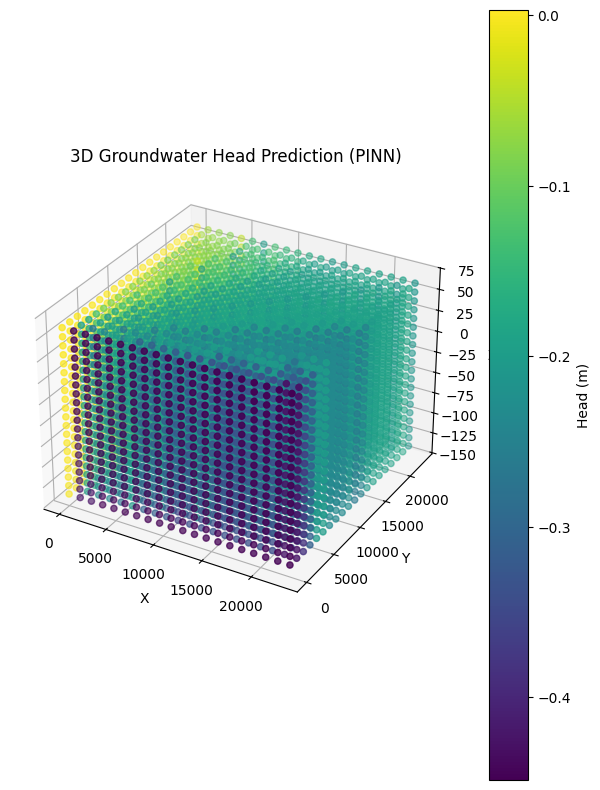

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6210: Loss = 4.6463e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6220: Loss = 4.6257e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6230: Loss = 4.6090e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6240: Loss = 4.5916e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /con

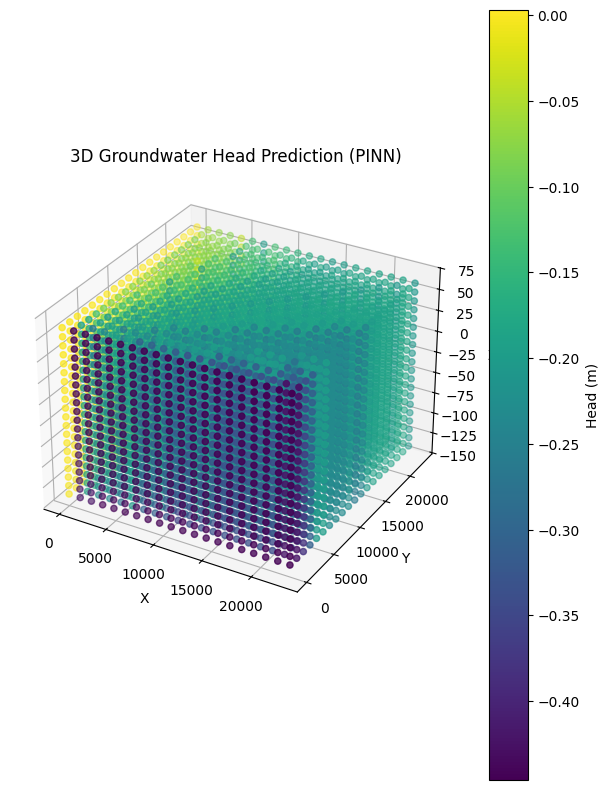

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6310: Loss = 4.4735e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

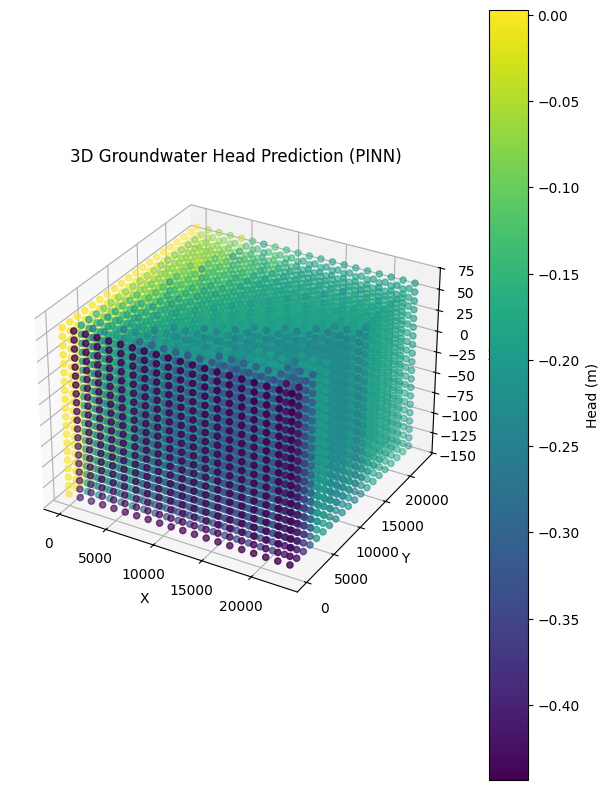

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6410: Loss = 4.3205e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

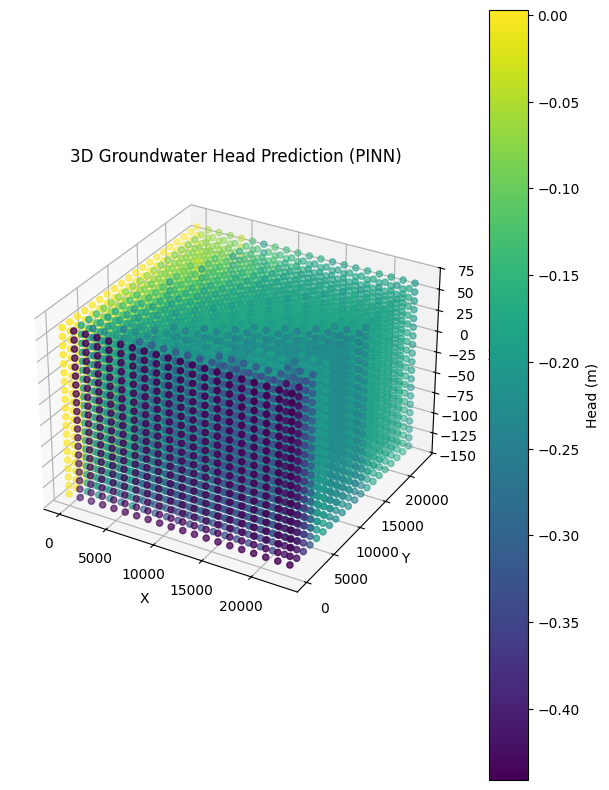

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6510: Loss = 4.1786e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

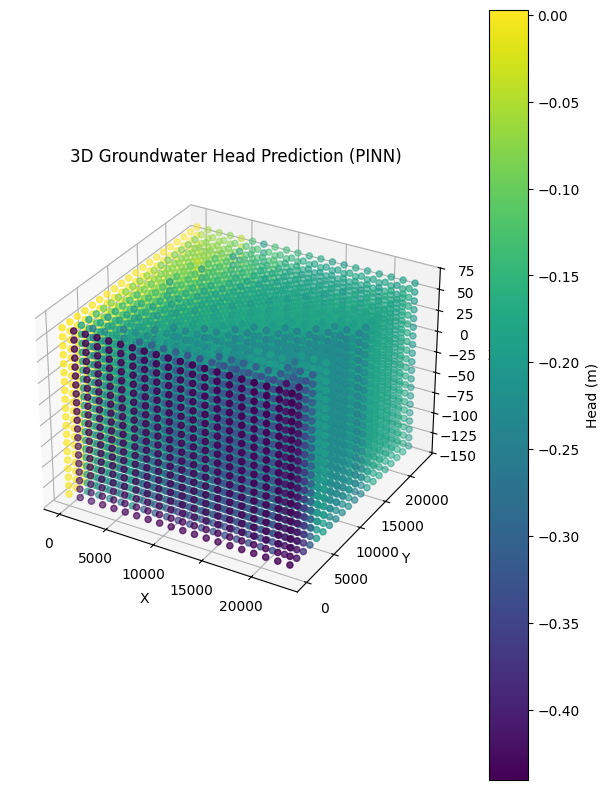

Epoch 6610: Loss = 4.1476e-06
Epoch 6620: Loss = 1.6204e-06
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6630: Loss = 7.3576e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6640: Loss = 4.6872e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6650: Loss = 4.0857e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6660: Loss = 4.0043e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6670: Loss = 4.0022e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6680: Loss = 3.9940e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /conte

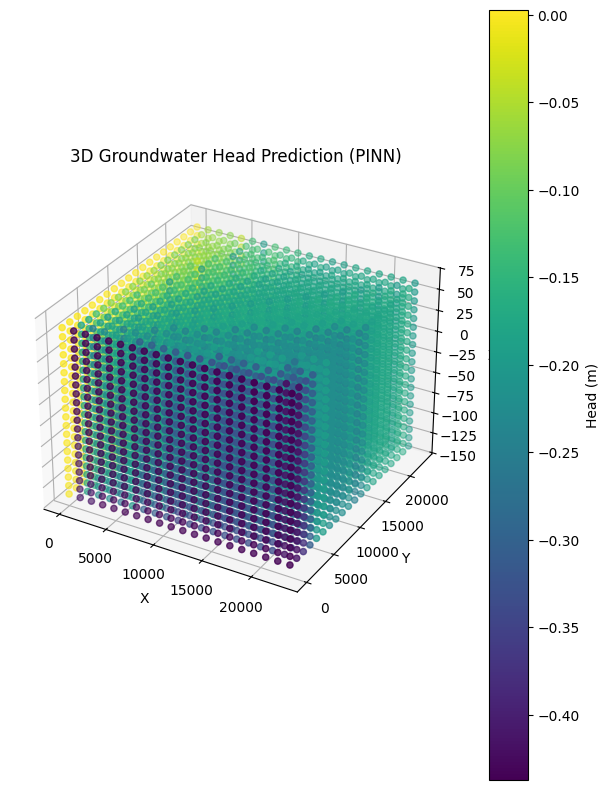

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6710: Loss = 3.9407e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

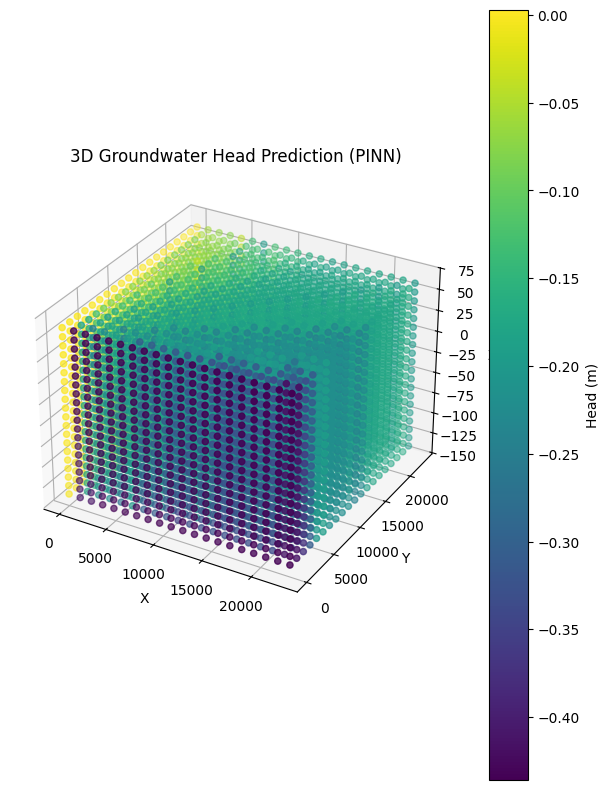

Epoch 6810: Loss = 3.8906e-07
Epoch 6820: Loss = 3.8530e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6830: Loss = 3.8235e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6840: Loss = 3.7776e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6850: Loss = 3.7592e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.

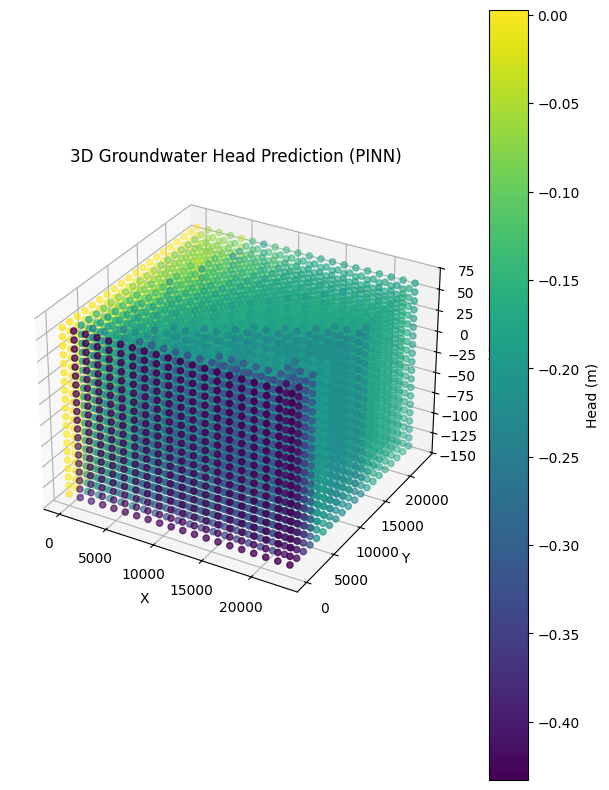

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 6910: Loss = 3.6946e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

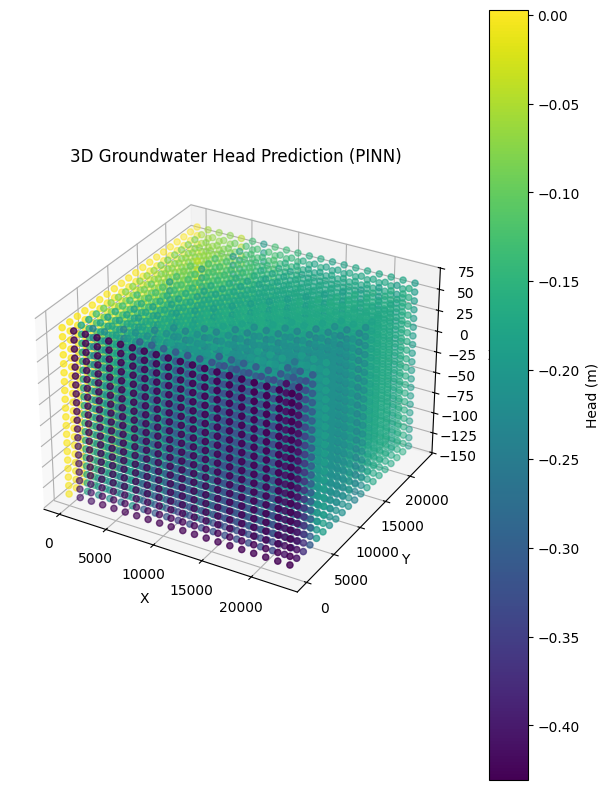

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 7010: Loss = 3.5931e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

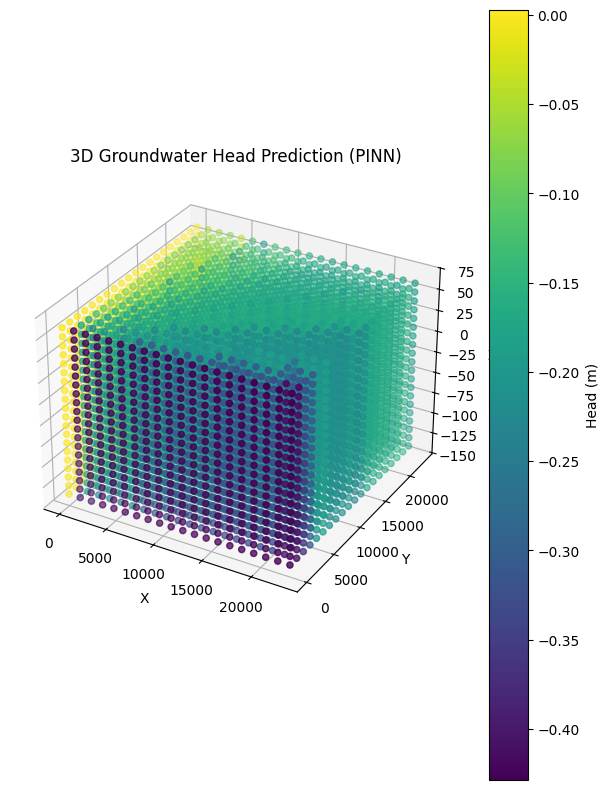

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 7110: Loss = 3.4982e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

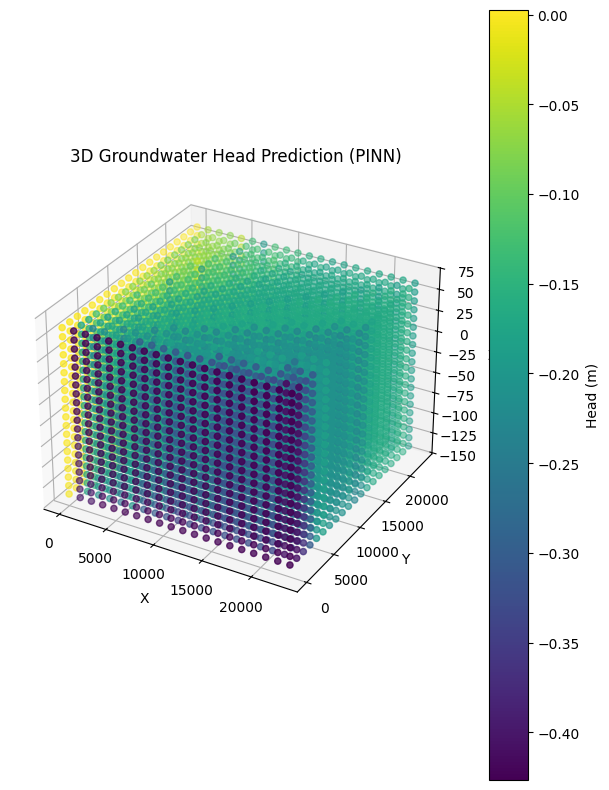

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 7210: Loss = 3.4085e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

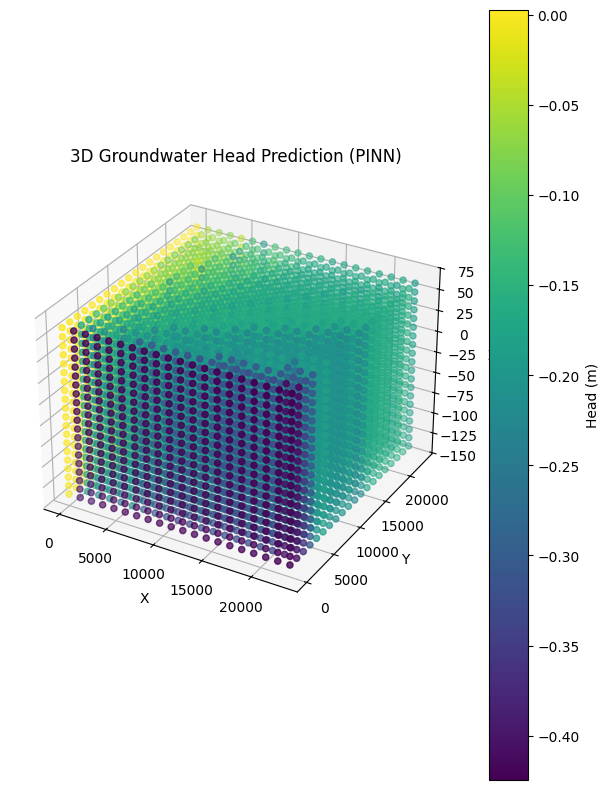

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 7310: Loss = 3.3229e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

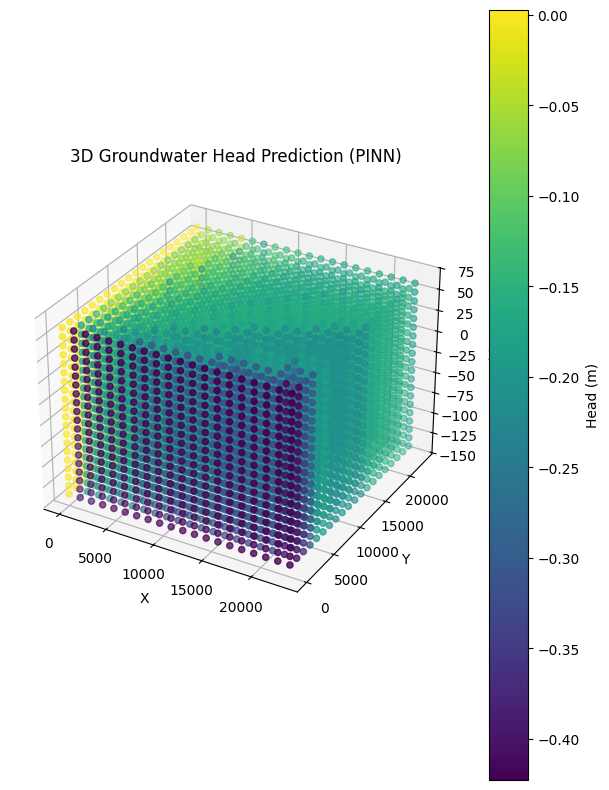

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 7410: Loss = 3.2432e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

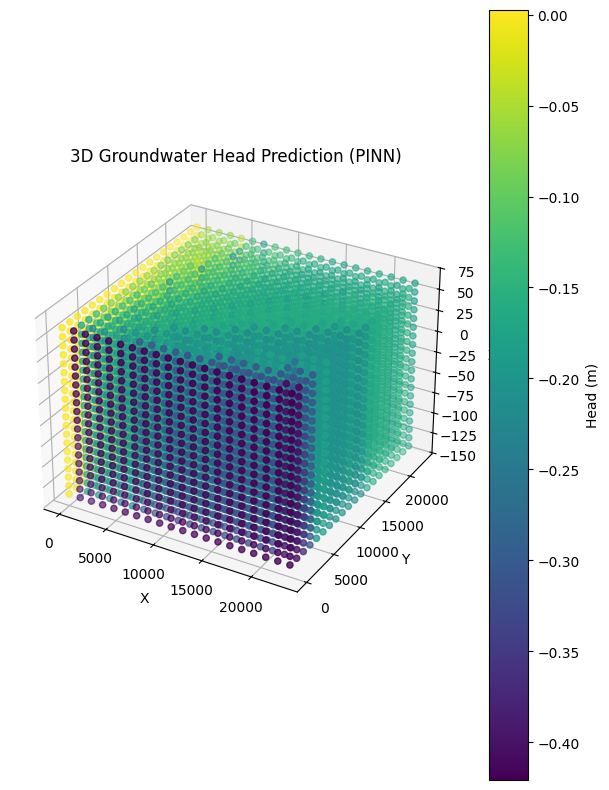

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 7510: Loss = 3.1677e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

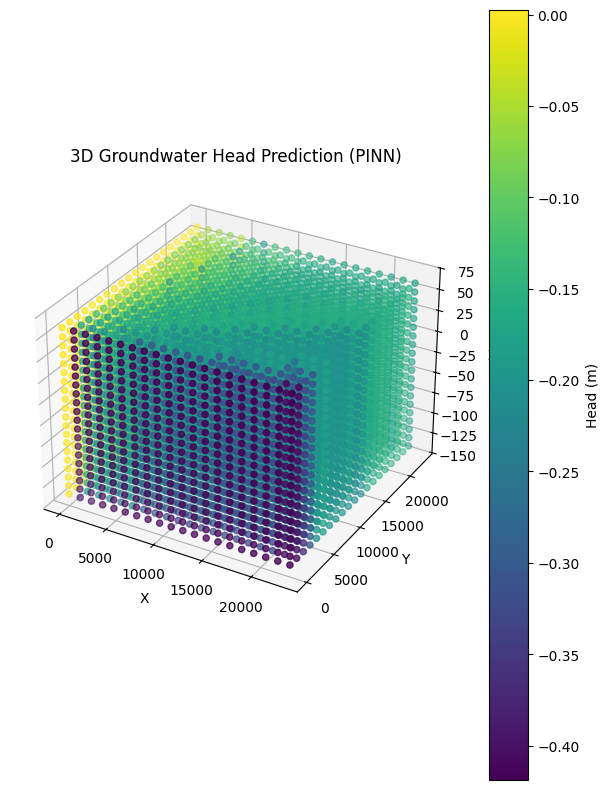

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 7610: Loss = 3.0964e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

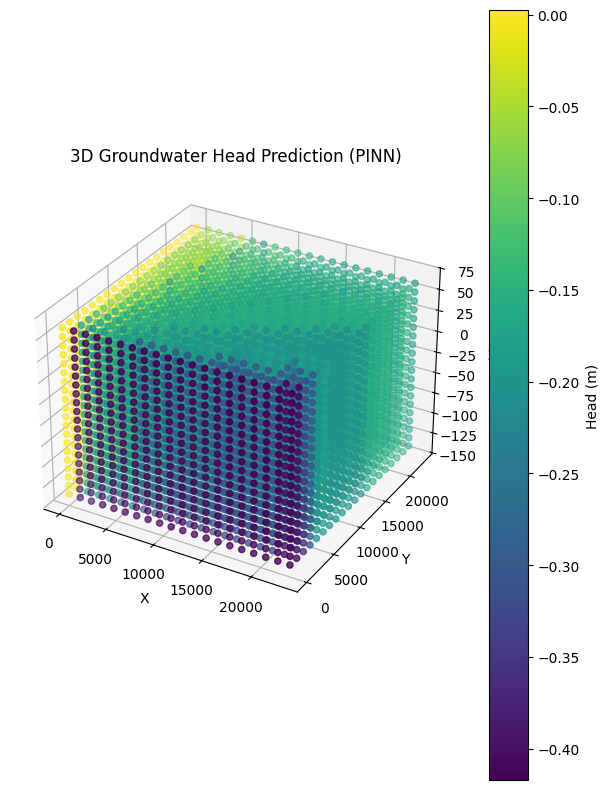

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 7710: Loss = 3.0293e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

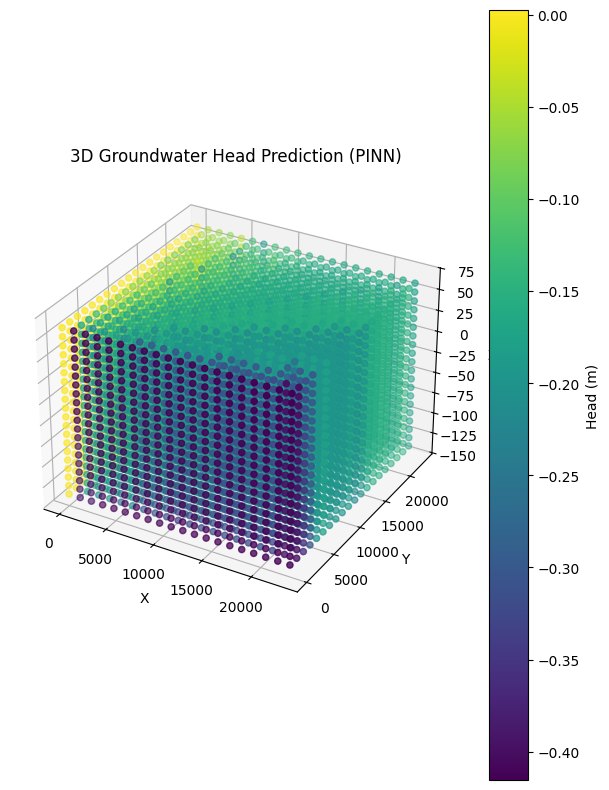

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 7810: Loss = 2.9661e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

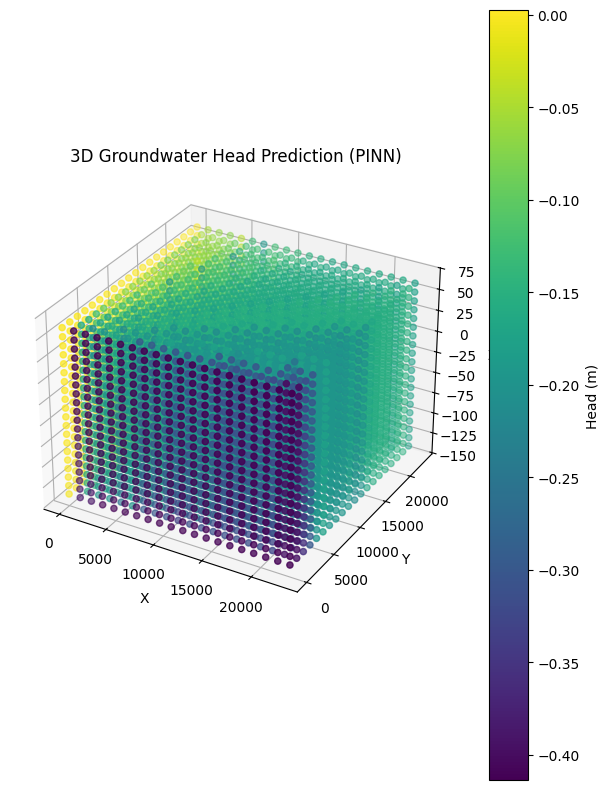

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 7910: Loss = 2.9054e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

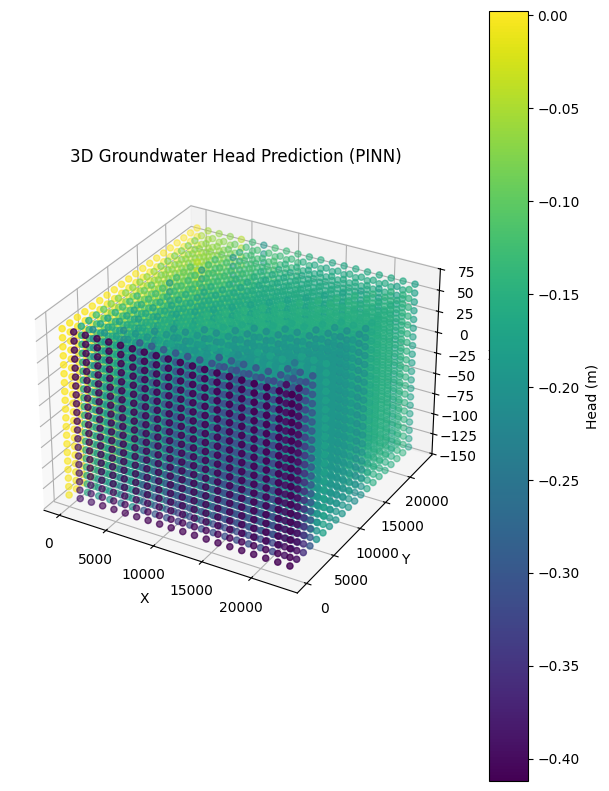

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 8010: Loss = 2.8488e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

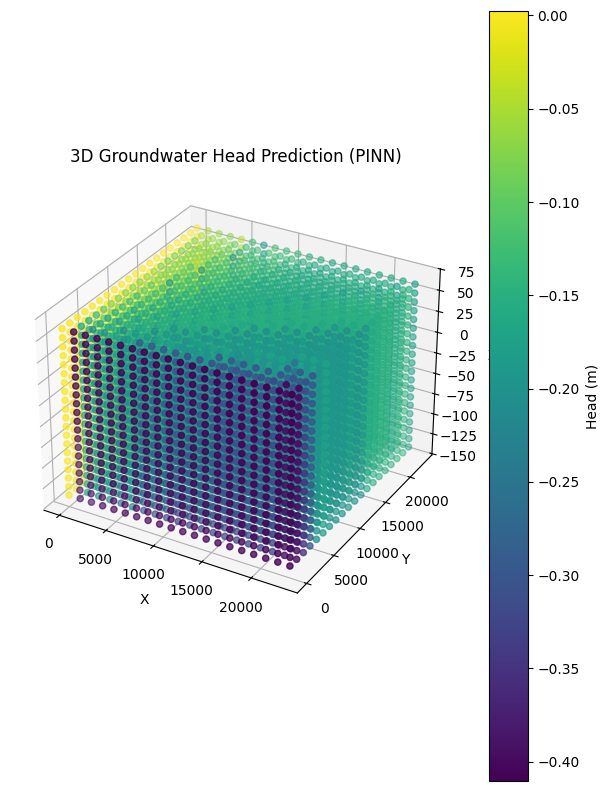

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 8110: Loss = 2.7954e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

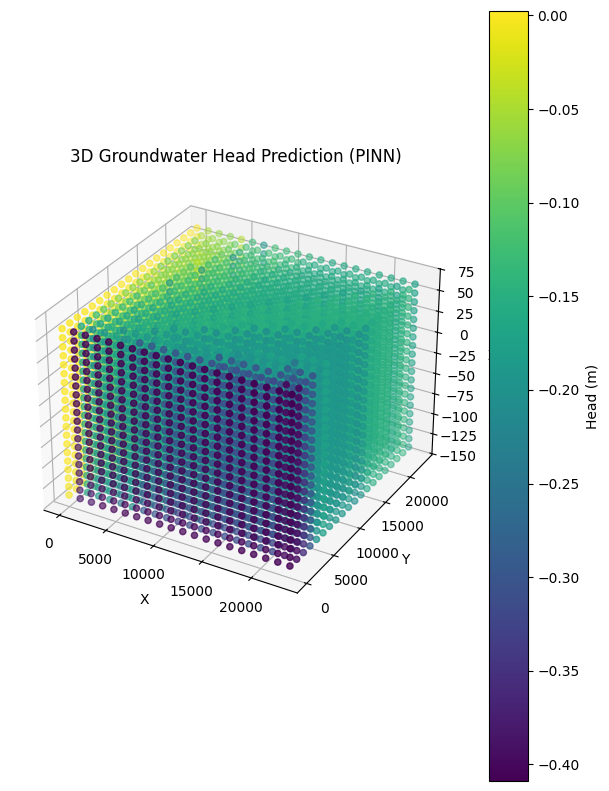

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 8210: Loss = 2.7447e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

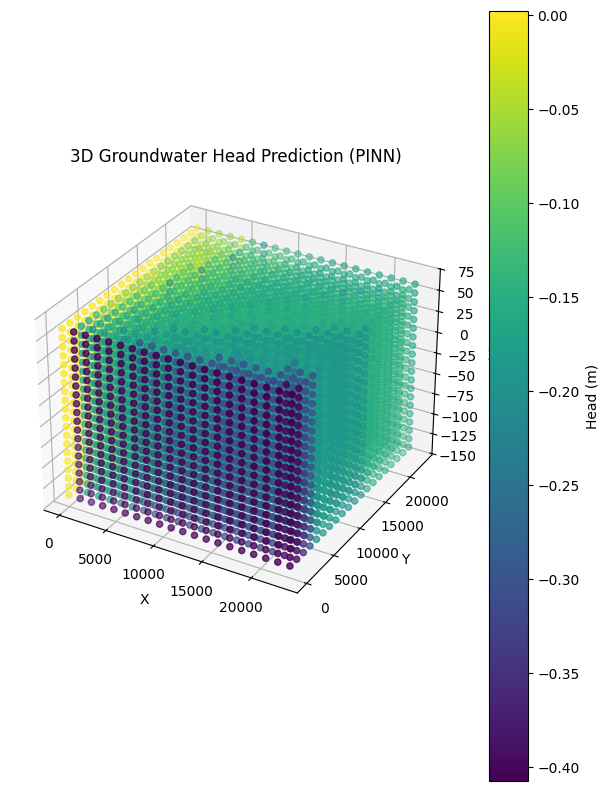

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 8310: Loss = 2.6964e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

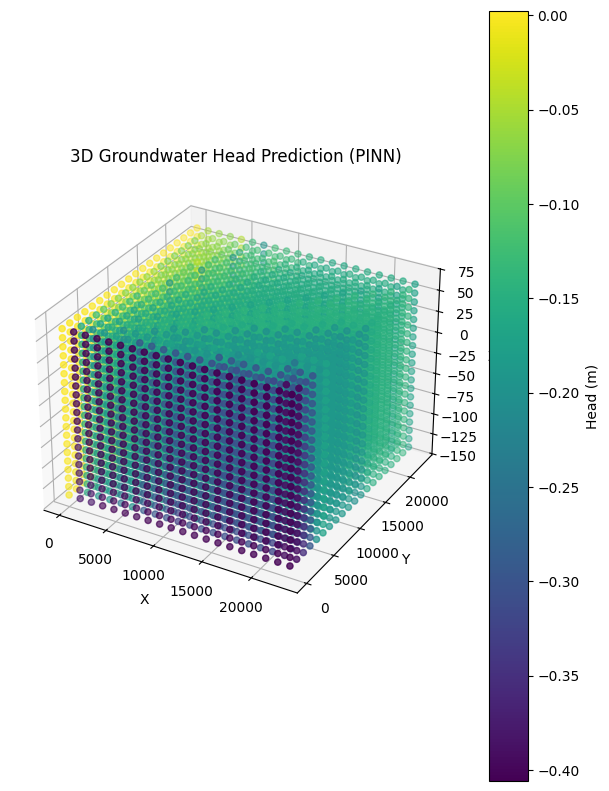

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 8410: Loss = 2.6383e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

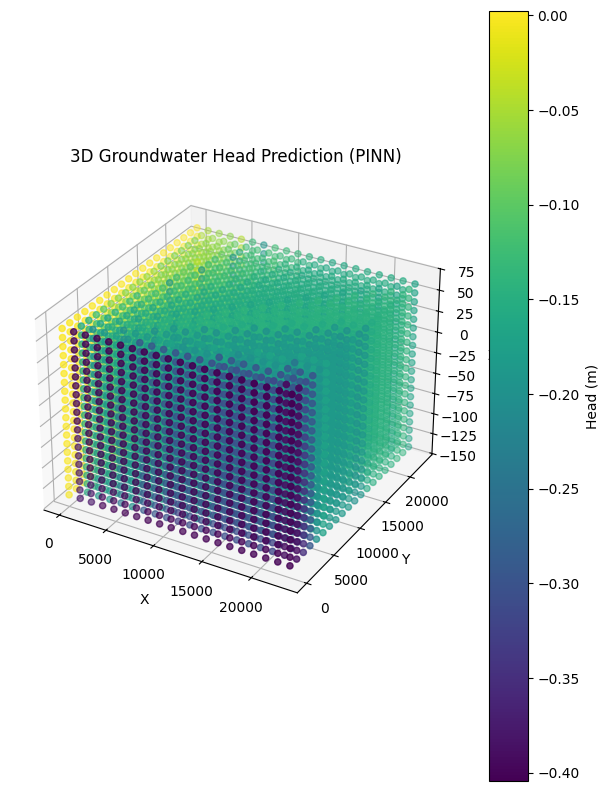

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 8510: Loss = 2.5908e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

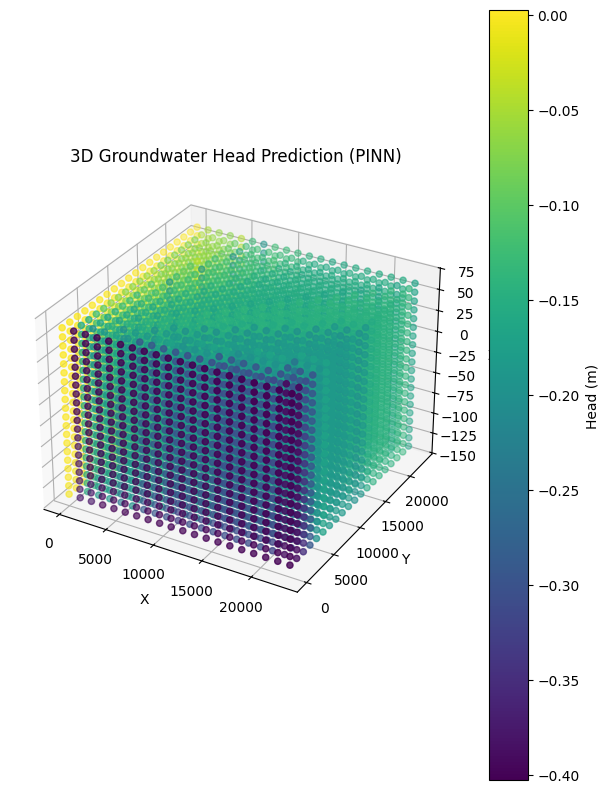

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 8610: Loss = 2.5489e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

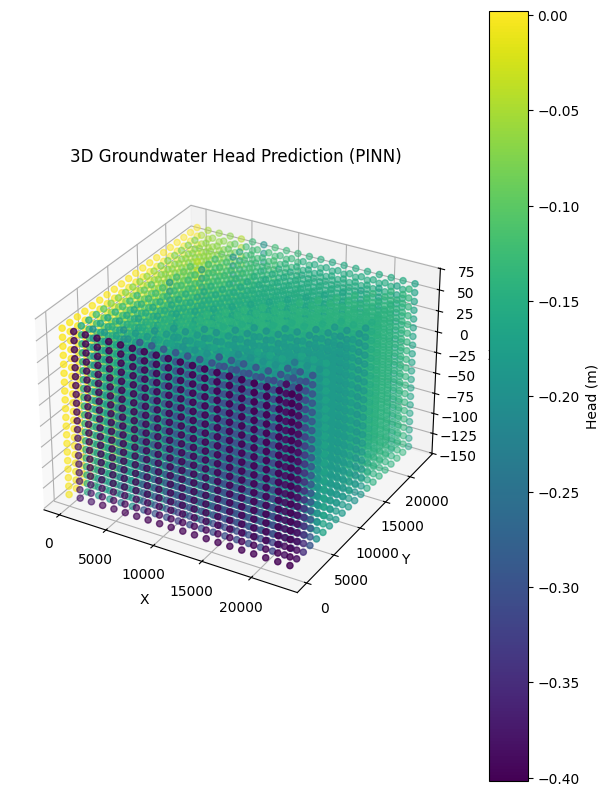

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 8710: Loss = 2.5094e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

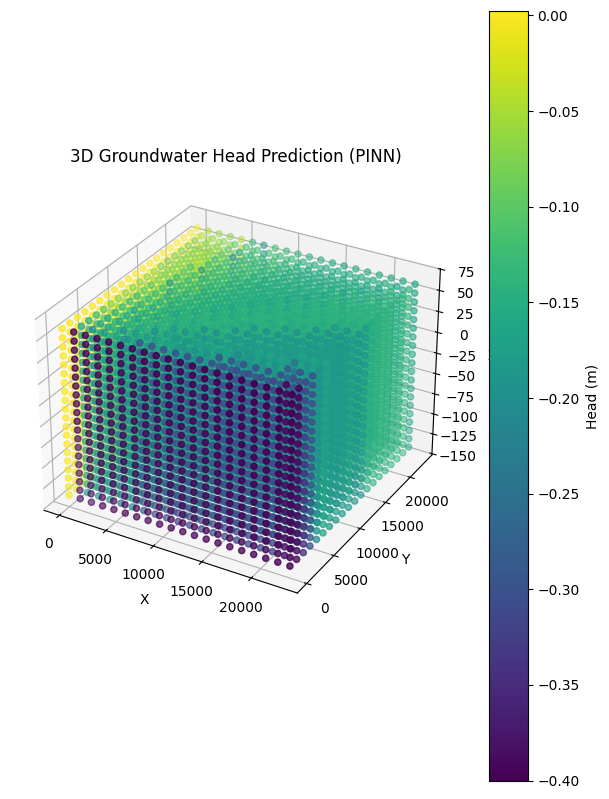

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 8810: Loss = 2.4718e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

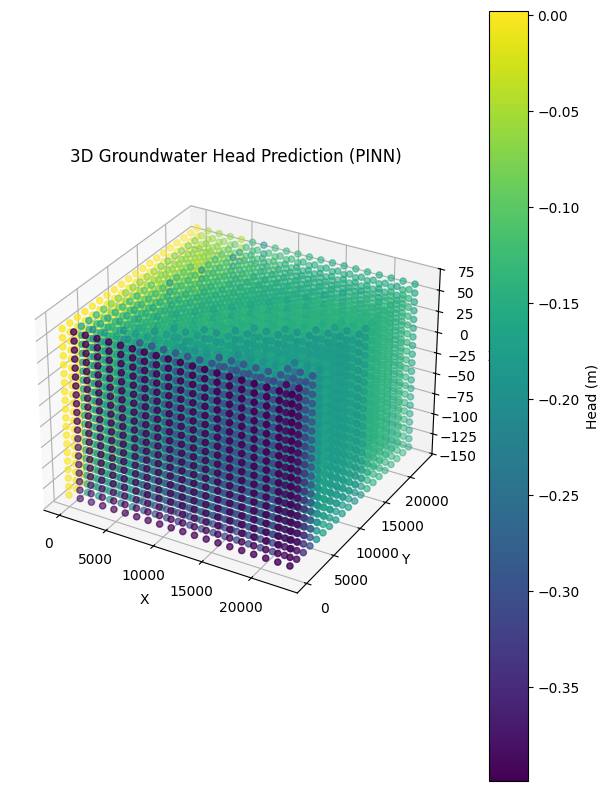

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 8910: Loss = 2.4360e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

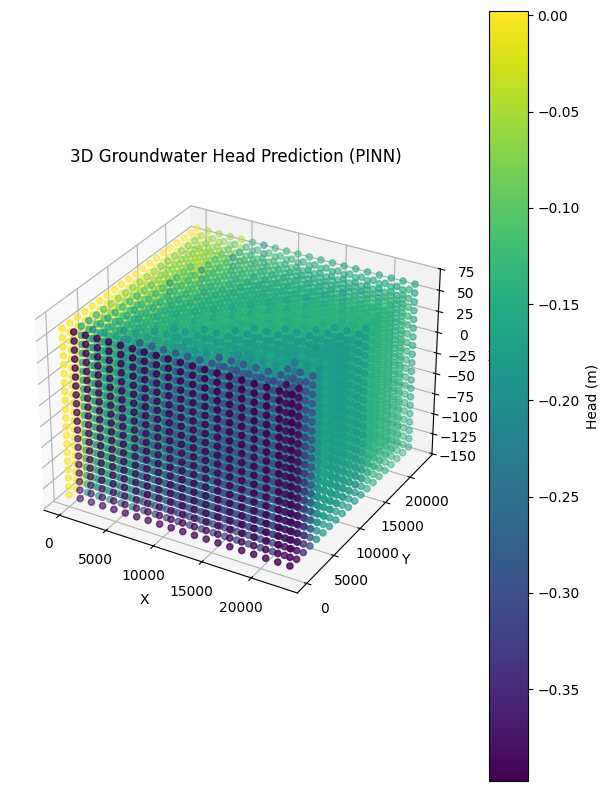

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 9010: Loss = 2.4020e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

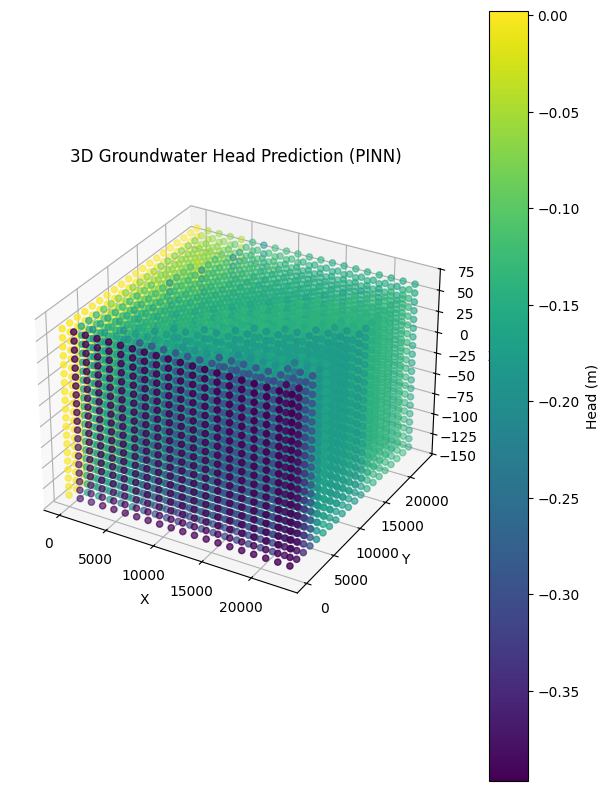

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 9110: Loss = 2.3695e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

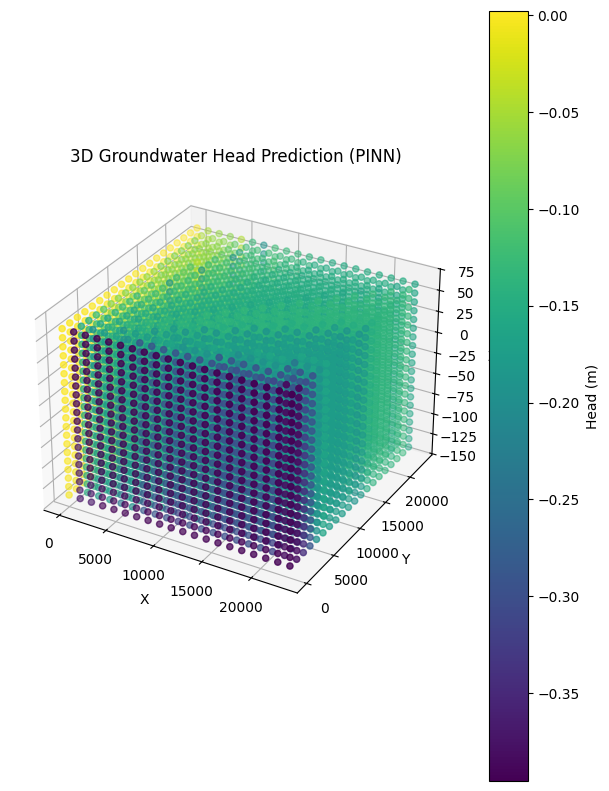

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 9210: Loss = 2.3384e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

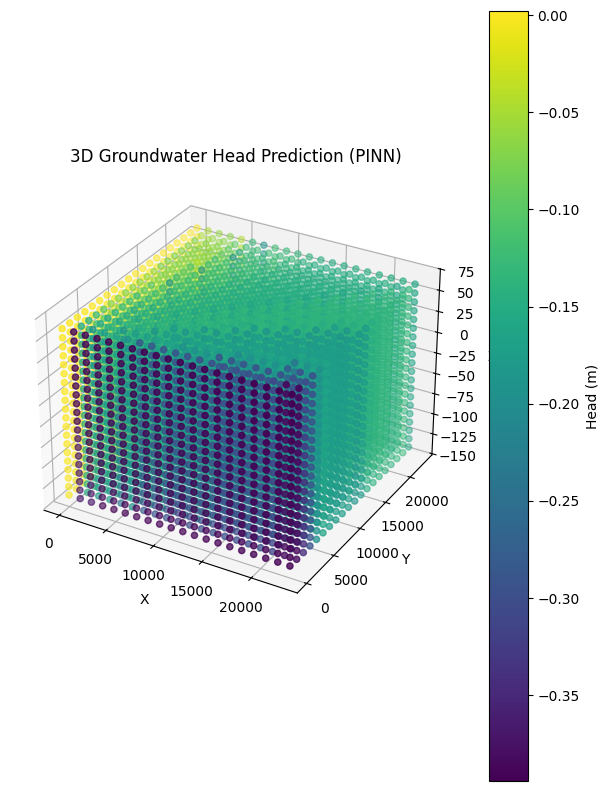

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 9310: Loss = 2.3084e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

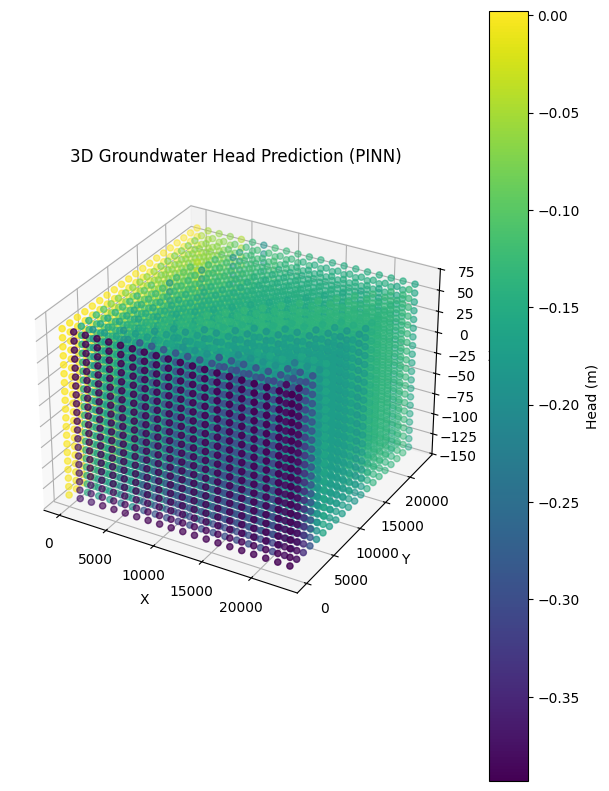

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 9410: Loss = 2.2794e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

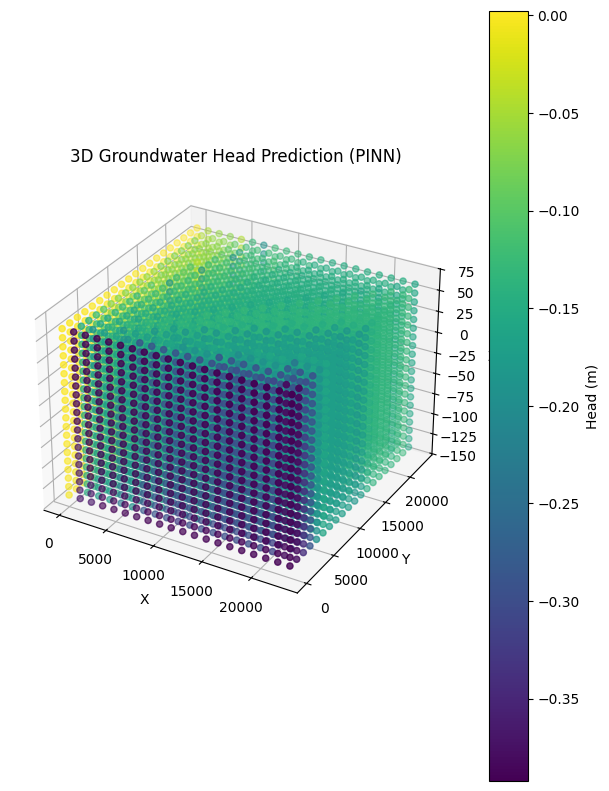

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 9510: Loss = 2.2512e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

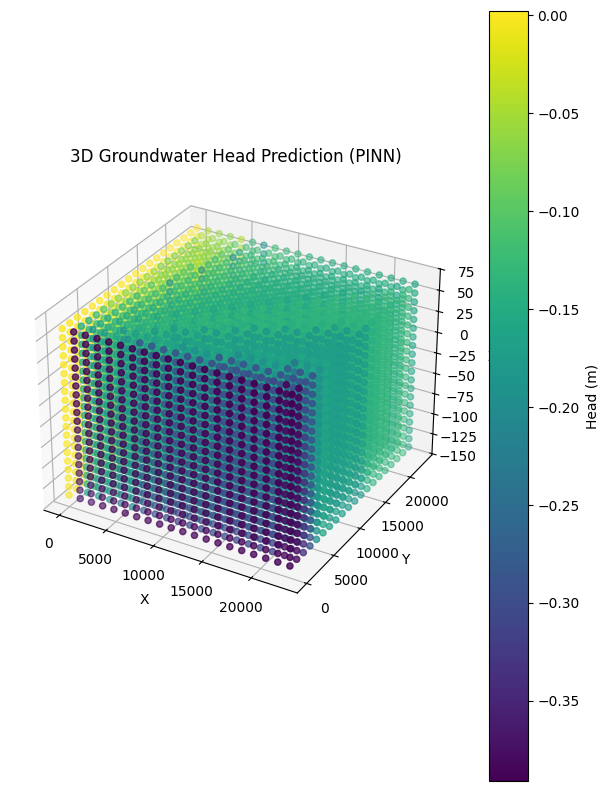

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 9610: Loss = 2.2236e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

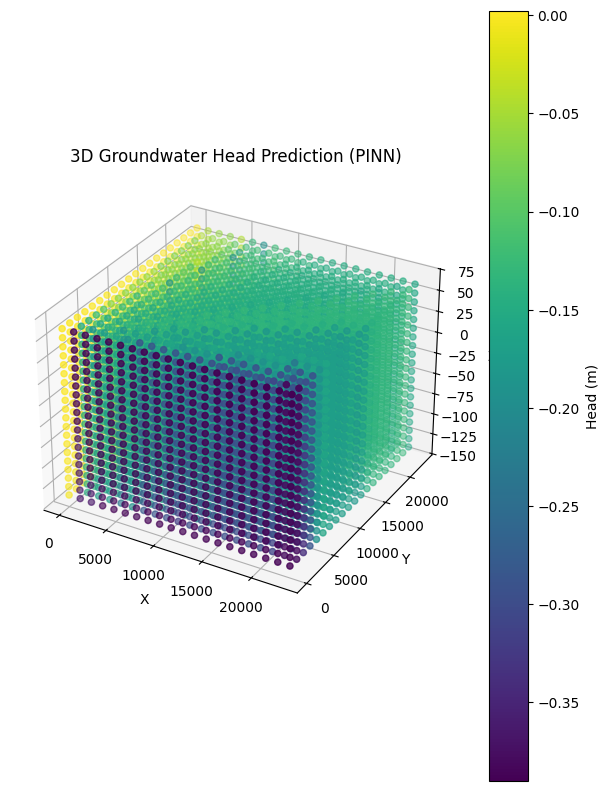

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 9710: Loss = 2.1964e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

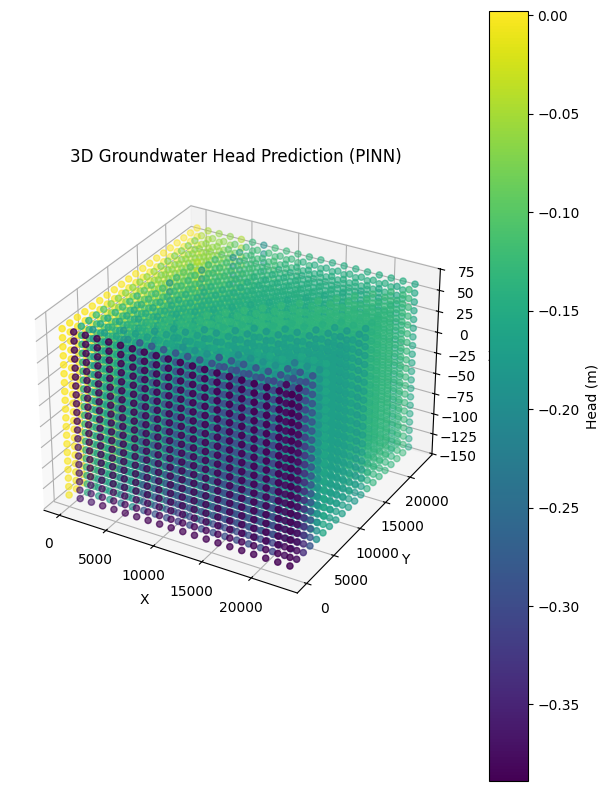

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 9810: Loss = 2.1693e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

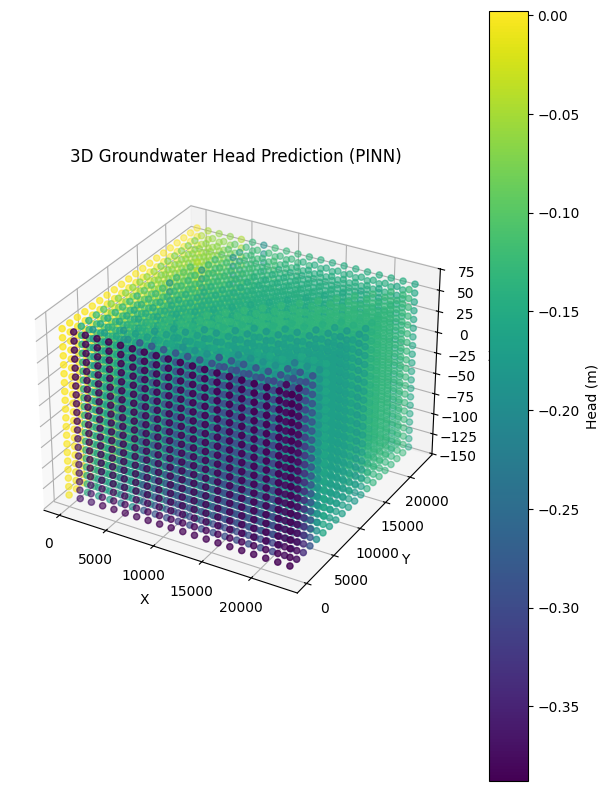

✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
Epoch 9910: Loss = 2.1391e-07
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params.pkl
✅ Parameters saved at /content/drive/MyDrive/best_param

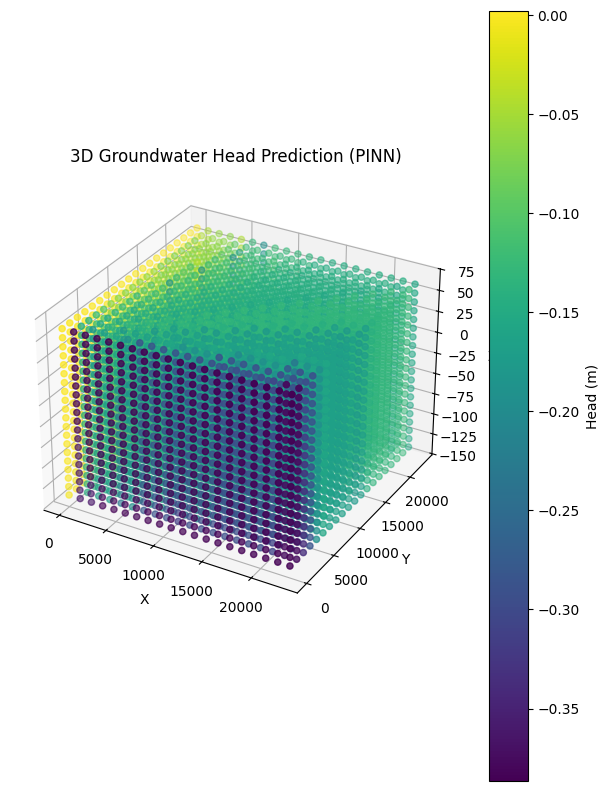


Best Model:
Best loss: 2.1135e-07 at iteration 10000



In [31]:
# Training PINN
n_hl = 6  # Number of hidden layers
n_nodes = 50  # Number of nodes per layer
# lr = 5E-2  # Learning rate
epoch = 10000  # Number of epochs

layers = [3, 100, 200, 100, 1]  # Neural network architecture

(x_const, y_const, z_const, bc_const, BC_const,
    x_re, y_re, z_re,bc_re, BC_re,
    x_dr, y_dr, z_dr, q_dr, BC_dr,
    x_nf_xmin, y_nf_xmin, z_nf_xmin, bc_nf_xmin, BC_nf_xmin,
    x_nf_xmax, y_nf_xmax, z_nf_xmax, bc_nf_xmax, BC_nf_xmax,
    x_nf_ymin, y_nf_ymin, z_nf_ymin, bc_nf_ymin, BC_nf_ymin,
    x_nf_ymax, y_nf_ymax, z_nf_ymax, bc_nf_ymax, BC_nf_ymax,
    x_nf_zmin, y_nf_zmin, z_nf_zmin, bc_nf_zmin, BC_nf_zmin,
    x_c, y_c, z_c, colloc, conds) = generate_BCs_and_colloc(N_b, N_r, xmin, xmax, ymin, ymax, zmin, zmax)

# Initialize neural network
key = random.PRNGKey(1234)
params = init_mlp(layers, key)

# Initialize optimizer
# scheduler = optax.cosine_decay_schedule(init_value=1E-2, decay_steps=epoch, alpha=0.1)
scheduler = optax.cosine_decay_schedule(init_value=1E-3, decay_steps=epoch, alpha=0.05)
optimizer = optax.adam(scheduler)
opt_state = optimizer.init(params)
# colloc_h_init = jax.random.uniform(random.PRNGKey(0), shape=(colloc.shape[0], 1), minval=1, maxval=10)  # 초기 압력값을 랜덤하게 설정
colloc_h_init = jnp.zeros((colloc.shape[0],1))
def save_params(params, path):
    with open(path, 'wb') as f:
        pickle.dump(params, f)
    print(f"✅ Parameters saved at {path}")

def load_params(path):
    with open(path, 'rb') as f:
        params = pickle.load(f)
    print(f"✅ Parameters loaded from {path}")
    return params

save_path = '/content/drive/MyDrive/best_params.pkl'

@jit
def update(params, opt_state, colloc, conds, colloc_h_init):
    """
    Perform one optimization step.
    """
    value, grads = jax.value_and_grad(loss_func)(params, colloc, conds, colloc_h_init)

    updates, opt_state = optimizer.update(grads, opt_state)
    params = optax.apply_updates(params, updates)
    return value, params, opt_state


# Training loop
all_losses = []
all_epochs = []
min_loss = jnp.inf
best_params = None

for i in range(epoch + 1):
    loss, params, opt_state = update(params, opt_state, colloc, conds, colloc_h_init)
    all_losses.append(loss)

    all_epochs.append(i)
    if loss < min_loss:
        min_loss = loss
        best_params = params
        best_iteration = i
        save_params(best_params, save_path)

      # 100 epoch마다 현재 params backup 저장
    if i % 100 == 0 and i != 0:
        save_params(params, f'/content/drive/MyDrive/backup_params_epoch_{i}.pkl')
        # 10 epoch마다 loss 출력
    if i % 10 == 0:
        print(f"Epoch {i}: Loss = {loss:.4e}")
    if i % 100 == 0:
        print(f"Epoch {i}: Loss = {loss:.4e}")
        # Predict head using the trained neural network
        h_pinn = neural_net(best_params, xyz_points )  # Output will be (nx*ny*nz, 1)
        h_pinn = h_pinn.reshape(nx, ny, nz)  # Reshape back to grid

        # 3D Visualization of PINN Solution
        fig = plt.figure(figsize=(16, 10))
        ax = fig.add_subplot(121, projection='3d')
        scat = ax.scatter(X, Y, Z, c=h_pinn.ravel(), cmap='viridis')
        plt.colorbar(scat, ax=ax, label='Head (m)')
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        ax.set_title('3D Groundwater Head Prediction (PINN)')

        plt.show()

print(f"\nBest Model:")
print(f"Best loss: {min_loss:.4e} at iteration {best_iteration}\n")

In [35]:
load_params(content/drive/MyDrive/best_params.pkl)

NameError: name 'content' is not defined

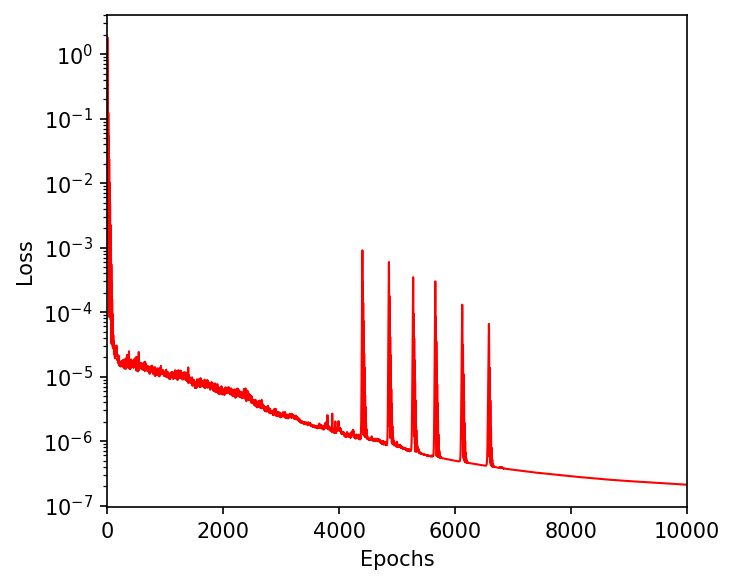

In [36]:
def plot_pinn_training(all_losses, all_epochs):
    plt.figure(figsize = (5, 4), dpi = 150)
    plt.semilogy(all_epochs, all_losses, '-r', markersize = 4, linewidth = 1.0)
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    #plt.legend(prop={"size": fontsize_legend}, loc="best")
    plt.xlim(min(all_epochs), max(all_epochs))
    plt.tight_layout()

plot_pinn_training(all_losses, all_epochs)

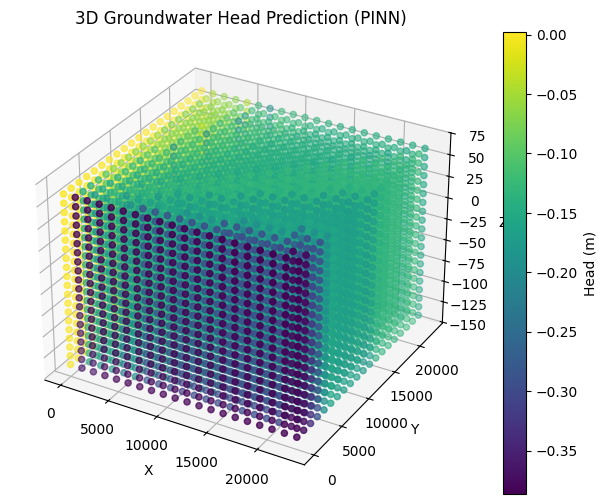

In [34]:
# 3D Visualization of PINN Solution
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
scat = ax.scatter(X, Y, Z, c=h_pinn.ravel(), cmap='viridis')
plt.colorbar(scat, ax=ax, label='Head (m)')
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('3D Groundwater Head Prediction (PINN)')

plt.show()
